## ✅ Resumen de cambios implementados en la notebook

### 1. Visualización de la curva de pérdida (train y validación)
Se implementó una gráfica para monitorear la pérdida de entrenamiento y validación por época, lo cual permite identificar overfitting o underfitting en el modelo BRITS.

---

### 2. División en datos de entrenamiento y validación con validación artificial
Los datos originales se dividen en:
- `x_train`: 80% de los datos
- `x_val`: 20% restantes

Además, en `x_val` se ocultan aleatoriamente un porcentaje de valores **observados** (por ejemplo, 10%) usando `val_mask_ratio`. Esto permite evaluar la capacidad del modelo para imputar valores que sí existen pero que no le fueron mostrados durante la validación, generando una pérdida (`val_loss`) más realista.

---

### 3. Implementación de Early Stopping
Se introdujo early stopping durante el entrenamiento con `patience=5`, deteniendo el proceso cuando no mejora la pérdida de validación. Esto previene sobreentrenamiento y reduce el tiempo computacional.

---

### 4. Regularización en el modelo BRITS
Se añadió:
- **L2 Regularization** a capas densas
- **Dropout** en las salidas de los modelos forward y backward

Ambos se activan opcionalmente a través de los parámetros:
- `use_regularization`
- `dropout_rate`

---

### 5. Grid Search automático
Se automatizó la búsqueda de hiperparámetros con combinaciones de:
- Número de unidades RNN
- Longitud de subsecuencias
- Tasa de aprendizaje
- Tamaño de batch
- Uso de regularización
- Porcentaje de dropout

Cada combinación se evalúa con:
- La pérdida de validación final
- El número de variables que pasan la prueba de equivalencia estadística TOST

---

### 6. Prueba TOST con umbrales relativos
Se reemplazó el umbral fijo `[-0.2, 0.2]` por umbrales relativos al **rango de cada variable**, como:

Esto permite una comparación justa entre variables con distintas escalas.

---

### 7. Resumen por variable
Se genera una tabla final con:
- Medias observadas e imputadas
- P-valores TOST
- Evaluación de equivalencia bajo distintos umbrales relativos
- MAE por variable
- Visualización KDE si la variable cumple equivalencia

---

### 8. Visualización final de resultados del grid search
Se agregó un gráfico 3D interactivo con Plotly para explorar el desempeño del modelo según los hiperparámetros, destacando las combinaciones más efectivas.

---


In [1]:
import pandas as pd
import numpy as np
import tensorflow as tf
import sklearn
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
from plotly.subplots import make_subplots

print(f"TensorFlow Version: {tf.__version__}")
print(f"NumPy Version: {np.__version__}")
print(f"sklearn Version: {sklearn.__version__}")

TensorFlow Version: 2.18.0
NumPy Version: 2.0.2
sklearn Version: 1.6.1


In [2]:
# Contenido de modules.py
import tensorflow as tf

class FeatureRegression(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(FeatureRegression, self).__init__(**kwargs)
        # No definimos self.d_constant aquí, se creará como un peso en build

    def build(self, input_shape):
        num_features = int(input_shape[-1])
        self.w = self.add_weight(
            name='w_fr',
            shape=[num_features, num_features],
            initializer="glorot_uniform",
            trainable=True) # Asegurar que los pesos principales sean entrenables
        self.b = self.add_weight(
            name='b_fr',
            shape=[num_features],
            initializer="zeros",
            trainable=True)

        # Definir d_constant como un peso no entrenable
        # Su valor se calcula una vez por el inicializador.
        def d_initializer_fn(shape, dtype=None):
            if dtype is None:
                dtype = tf.float32
            # shape[0] aquí será num_features
            return tf.ones(shape, dtype=dtype) - tf.eye(shape[0], dtype=dtype)

        self.d_constant_weight = self.add_weight(
            name='d_constant_fr',
            shape=[num_features, num_features],
            initializer=d_initializer_fn,
            trainable=False) # ¡Importante! Este peso no se entrena.
        super(FeatureRegression, self).build(input_shape)

    def call(self, inputs):
        # Usamos el peso self.d_constant_weight
        return tf.matmul(inputs, self.w * self.d_constant_weight) + self.b


class TemporalDecay(tf.keras.layers.Layer):
    def __init__(self, units, **kwargs):
        super(TemporalDecay, self).__init__(**kwargs)
        self.units = units

    def build(self, input_shape):
        self.w = self.add_weight(name='w_td', shape=[int(input_shape[-1]), self.units], initializer="glorot_uniform")
        self.b = self.add_weight(name='b_td', shape=[self.units], initializer="zeros")
        super(TemporalDecay, self).build(input_shape)

    def call(self, inputs):
        return tf.exp(-tf.nn.relu(tf.matmul(inputs, self.w) + self.b))


class RITS(tf.keras.layers.Layer):
    """
    Versión de la capa RITS modificada para usar celdas GRU y un tf.while_loop
    para compatibilidad con la construcción del modelo funcional de Keras.
    """
    def __init__(self, units, **kwargs):
        super(RITS, self).__init__(**kwargs)
        self.units = units
        self.rnn_cell = None
        self.temp_decay = None
        self.hist_reg = None
        self.feat_reg = None
        self.weight_combine = None

    def build(self, input_shape):
        num_features = input_shape[2] # (batch, timesteps, features, 3)

        ### Se usa GRUCell en lugar de LSTMCell ###
        if self.rnn_cell is None:
            self.rnn_cell = tf.keras.layers.GRUCell(units=self.units, name="gru_cell_rits")

        # El decaimiento temporal debe tener 'units' para poder decaer el estado 'h' de la GRU.
        if self.temp_decay is None:
            self.temp_decay = TemporalDecay(units=self.units, name="temporal_decay_rits")
        if self.hist_reg is None:
            self.hist_reg = tf.keras.layers.Dense(units=num_features, name="hist_reg_dense_rits")
        if self.feat_reg is None:
            self.feat_reg = FeatureRegression(name="feature_regression_rits")
        if self.weight_combine is None:
            self.weight_combine = tf.keras.layers.Dense(units=num_features, activation='sigmoid', name="weight_combine_dense_rits")

        super(RITS, self).build(input_shape)

    def call(self, inputs, training=None):
        # Extraer las diferentes partes de la entrada
        values = tf.cast(inputs[:, :, :, 0], dtype=tf.float32)
        masks = tf.cast(inputs[:, :, :, 1], dtype=tf.float32)
        deltas = tf.cast(inputs[:, :, :, 2], dtype=tf.float32)

        # Manejar dimensiones estáticas (durante la construcción) y dinámicas (durante la ejecución)
        batch_size_static = inputs.shape[0]   # Puede ser None durante la construcción
        timesteps_static = inputs.shape[1]    # Puede ser None
        features_static = inputs.shape[2]   # Debería ser un entero

        batch_size_dynamic = tf.shape(inputs)[0]
        timesteps_for_loop = tf.shape(inputs)[1]

        # Inicializar el TensorArray para almacenar las salidas de cada paso de tiempo
        outputs_ta = tf.TensorArray(
            dtype=tf.float32,
            size=timesteps_for_loop, # Usar el tensor dinámico
            dynamic_size=False,
            element_shape=tf.TensorShape([batch_size_static, features_static])
        )

        # Estados iniciales para el bucle
        initial_h_gru = tf.zeros(shape=(batch_size_dynamic, self.units), dtype=tf.float32)
        # GRU no tiene estado 'c', por lo que no se necesita initial_c
        initial_loss = tf.constant(0.0, dtype=tf.float32)
        initial_t = tf.constant(0, dtype=tf.int32)

        # Condición para detener el bucle
        def loop_condition(t, h_gru, current_loss, ta):
            return tf.less(t, timesteps_for_loop)

        # Cuerpo del bucle
        def loop_body(t, h_gru_prev, current_loss, ta):
            # Extraer datos del paso de tiempo 't'
            x_t, m_t, d_t = values[:, t, :], masks[:, t, :], deltas[:, t, :]

            # 1. Estimación histórica y decaimiento temporal
            x_h = self.hist_reg(h_gru_prev)
            gamma_decay = self.temp_decay(d_t)
            h_gru_decayed = h_gru_prev * gamma_decay

            # 2. Regresión de características y ponderación
            z_h = self.feat_reg(m_t * x_t + (1.0 - m_t) * x_h)
            beta_input = tf.concat([gamma_decay, m_t], axis=-1)
            beta = self.weight_combine(beta_input)

            # 3. Estimación y pérdida combinadas
            c_h = beta * z_h + (1.0 - beta) * x_h
            sum_m_t = tf.reduce_sum(m_t) + 1e-5
            loss_t = (tf.reduce_sum(tf.abs(x_t - x_h) * m_t) / sum_m_t +
                      tf.reduce_sum(tf.abs(x_t - z_h) * m_t) / sum_m_t +
                      tf.reduce_sum(tf.abs(x_t - c_h) * m_t) / sum_m_t)
            updated_loss = current_loss + loss_t

            # 4. Imputación final y actualización del TensorArray
            c_c_imputed = m_t * x_t + (1.0 - m_t) * c_h
            updated_ta = ta.write(index=t, value=c_c_imputed)

            # 5. Actualización del estado de la GRU
            rnn_input = tf.concat([c_c_imputed, m_t], axis=-1)
            # La llamada a la celda GRU y la actualización del estado son diferentes a LSTM
            _, [new_h_gru] = self.rnn_cell(inputs=rnn_input, states=[h_gru_decayed])

            # Devolver los estados actualizados para el siguiente paso del bucle
            return tf.add(t, 1), new_h_gru, updated_loss, updated_ta

        # Ejecutar el bucle
        _, final_h, final_loss, final_outputs_ta = tf.while_loop(
            cond=loop_condition,
            body=loop_body,
            loop_vars=[initial_t, initial_h_gru, initial_loss, outputs_ta]
        )

        # Recolectar las salidas y transponerlas a la forma correcta
        outputs_stacked = final_outputs_ta.stack()
        outputs_transposed = tf.transpose(outputs_stacked, [1, 0, 2])

        # Normalizar la pérdida
        avg_loss = final_loss / tf.maximum(1.0, (3.0 * tf.cast(timesteps_for_loop, tf.float32)))

        return outputs_transposed, avg_loss



print("Celda 2 (modules.py)")

Celda 2 (modules.py)


In [3]:
# Contenido de utils.py


def get_inputs(x_input_np): # Renombrado el argumento para claridad
    '''
    Derive the masking vectors and calculate the time gaps.
    See Section 3 of the BRITS paper.

    Parameters:
    __________________________________
    x_input_np: np.array.
        Time series, array with shape (samples, features) where samples is the length of the time series
        and features is the number of time series. Expected to have np.nan for missing.

    Returns:
    __________________________________
    inputs: tf.Tensor.
        Model inputs, tensor with shape (samples, features, 3) where 3 is the number of model inputs
        (time series, masking vectors and time gaps).
    '''
    # Derive the masking vector.
    m = np.where(np.isnan(x_input_np), 0, 1).astype(np.float32) # Convertir a float aquí

    # Calculate the time gaps.
    d = np.zeros_like(x_input_np, dtype=np.float32) # Iniciar como float
    for t in range(1, x_input_np.shape[0]):
        d[t, :] = np.where(m[t - 1, :] == 0, d[t - 1, :] + 1, 1)

    # Standardize the time gaps.
    # Asegurarse de que std no sea cero y manejar el caso de que toda una columna sea constante o NaN
    d_mean = np.nanmean(d, axis=0) # Usar nanmean si d puede tener NaNs (no debería por cómo se calcula)
    d_std = np.nanstd(d, axis=0)
    d_std[d_std == 0] = 1e-5 # Evitar división por cero si std es 0
    d = (d - d_mean) / (d_std + 1e-5) # Añadir epsilon también en denominador

    # Mask the inputs (replace NaNs with 0 for model input, mask m carries info)
    x_processed = np.where(m == 0, 0, x_input_np).astype(np.float32)

    # Cast the inputs to float tensors and expand dims.
    x_tf = tf.expand_dims(tf.cast(x_processed, tf.float32), axis=-1)
    m_tf = tf.expand_dims(tf.cast(m, tf.float32), axis=-1)
    d_tf = tf.expand_dims(tf.cast(d, tf.float32), axis=-1)

    # Concatenate the inputs.
    inputs_concat = tf.concat([x_tf, m_tf, d_tf], axis=-1)

    return inputs_concat

print("Celda 3 (utils.py) ")

Celda 3 (utils.py) 


In [ ]:
# Contenido de model.py
import tensorflow as tf
import numpy as np


class BRITS:
    def __init__(self, x, units, timesteps):
        if not isinstance(x, np.ndarray):
            raise ValueError("Input x to BRITS constructor must be a NumPy array.")
        if x.ndim != 2:
            raise ValueError(f"Input x must be 2D (samples, features), got {x.ndim}D.")

        self.x_original_for_scaling = x
        self.x_min = np.nanmin(x, axis=0)
        self.x_max = np.nanmax(x, axis=0)
        self.x_scale_range = self.x_max - self.x_min
        # Evitar división por cero si una columna es constante
        self.x_scale_range[self.x_scale_range == 0] = 1.0

        self.samples_total_original = x.shape[0] # Longitud total de la serie original
        self.features = x.shape[1]
        self.units = units
        self.timesteps_subsequence = timesteps # Longitud de las sub-secuencias
        self.keras_model = None

    def _prepare_input_data_for_keras(self, x_data_to_process, apply_padding=False):
        # 1. Escalar la serie temporal
        x_scaled = (x_data_to_process - self.x_min) / self.x_scale_range

        # 2. Obtener entradas para forward y backward (values, masks, deltas)
        forward_inputs_vmd = get_inputs(x_scaled)
        x_scaled_flipped = np.flip(x_scaled, axis=0)
        backward_inputs_vmd = get_inputs(x_scaled_flipped)

        combined_inputs_for_timeseries_dataset = tf.concat([forward_inputs_vmd, backward_inputs_vmd], axis=-1)

        num_padding_steps = 0
        if apply_padding:
            # Calcular padding necesario para que la longitud sea múltiplo de timesteps_subsequence
            remainder = combined_inputs_for_timeseries_dataset.shape[0] % self.timesteps_subsequence
            if remainder != 0:
                num_padding_steps = self.timesteps_subsequence - remainder
                # Crear padding replicando la última fila de combined_inputs_for_timeseries_dataset
                # El padding debe tener forma (num_padding_steps, features, 6)
                last_step_data = combined_inputs_for_timeseries_dataset[-1:, :, :] # (1, features, 6)
                padding_data = tf.repeat(last_step_data, repeats=num_padding_steps, axis=0)
                combined_inputs_for_timeseries_dataset = tf.concat([combined_inputs_for_timeseries_dataset, padding_data], axis=0)

        return combined_inputs_for_timeseries_dataset, num_padding_steps

    # Metodo actualizado fit() ahora recibe split data: train y val
    # Método actualizado para BRITS.fit con early stopping
    # Método actualizado para BRITS.fit con early stopping y build_fn con Dropout y L2
    def fit(self, learning_rate=0.001, batch_size_subsequences=32, epochs=100,
            x_val=None, val_mask_ratio=0.1, early_stopping=False, patience=5, verbose=True):
        self.loss_history = []
        self.val_loss_history = []

        processed_data_train, _ = self._prepare_input_data_for_keras(self.x_original_for_scaling, apply_padding=False)
        train_dataset = tf.keras.utils.timeseries_dataset_from_array(
            data=processed_data_train,
            targets=None,
            sequence_length=self.timesteps_subsequence,
            sequence_stride=self.timesteps_subsequence,
            batch_size=batch_size_subsequences,
            shuffle=True
        )

        if self.keras_model is None:
            self.keras_model = build_fn(
                timesteps=self.timesteps_subsequence,
                features=self.features,
                units=self.units
            )

        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

        @tf.function
        def train_step(data_batch):
            with tf.GradientTape() as tape:
                _, loss = self.keras_model(data_batch, training=True)
                if self.keras_model.losses:
                    loss += tf.add_n(self.keras_model.losses)  # incluir regularización L2
            grads = tape.gradient(loss, self.keras_model.trainable_variables)
            optimizer.apply_gradients(zip(grads, self.keras_model.trainable_variables))
            return loss

        @tf.function
        def val_step(data_batch):
            _, loss = self.keras_model(data_batch, training=False)
            if self.keras_model.losses:
                loss += tf.add_n(self.keras_model.losses)
            return loss

        if x_val is not None:
            x_val_masked = x_val.copy()
            mask_nan = np.isnan(x_val_masked)
            val_mask = (np.random.rand(*x_val.shape) < val_mask_ratio) & (~mask_nan)
            x_val_masked[val_mask] = np.nan
            processed_data_val, _ = self._prepare_input_data_for_keras(x_val_masked, apply_padding=False)
            val_dataset = tf.keras.utils.timeseries_dataset_from_array(
                data=processed_data_val,
                targets=None,
                sequence_length=self.timesteps_subsequence,
                sequence_stride=self.timesteps_subsequence,
                batch_size=batch_size_subsequences,
                shuffle=False
            )
        else:
            val_dataset = None

        best_val_loss = float('inf')
        wait = 0

        for epoch in range(epochs):
            train_loss_avg = tf.keras.metrics.Mean()
            for batch in train_dataset:
                loss = train_step(batch)
                train_loss_avg.update_state(loss)
            self.loss_history.append(train_loss_avg.result().numpy())

            if val_dataset:
                val_loss_avg = tf.keras.metrics.Mean()
                for batch in val_dataset:
                    val_loss = val_step(batch)
                    val_loss_avg.update_state(val_loss)
                val_loss_value = val_loss_avg.result().numpy()
                self.val_loss_history.append(val_loss_value)

                if verbose:
                    print(f"Epoch {epoch+1}/{epochs} - Train Loss: {train_loss_avg.result():.6f} - Val Loss: {val_loss_value:.6f}")

                if early_stopping:
                    if val_loss_value < best_val_loss - 1e-4:
                        best_val_loss = val_loss_value
                        wait = 0
                    else:
                        wait += 1
                        if wait >= patience:
                            if verbose:
                                print(f"Early stopping triggered at epoch {epoch+1}")
                            break
            else:
                if verbose:
                    print(f"Epoch {epoch+1}/{epochs} - Train Loss: {train_loss_avg.result():.6f}")
# Modificación sugerida para build_fn() (fuera de esta clase):
# Agregar regularización L2 y capas Dropout:
#   tf.keras.layers.LSTMCell(..., kernel_regularizer=tf.keras.regularizers.l2(1e-4))
#   tf.keras.layers.Dropout(0.3)(...)  ← después de capas Dense o LSTM si se desea


#método impute debe estar dentrod de clase BRITS, la puse dentro
    def impute(self, x_to_impute_np):
            if self.keras_model is None:
                raise ValueError("Model has not been trained yet. Call fit() first.")
            if x_to_impute_np.shape[1] != self.features:
                raise ValueError(f'Expected {self.features} features, found {x_to_impute_np.shape[1]}.')

            original_length = x_to_impute_np.shape[0]

            # Preparar los datos con padding para asegurar que se procesa toda la serie
            processed_data_for_keras_impute, num_padding_steps = self._prepare_input_data_for_keras(
                x_to_impute_np, apply_padding=True
            )

            dataset_impute = tf.keras.utils.timeseries_dataset_from_array(
                data=processed_data_for_keras_impute,
                targets=None,
                sequence_length=self.timesteps_subsequence,
                sequence_stride=self.timesteps_subsequence,
                batch_size=32,
                shuffle=False
            )

            all_imputed_subsequences = []
            for data_batch_subsequences in dataset_impute:
                imputed_subsequences_batch, _ = self.keras_model(data_batch_subsequences, training=False)
                all_imputed_subsequences.append(imputed_subsequences_batch.numpy())

            if not all_imputed_subsequences:
                return np.zeros_like(x_to_impute_np)

            imputed_scaled_padded_concatenated = np.concatenate(all_imputed_subsequences, axis=0)
            num_total_steps_processed_padded = imputed_scaled_padded_concatenated.shape[0] * imputed_scaled_padded_concatenated.shape[1]
            imputed_scaled_padded_flat = imputed_scaled_padded_concatenated.reshape(num_total_steps_processed_padded, self.features)

            imputed_scaled_trimmed = imputed_scaled_padded_flat[:original_length, :]
            imputed_original_scale = self.x_min + imputed_scaled_trimmed * self.x_scale_range

            return imputed_original_scale



# build_fn actualizado con parámetro dropout_rate externo
def build_fn(timesteps, features, units, use_regularization=False, dropout_rate=0.3):
    reg = tf.keras.regularizers.l2(1e-4) if use_regularization else None

    inputs = tf.keras.layers.Input(shape=(timesteps, features, 6), name="brits_main_input")
    forward_input_vmd = inputs[:, :, :, :3]
    backward_input_vmd = inputs[:, :, :, 3:]

    rits_forward_layer = RITS(units=units, name="rits_forward")
    rits_backward_layer = RITS(units=units, name="rits_backward")

    forward_imputations, forward_loss = rits_forward_layer(forward_input_vmd)
    backward_imputations, backward_loss = rits_backward_layer(backward_input_vmd)

    if use_regularization:
        forward_imputations = tf.keras.layers.Dropout(dropout_rate)(forward_imputations)
        backward_imputations = tf.keras.layers.Dropout(dropout_rate)(backward_imputations)

    backward_imputations_reversed = tf.keras.layers.Lambda(
        lambda x_tensor: tf.reverse(x_tensor, axis=[1]), name="reverse_backward_imputations"
    )(backward_imputations)

    outputs_avg = (forward_imputations + backward_imputations_reversed) / 2.0
    final_outputs = tf.keras.layers.Lambda(lambda x_tensor: x_tensor, name="final_imputations")(outputs_avg)

    abs_diff_consistency = tf.keras.layers.Lambda(
        lambda tensors_list: tf.abs(tensors_list[0] - tensors_list[1]), name="abs_difference_consistency"
    )([forward_imputations, backward_imputations_reversed])

    consistency_loss_val = tf.keras.layers.Lambda(
        lambda x_tensor: tf.reduce_mean(x_tensor), name="consistency_loss_calc"
    )(abs_diff_consistency)

    total_loss_tensor = forward_loss + backward_loss + consistency_loss_val
    total_loss_output = tf.keras.layers.Lambda(lambda x_tensor: x_tensor, name="total_loss_output")(total_loss_tensor)

    final_model_outputs_tuple = (final_outputs, total_loss_output)
    final_keras_model = tf.keras.Model(inputs=inputs, outputs=final_model_outputs_tuple, name="brits_functional_model")

    return final_keras_model


In [5]:
# Contenido de plot.py

def plot(actual, imputed):
    '''
    Plot the actual and imputed the time series.

    Parameters:
    __________________________________
    actual: np.array.
        Actual time series (puede contener NaNs).
    imputed: np.array.
        Imputed time series (no debería contener NaNs).
    '''
    if actual.shape[1] != imputed.shape[1]:
        raise ValueError(f'Expected {actual.shape[1]} features, found {imputed.shape[1]}.')

    num_features = actual.shape[1]

    # Crear títulos para los subplots
    subplot_titles = []
    for i in range(num_features):
        subplot_titles.append(f'Feature {i+1} (Actual con NaNs)')
        subplot_titles.append(f'Feature {i+1} (Imputada)')

    fig = make_subplots(
        rows=num_features * 2, # Dos filas por característica (actual e imputada)
        cols=1,
        subplot_titles=subplot_titles,
        vertical_spacing=0.03 # Ajustar espaciado vertical si es necesario
    )

    current_row = 1
    for i in range(num_features):
        # Serie actual (puede tener gaps donde hay NaN)
        fig.add_trace(
            go.Scatter(
                y=actual[:, i],
                mode='lines',
                name=f'Feature {i+1} Actual',
                line=dict(color='grey', width=1),
                connectgaps=False # No conectar sobre los NaNs
            ),
            row=current_row, col=1
        )
        current_row += 1

        # Serie imputada
        fig.add_trace(
            go.Scatter(
                y=imputed[:, i],
                mode='lines',
                name=f'Feature {i+1} Imputada',
                line=dict(color='blue', width=1)
            ),
            row=current_row, col=1
        )
        current_row += 1

    fig.update_layout(
        height=300 * num_features * 2, # Ajustar altura dinámicamente
        showlegend=False,
        title_text="Comparación de Series Temporales: Actual vs. Imputada",
        plot_bgcolor='white',
        paper_bgcolor='white',
        margin=dict(t=60, b=60, l=30, r=30),
         font=dict(color='#1b1f24',size=8)
    )
    fig.update_xaxes(showgrid=False, zeroline=False, linecolor='#eaeef2', mirror=True, tickfont=dict(color='#6e7781',size=6))
    fig.update_yaxes(showgrid=False, zeroline=False, linecolor='#eaeef2', mirror=True, tickfont=dict(color='#6e7781',size=6))

    return fig

print("Celda 5 (plot.py) ")

Celda 5 (plot.py) 


In [29]:
# Método actualizado para BRITS.fit con early stopping y build_fn con Dropout y L2
# + visualización de combinaciones evaluadas por regularización y dropout

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import itertools
import json
import plotly.express as px
from statsmodels.stats.weightstats import ttost_ind
from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance
from sklearn.metrics import mean_squared_error, mean_absolute_error
from IPython.display import display
from scipy.stats import t

class ConfigurableBRITS:
    def __init__(self, x, units, timesteps, use_regularization=True, dropout_rate=0.3):
        #from model import BRITS, build_fn  # asegúrate de que el módulo model.py esté en tu ruta
        self.model = BRITS(
            x=x,
            units=units,
            timesteps=timesteps
        )
        self.model.keras_model = build_fn(
            timesteps=timesteps,
            features=x.shape[1],
            units=units,
            use_regularization=use_regularization,
            dropout_rate=dropout_rate
        )

    def fit(self, *args, **kwargs):
        # Aplicar configuración de grid search: 10 épocas y early stopping con paciencia baja
        kwargs.setdefault('epochs', 10) #confurable #epocas en cada
        kwargs.setdefault('early_stopping', True)
        kwargs.setdefault('patience', 1) #confurable la paciencia
        return self.model.fit(*args, **kwargs)

    def impute(self, *args, **kwargs):
        return self.model.impute(*args, **kwargs)

    @property
    def val_loss_history(self):
        return getattr(self.model, 'val_loss_history', None)

    @property
    def loss_history(self):
        return getattr(self.model, 'loss_history', None)

def visualizar_resultados_grid(resultados_grid):
    """
    Visualiza solo gráfico final 3D de configuraciones destacadas tras el grid search.
    """
    df = pd.DataFrame([
        {
            'units': r['config'].get('unidades_rnn'),
            'timesteps': r['config'].get('longitud_sub_secuencia'),
            'lr': r['config'].get('tasa_aprendizaje'),
            'batch': r['config'].get('tamaño_lote'),
            'use_regularization': r['config'].get('use_regularization'),
            'dropout_rate': r['config'].get('dropout_rate'),
            'val_loss': r.get('val_loss'),
            'n_equivalentes': r.get('n_equivalentes')
        }
        for r in resultados_grid
    ])

    # Gráfico de burbujas 3D para visualizar configuraciones destacadas
    fig = px.scatter_3d(
        df, x='units', y='timesteps', z='val_loss',
        color='n_equivalentes', size='n_equivalentes',
        symbol='use_regularization',
        hover_data=['lr', 'batch', 'dropout_rate']
        # Se ha eliminado el título de la gráfica.
    )
    fig.show()


def resumen_tost_kde_mae(df_original, df_imputado, porcentajes=[0.05, 0.1, 0.2]):
    """
    Función modificada para generar una tabla con cabeceras en inglés y una
    única figura con subgráficos de KDE para las variables equivalentes.
    """
    resumen = []
    conteo_equivalencias = {p: 0 for p in porcentajes}
    variables_equivalentes = []

    common_cols = df_original.select_dtypes(include=np.number).columns.intersection(
                      df_imputado.select_dtypes(include=np.number).columns)

    for col in common_cols:
        obs_aligned = df_original[col].values.astype(np.float64)
        mask = np.isfinite(obs_aligned)
        obs_clean = obs_aligned[mask]
        imp_clean = df_imputado[col].values.astype(np.float64)[mask]

        if len(obs_clean) < 5: continue

        mae = mean_absolute_error(obs_clean, imp_clean)
        rmse = np.sqrt(mean_squared_error(obs_clean, imp_clean))

        rango = np.nanmax(obs_clean) - np.nanmin(obs_clean)
        if rango == 0 or np.isnan(rango): continue

        umbrales_equivalentes = []
        is_equivalent_found = False
        for p in porcentajes:
            limite = p * rango
            tost = ttost_ind(obs_clean, imp_clean, -limite, limite, usevar='unequal')
            p1, p2 = tost[1][1], tost[2][1]
            if (p1 < 0.05) and (p2 < 0.05):
                umbrales_equivalentes.append(round(p, 3))
                conteo_equivalencias[p] += 1
                is_equivalent_found = True

        if is_equivalent_found:
            variables_equivalentes.append(col)

        # Cabeceras de la tabla en inglés
        resumen.append({
            "Variable": col,
            "Observed Mean": np.mean(obs_clean),
            "Imputed Mean": np.mean(imp_clean),
            "MAE": mae,
            "RMSE": rmse,
            "Equivalent in % Range": umbrales_equivalentes if umbrales_equivalentes else "No",
        })

    df_resumen = pd.DataFrame(resumen)
    print("\n--- Summary Table (TOST, MAE, RMSE) ---")
    display(df_resumen)

    if variables_equivalentes:
        n_vars = len(variables_equivalentes)
        n_cols = 2
        n_rows = (n_vars + n_cols - 1) // n_cols

        fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, n_rows * 4))
        if n_vars == 1: axes = np.array([axes])
        axes = axes.flatten()

        for i, col_name in enumerate(variables_equivalentes):
            ax = axes[i]
            obs = df_original[col_name].dropna()
            imp = df_imputado[col_name]
            # Etiquetas de leyenda y ejes en inglés
            sns.kdeplot(obs, label='Observed', fill=True, ax=ax, color='grey')
            sns.kdeplot(imp, label='Imputed', fill=True, ax=ax, color='orange')
            ax.set_xlabel(f"Value ({col_name.replace('Value_', '')})")
            ax.set_ylabel("Density")
            ax.legend()
            ax.grid(False) # Se quita la cuadrícula
            # Etiqueta de subfigura (a), (b), ... en la esquina inferior izquierda
            ax.text(0.03, 0.03, f'({chr(97 + i)})', transform=ax.transAxes,
                      fontsize=10, va='bottom')

        for j in range(i + 1, len(axes)):
            axes[j].axis('off')

        plt.tight_layout()
        plt.show()

    return df_resumen

def analisis_distribucion_tost(df_original_con_nan, df_imputado_completo, cols_contaminantes, cols_meteorologicas, umbral_relativo=0.05):
    """
    Función modificada para generar una única figura consolidada con los subgráficos
    de KDE para todas las variables.
    """
    print(f"\n--- Full Distribution Analysis ---")

    resumen_distribucion = []

    # --- CAMBIO: Combinar todas las columnas en una sola lista ---
    all_columns = cols_contaminantes + cols_meteorologicas

    n_vars = len(all_columns)
    if n_vars == 0:
        print("No se proporcionaron columnas para graficar.")
        return

    # --- CAMBIO: Configurar la cuadrícula para todas las variables ---
    n_cols = 3 # Se usan 4 columnas para un layout más compacto
    n_rows = (n_vars + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 3.5))
    axes = axes.flatten()

    # --- CAMBIO: Un solo bucle para graficar todo ---
    for i, col in enumerate(all_columns):
        ax = axes[i]
        if col not in df_original_con_nan.columns or col not in df_imputado_completo.columns: continue

        obs_dist = df_original_con_nan[col].dropna().astype(np.float64)
        imp_dist = df_imputado_completo[col].astype(np.float64)

        if len(obs_dist) < 5 or len(imp_dist) < 5: continue

        sns.kdeplot(obs_dist, label=f'Original {len(obs_dist)} samples', fill=True, color='grey', ax=ax)
        sns.kdeplot(imp_dist, label=f'Imputed {len(imp_dist)} samples', fill=True, color='orange', ax=ax)

        ax.set_xlabel(col.replace('Value_', ''))
        ax.set_ylabel("Density")
        ax.legend()
        ax.text(0.03, 0.03, f'({chr(97 + i)})', transform=ax.transAxes,
                  fontsize=10, va='bottom')
        ax.grid(False)

    # Ocultar los ejes de los subplots que no se usen
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

    # El cálculo de la tabla de resumen se mantiene igual, pero ahora itera sobre `all_columns`
    for col in all_columns:
        if col not in df_original_con_nan.columns or col not in df_imputado_completo.columns: continue
        obs_dist = df_original_con_nan[col].dropna().astype(np.float64)
        imp_dist = df_imputado_completo[col].astype(np.float64)
        if len(obs_dist) < 5 or len(imp_dist) < 5: continue
        rango = np.nanmax(obs_dist) - np.nanmin(obs_dist)
        if rango == 0 or np.isnan(rango): rango = 1e-8
        limite_tost = umbral_relativo * rango
        tost_result = ttost_ind(obs_dist, imp_dist, -limite_tost, limite_tost, usevar='unequal')
        equivalencia_tost = (tost_result[1][1] < 0.05) and (tost_result[2][1] < 0.05)
        ks_statistic, p_value_ks = ks_2samp(obs_dist, imp_dist)
        distribucion_diferente_ks = p_value_ks < 0.05
        w_distance = wasserstein_distance(obs_dist, imp_dist)
        w_distance_relativa = (w_distance / rango) * 100

        resumen_distribucion.append({
            "Variable": col,
            "Original Mean": f"{np.mean(obs_dist):.4f}",
            "Imputed Mean": f"{np.mean(imp_dist):.4f}",
            "Equivalent (TOST)": equivalencia_tost,
            "Different (K-S)": distribucion_diferente_ks,
            "W-Dist Relative (%)": f"{w_distance_relativa:.2f}%"
        })

    if resumen_distribucion:
        df_resumen = pd.DataFrame(resumen_distribucion)
        print("\n--- Summary Table: Distribution Analysis ---")
        display(df_resumen.sort_values(by="W-Dist Relative (%)", key=lambda col: col.str.replace('%','').astype(float)))

    return df_resumen

def analisis_completo_con_tost_detallado(df_original_con_nan, df_imputado_completo, umbral_relativo=0.05):
    """
    Realiza un análisis completo de distribución, calculando la prueba TOST
    manualmente paso a paso para máxima transparencia.
    El texto de la tabla está en inglés.
    """

    print(f"\n--- Análisis Completo (TOST Manual, Límite: {umbral_relativo*100:.0f}%) ---")

    resumen_completo = []
    columnas_numericas = df_imputado_completo.select_dtypes(include=np.number).columns

    for col in columnas_numericas:
        if col not in df_original_con_nan.columns:
            continue

        obs_dist = df_original_con_nan[col].dropna().astype(np.float64)
        imp_dist = df_imputado_completo[col].astype(np.float64)

        if len(obs_dist) < 5 or len(imp_dist) < 5:
            continue

        # --- INICIO DEL CÁLCULO MANUAL DE TOST ---

        # 1. Calcular estadísticas básicas
        n1, n2 = len(obs_dist), len(imp_dist)
        media1, media2 = np.mean(obs_dist), np.mean(imp_dist)
        var1, var2 = np.var(obs_dist, ddof=1), np.var(imp_dist, ddof=1)

        # 2. Calcular la Diferencia de Medias
        diferencia_medias = media1 - media2

        # 3. Calcular el Error Estándar de la Diferencia (para varianzas desiguales)
        error_estandar_diff = np.sqrt((var1 / n1) + (var2 / n2))

        # 4. Definir el Límite de Equivalencia
        rango = np.nanmax(obs_dist) - np.nanmin(obs_dist)
        if rango == 0 or np.isnan(rango): rango = 1e-8
        limite = umbral_relativo * rango
        limite_inferior, limite_superior = -limite, limite

        # 5. Calcular los Estadísticos t para cada límite
        t_stat_low = (diferencia_medias - limite_inferior) / error_estandar_diff
        t_stat_high = (diferencia_medias - limite_superior) / error_estandar_diff

        # 6. Calcular los Grados de Libertad (fórmula de Welch-Satterthwaite)
        df_num = ((var1 / n1) + (var2 / n2))**2
        df_den = ((var1 / n1)**2 / (n1 - 1)) + ((var2 / n2)**2 / (n2 - 1))
        grados_libertad = df_num / df_den

        # 7. Calcular los P-Valores usando la distribución t
        p_val_low = t.sf(t_stat_low, df=grados_libertad)  # Prueba de cola derecha
        p_val_high = t.cdf(t_stat_high, df=grados_libertad) # Prueba de cola izquierda

        equivalencia_tost = (p_val_low < 0.05) and (p_val_high < 0.05)

        # --- FIN DEL CÁLCULO MANUAL DE TOST ---

        # Calcular otras métricas (K-S y Wasserstein)
        ks_statistic, p_value_ks = ks_2samp(obs_dist, imp_dist)
        distribucion_diferente_ks = p_value_ks < 0.05
        w_distance = wasserstein_distance(obs_dist, imp_dist)
        w_distance_relativa = (w_distance / rango) * 100



        # Guardar todos los valores en el resumen
        resumen_completo.append({
            "Variable": col,
            "Original Mean": media1,
            "Imputed Mean": media2,
            "Mean Difference": diferencia_medias,
            "TOST Bound ±": limite,
            "p-value (Lower)": p_val_low,
            "p-value (Upper)": p_val_high,
            "Equivalent (TOST)": equivalencia_tost,
            "Different (K-S)": distribucion_diferente_ks,
            "W-Dist Relative (%)": w_distance_relativa
        })

    if resumen_completo:
        df_resumen = pd.DataFrame(resumen_completo)
        print("\n--- Summary Table: Full Analysis (Manual TOST) ---")

        format_dict = {
            "Original Mean": "{:.6f}",
            "Imputed Mean": "{:.6f}",
            "Mean Difference": "{:.6f}",
            "TOST Bound ±": "{:.6f}",
            "p-value (Lower)": "{:.3e}",
            "p-value (Upper)": "{:.3e}",
            "W-Dist Relative (%)": "{:.2f}%"
        }

        display(df_resumen.style.format(format_dict).hide(axis="index"))

        df_resumen.to_csv("analisis_completo_imputacion_manual_tost.csv", index=False)
        print("\nResultados guardados en 'analisis_completo_imputacion_manual_tost.csv'")

    return df_resumen




# Carga de datos

In [8]:
import numpy as np
import pandas as pd

# Carga de datos desde un archivo CSV
df_unido2 = pd.read_csv('df/datos_unidos2.csv')


#--------------------- ESTACIONES A USAR ------------------------------
df_nez = df_unido2[df_unido2['id_station']== 'NEZ'].copy()
df_uax = df_unido2[df_unido2['id_station']== 'UAX'].copy()
df_mer = df_unido2[df_unido2['id_station']== 'MER'].copy()
df_tla = df_unido2[df_unido2['id_station']== 'TLA'].copy()
df_fac= df_unido2[df_unido2['id_station']== 'FAC'].copy()
df_ped =df_unido2[df_unido2['id_station']== 'PED'].copy()
df_sag =df_unido2[df_unido2['id_station']== 'SAG'].copy()

df_cua= df_unido2[df_unido2['id_station']== 'CUA'].copy()
df_mgh =df_unido2[df_unido2['id_station']== 'MGH'].copy()
df_vif =df_unido2[df_unido2['id_station']== 'VIF'].copy()


#-------------------- Estaciones para agregar ------------------------

df_sfe = df_unido2[df_unido2['id_station']== 'SFE'].copy()
df_ajm = df_unido2[df_unido2['id_station']== 'AJM'].copy()
df_xal = df_unido2[df_unido2['id_station']== 'XAL'].copy()



# Borra contaminantes de  las estaciones 

In [9]:
df_fac.drop(columns=["Value_PM25", "Value_PMCO"], inplace=True)
df_nez.drop(columns=["Value_PM10", "Value_PMCO"], inplace=True)
df_uax.drop(columns=["Value_PM10", "Value_PMCO"], inplace=True)
df_cua.drop(columns=["Value_PM25", "Value_PMCO"], inplace=True)
df_mgh.drop(columns=["Value_PM10", "Value_PM25", "Value_PMCO"], inplace=True)
df_vif.drop(columns=["Value_PM25", "Value_PMCO"], inplace=True)



# Busqueda de parametros BRITS

In [10]:
#BUSQUEDA PARAMETROS "GRID SEARCH"

from scipy.stats import wasserstein_distance
import numpy as np
import pandas as pd
import itertools
import json
from statsmodels.stats.weightstats import ttost_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error

# --------------------------------------------------------------------------
# 1. Función de Ayuda para Entrenar y Evaluar
#    Ahora usa la lógica de validación con huecos artificiales y datos escalados.
# --------------------------------------------------------------------------
def entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val_original, scaler):
    """
    Función de ayuda que entrena un modelo BRITS y lo evalúa con un método
    de validación robusto, devolviendo el MAE y RMSE promedio de la imputación.
    """
    print(f"  Entrenando con: {config}")

    # Asumiendo que la clase ConfigurableBRITS está disponible en el entorno
    modelo = ConfigurableBRITS(
        x=x_train_scaled, # Entrenar con datos escalados
        units=config['unidades_rnn'],
        timesteps=config['longitud_sub_secuencia'],
        use_regularization=config['use_regularization'],
        dropout_rate=config['dropout_rate']
    )

    # El x_val para la pérdida interna también debe estar escalado
    x_val_scaled = scaler.transform(x_val_original)

    modelo.fit(
        learning_rate=config['tasa_aprendizaje'],
        batch_size_subsequences=config['tamaño_lote'],
        epochs=35,
        x_val=x_val_scaled, # Usar x_val escalado para la val_loss
        val_mask_ratio=0.1,
        early_stopping=True,
        patience=5,
        verbose=False
    )

    # --- Lógica de Validación con H  20% de huecos artificiales ---
    df_val = pd.DataFrame(x_val_original)
    df_val_truth = df_val.dropna()

    avg_mae = float('inf')
    avg_rmse = float('inf')

    if len(df_val_truth) > 20:
        df_val_holey = df_val_truth.copy()
        for col in df_val_holey.columns:
            hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False) #   <======PORCETANJE DE DATOS FALTANTES POR COLUMNA
            df_val_holey.loc[hole_indices, col] = np.nan

        
        df_val_holey_scaled = scaler.transform(df_val_holey)
        x_val_reimputed_scaled = modelo.impute(df_val_holey_scaled)
        x_val_reimputed_original_scale = scaler.inverse_transform(x_val_reimputed_scaled)
        df_val_reimputed = pd.DataFrame(x_val_reimputed_original_scale, index=df_val_truth.index, columns=df_val_truth.columns)

        # Calcular MAE y RMSE promedio en todas las columnas
        maes, rmses = [], []
        for col in df_val_truth.columns:
            maes.append(mean_absolute_error(df_val_truth[col], df_val_reimputed[col]))
            rmses.append(np.sqrt(mean_squared_error(df_val_truth[col], df_val_reimputed[col])))

        avg_mae = np.mean(maes)
        avg_rmse = np.mean(rmses)

    print(f"  Resultado: Avg MAE={avg_mae:.4f}, Avg RMSE={avg_rmse:.4f}")

    return avg_mae, avg_rmse


# --------------------------------------------------------------------------
# 2. Función Principal de Búsqueda de Parámetros
# --------------------------------------------------------------------------
def busqueda_parametros_grid_search(df_busqueda):
    """
    Realiza una búsqueda de hiperparámetros por etapas, usando el error de
    imputación (MAE/RMSE) en un conjunto de validación con huecos artificiales.
    """
    print("Iniciando preparación de datos para la búsqueda de parámetros...")
    df_original = df_busqueda.copy()
    if 'id_station' in df_original.columns:
        df_original.drop(columns=['id_station'], inplace=True)

    
    x = df_original.select_dtypes(include=np.number).values

    # División 80/20
    porcentaje_val = 0.2
    num_muestras = x.shape[0]
    num_val = int(num_muestras * porcentaje_val)
    x_train = x[:-num_val, :]
    x_val = x[-num_val:, :]
    print(f"Datos divididos: {x_train.shape[0]} para entrenamiento, {x_val.shape[0]} para validación.")

    # --- Escalado de Datos ---
    print("Escalando datos...")
    scaler = MinMaxScaler()
    x_train_scaled = scaler.fit_transform(x_train)
    # x_val se escalará dentro de la función de evaluación cuando sea necesario

    resultados_grid = []
    mejor_config_provisional = {}

    # ------------------------ Etapa 1: Arquitectura RNN --------------------------------------
    print("\n🚀 Etapa 1: Buscando mejores Unidades RNN y Timesteps...")
    etapa1_grid = {'unidades_rnn': [32,64,128 ,256, 512], 'longitud_sub_secuencia': [32,64, 128, 168]}
    fijos_etapa1 = {'tasa_aprendizaje': 0.005, 'tamaño_lote': 64, 'use_regularization': False, 'dropout_rate': 0.2}

    mejor_rmse1, mejor_mae1 = float('inf'), float('inf')

    for unidades_rnn, longitud_sub_secuencia in itertools.product(etapa1_grid['unidades_rnn'], etapa1_grid['longitud_sub_secuencia']):
        config = {**fijos_etapa1, 'unidades_rnn': unidades_rnn, 'longitud_sub_secuencia': longitud_sub_secuencia}
        avg_mae, avg_rmse = entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val, scaler)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse})

        if avg_rmse < mejor_rmse1 - 1e-6 or \
           (abs(avg_rmse - mejor_rmse1) < 1e-6 and avg_mae < mejor_mae1 - 1e-6):
            mejor_rmse1, mejor_mae1 = avg_rmse, avg_mae
            mejor_config_provisional.update(config)

    print(f"\n✅ Mejor config tras Etapa 1: {mejor_config_provisional}")

    # --------------------------------------Etapa 2: Entrenamiento --------------------------------------------------
    print("\n🚀 Etapa 2: Buscando mejores Learning Rate y Batch Size...")
    etapa2_grid = {'tasa_aprendizaje': [0.001, 0.005, 0.009], 'tamaño_lote': [32, 64, 128, 256]}
    fijos_etapa2 = {k: v for k, v in mejor_config_provisional.items() if k not in etapa2_grid}

    mejor_rmse2, mejor_mae2 = float('inf'), float('inf')

    for tasa_aprendizaje, tamaño_lote in itertools.product(etapa2_grid['tasa_aprendizaje'], etapa2_grid['tamaño_lote']):
        config = {**fijos_etapa2, 'tasa_aprendizaje': tasa_aprendizaje, 'tamaño_lote': tamaño_lote}
        avg_mae, avg_rmse = entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val, scaler)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse})

        if avg_rmse < mejor_rmse2 - 1e-6 or \
           (abs(avg_rmse - mejor_rmse2) < 1e-6 and avg_mae < mejor_mae2 - 1e-6):
            mejor_rmse2, mejor_mae2 = avg_rmse, avg_mae
            mejor_config_provisional.update(config)

    print(f"\n✅ Mejor config tras Etapa 2: {mejor_config_provisional}")

    # ----------------------------------- Etapa 3: Regularización -----------------------------------------------------------------
    print("\n🚀 Etapa 3: Buscando mejores opciones de Regularización y Dropout...")
    etapa3_grid = {'use_regularization': [True, False], 'dropout_rate': [0.1, 0.2, 0.3]}
    fijos_etapa3 = {k: v for k, v in mejor_config_provisional.items() if k not in etapa3_grid}

    mejor_rmse3, mejor_mae3 = float('inf'), float('inf')

    for use_regularization, dropout_rate in itertools.product(etapa3_grid['use_regularization'], etapa3_grid['dropout_rate']):
        config = {**fijos_etapa3, 'use_regularization': use_regularization, 'dropout_rate': dropout_rate}
        avg_mae, avg_rmse = entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val, scaler)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse})

        if avg_rmse < mejor_rmse3 - 1e-6 or \
           (abs(avg_rmse - mejor_rmse3) < 1e-6 and avg_mae < mejor_mae3 - 1e-6):
            mejor_rmse3, mejor_mae3 = avg_rmse, avg_mae
            mejor_config_provisional.update(config)

    mejor_config_final = mejor_config_provisional
    print("\n\n🟢 Mejor configuración final encontrada:")
    print(mejor_config_final)
    print(f"Con Avg RMSE: {mejor_rmse3:.4f} y Avg MAE: {mejor_mae3:.4f}")

    # Guardar resultados
    with open("mejor_config_brits.json", "w") as f:
        json.dump(mejor_config_final, f, indent=4)
    pd.DataFrame(resultados_grid).to_csv("resultados_grid_brits.csv", index=False)

    return mejor_config_final, resultados_grid


In [ ]:
# BUSQUEDA PARAMETROS "RANDOM SEARCH"
import random
import json
import pandas as pd
import numpy as np
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error

# --------------------------------------------------------------------------
# 1. Función para Entrenar y Evaluar
# --------------------------------------------------------------------------
def entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val_original, scaler):
    """
    Función de ayuda que entrena un modelo BRITS y lo evalúa.
    """
    print(f"  Entrenando con: {config}")

    # Asegúrate de que tu clase ConfigurableBRITS esté definida y disponible.
    modelo = ConfigurableBRITS(
        x=x_train_scaled,
        units=config['unidades_rnn'],
        timesteps=config['longitud_sub_secuencia'],
        use_regularization=config['use_regularization'],
        dropout_rate=config['dropout_rate']
    )

    x_val_scaled = scaler.transform(x_val_original)

    modelo.fit(
        learning_rate=config['tasa_aprendizaje'],
        batch_size_subsequences=config['tamaño_lote'],
        epochs=35,
        x_val=x_val_scaled,
        val_mask_ratio=0.1,
        early_stopping=True,
        patience=5,
        verbose=False
    )

    # --- Lógica de Validación con 20% de huecos artificiales ---
    
    df_val = pd.DataFrame(x_val_original)
    df_val_truth = df_val.dropna()

    avg_mae = float('inf')
    avg_rmse = float('inf')

    if len(df_val_truth) > 20:
        df_val_holey = df_val_truth.copy()
        for col in df_val_holey.columns:
            hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False)
            df_val_holey.loc[hole_indices, col] = np.nan

        df_val_holey_scaled = scaler.transform(df_val_holey)
        x_val_reimputed_scaled = modelo.impute(df_val_holey_scaled)
        x_val_reimputed_original_scale = scaler.inverse_transform(x_val_reimputed_scaled)
        df_val_reimputed = pd.DataFrame(x_val_reimputed_original_scale, index=df_val_truth.index, columns=df_val_truth.columns)

        maes, rmses = [], []
        for col in df_val_truth.columns:
            maes.append(mean_absolute_error(df_val_truth[col], df_val_reimputed[col]))
            rmses.append(np.sqrt(mean_squared_error(df_val_truth[col], df_val_reimputed[col])))

        avg_mae = np.mean(maes)
        avg_rmse = np.mean(rmses)

    print(f"  Resultado: Avg MAE={avg_mae:.4f}, Avg RMSE={avg_rmse:.4f}")
    return avg_mae, avg_rmse

# ----------------------------------------------------------------------------------
# BÚSQUEDA ALEATORIA CON ESPACIO DE BÚSQUEDA ORIGINAL
# ----------------------------------------------------------------------------------
def busqueda_brits_random_search(df_busqueda, n_iteraciones=35):
    """
    Realiza una búsqueda de hiperparámetros aleatoria utilizando un espacio de
    búsqueda con valores discretos predefinidos.

    Args:
        df_busqueda (pd.DataFrame): DataFrame con los datos para la búsqueda.
        n_iteraciones (int): Número total de combinaciones aleatorias a probar.
    """
    print("Iniciando preparación de datos para la búsqueda de parámetros...")
    df_original = df_busqueda.copy()
    if 'id_station' in df_original.columns:
        df_original.drop(columns=['id_station'], inplace=True)

    x = df_original.select_dtypes(include=np.number).values
    porcentaje_val = 0.2
    num_muestras = x.shape[0]
    num_val = int(num_muestras * porcentaje_val)
    x_train = x[:-num_val, :]
    x_val = x[-num_val:, :]
    print(f"Datos divididos: {x_train.shape[0]} para entrenamiento, {x_val.shape[0]} para validación.")

    print("Escalando datos...")
    scaler = MinMaxScaler()
    x_train_scaled = scaler.fit_transform(x_train)

    # --- ESPACIO DE BÚSQUEDA ORIGINAL (VALORES DISCRETOS) ---
    search_space = {
        'unidades_rnn': [64, 128, 256, 512],
        'longitud_sub_secuencia': [16, 32, 64, 128, 168],
        'tasa_aprendizaje': [0.001, 0.005, 0.009],
        'tamaño_lote': [16, 32, 64, 128, 168],
        'use_regularization': [False, True],
        'dropout_rate': [0.1, 0.2, 0.3]
    }

    resultados_busqueda = []
    mejor_config_final = None
    mejor_rmse = float('inf')
    mejor_mae = float('inf')

    print(f"\n🚀 Iniciando Búsqueda Aleatoria con {n_iteraciones} iteraciones...")

    for _ in tqdm(range(n_iteraciones), desc="Buscando mejor configuración"):
        # --- SELECCIÓN ALEATORIA DE VALORES DISCRETOS ---
        config = {
            'unidades_rnn': random.choice(search_space['unidades_rnn']),
            'longitud_sub_secuencia': random.choice(search_space['longitud_sub_secuencia']),
            'tamaño_lote': random.choice(search_space['tamaño_lote']),
            'use_regularization': random.choice(search_space['use_regularization']),
            'tasa_aprendizaje': random.choice(search_space['tasa_aprendizaje']),
        }

        # Lógica dependiente para el dropout
        config['dropout_rate'] = random.choice(search_space['dropout_rate'])


        # Llama a la función de evaluación
        avg_mae, avg_rmse = entrenar_y_evaluar_avanzado(config, x_train_scaled, x_val, scaler)
        
        resultados_busqueda.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse})

        if avg_rmse < mejor_rmse - 1e-6 or (abs(avg_rmse - mejor_rmse) < 1e-6 and avg_mae < mejor_mae - 1e-6):
            mejor_rmse = avg_rmse
            mejor_mae = avg_mae
            mejor_config_final = config
            print(f"\n🎉 Nueva mejor config encontrada: RMSE={mejor_rmse:.4f}, MAE={mejor_mae:.4f}")
            print(f"   Config: {json.dumps(mejor_config_final, indent=4)}")

    print("\n\n" + "="*50)
    print("🟢 BÚSQUEDA FINALIZADA: Mejor configuración global encontrada 🟢")
    print("="*50)
    if mejor_config_final:
        print(json.dumps(mejor_config_final, indent=4))
        print(f"\nCon Avg RMSE final: {mejor_rmse:.4f} y Avg MAE final: {mejor_mae:.4f}")
    else:
        print("No se encontró ninguna configuración válida durante la búsqueda.")

    with open("mejor_config_brits_random.json", "w") as f:
        json.dump(mejor_config_final, f, indent=4)
    pd.DataFrame(resultados_busqueda).to_csv("resultados_random_search_brits.csv", index=False)
    print("\nResultados guardados en 'mejor_config_brits_random.json' y 'resultados_random_search_brits.csv'")

    return mejor_config_final, pd.DataFrame(resultados_busqueda)

In [ ]:
#Funcion de Imputacion BRITS
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras import backend as K
from sklearn.preprocessing import MinMaxScaler
from statsmodels.stats.weightstats import ttost_ind
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from IPython.display import display
from scipy.stats import wasserstein_distance
import json 

# ==============================================================================
# ----------------------- FUNCIONES DE ANÁLISIS  -------------------------------
# ==============================================================================

def analisis_distribucion_kde(df_original, df_imputado, cols_a_graficar, *args):
    """
    Genera una única figura consolidada con los subgráficos de KDE para todas las variables.
    """
    print("\n--- Generando Gráficos de Densidad (KDE) ---")
    all_columns = cols_a_graficar
    n_vars = len(all_columns)
    if n_vars == 0: return

    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4), dpi=600)
    axes = axes.flatten()

    for i, col in enumerate(all_columns):
        ax = axes[i]
        if col not in df_original.columns or col not in df_imputado.columns: continue
            
        obs_dist = df_original[col].dropna().astype(np.float64)
        imp_dist = df_imputado[col].astype(np.float64)
        
        if len(obs_dist) < 5 or len(imp_dist) < 5: continue
        
        sns.kdeplot(obs_dist, label=f'Original ({len(obs_dist)} samples)', fill=True, color='grey', ax=ax)
        sns.kdeplot(imp_dist, label=f'Imputed ({len(imp_dist)} samples)', fill=True, color='orange', ax=ax)
        
        ax.set_xlabel(col.replace('Value_', ''))
        ax.set_ylabel("Density")
        
        ax.legend(loc='upper right', fontsize='small')
        
        ax.text(0.03, 0.03, f'({chr(97 + i)})', transform=ax.transAxes, fontsize=10, va='bottom')
        ax.grid(False)

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

def analisis_completo_con_tost_detallado(df_original, df_imputado, station_name, umbral_relativo=0.05):
    """
    Realiza un análisis completo de distribución y guarda los resultados en un CSV.
    """
    print(f"\n--- Análisis Completo de Distribución (Límite TOST: {umbral_relativo*100:.0f}%) ---")
    resumen_completo = []
    columnas_numericas = df_imputado.select_dtypes(include=np.number).columns

    for col in columnas_numericas:
        if col not in df_original.columns: continue
            
        obs_dist = df_original[col].dropna().astype(np.float64)
        imp_dist = df_imputado[col].astype(np.float64)
        
        if len(obs_dist) < 5 or len(imp_dist) < 5: continue
        
        obs_mean = np.mean(obs_dist)
        imp_mean = np.mean(imp_dist)
        mean_diff = obs_mean - imp_mean

        rango = np.nanmax(obs_dist) - np.nanmin(obs_dist)
        if rango == 0 or np.isnan(rango): rango = 1e-8
        limite = umbral_relativo * rango
        
        tost_result = ttost_ind(obs_dist, imp_dist, -limite, limite, usevar='unequal')
        p_val_low, p_val_high = tost_result[1][1], tost_result[2][1]
        equivalencia_tost = (p_val_low < 0.05) and (p_val_high < 0.05)
        
        w_distance = wasserstein_distance(obs_dist, imp_dist)
        w_distance_relativa = (w_distance / rango) * 100

        resumen_completo.append({
            "Variable": col,
            "Original Mean": obs_mean,
            "Imputed Mean": imp_mean,
            "Mean Difference": mean_diff,
            "TOST Limit ±": limite,
            "Equivalent (TOST)": equivalencia_tost,
            "W-Dist Relative (%)": w_distance_relativa
        })
        
    if resumen_completo:
        df_resumen = pd.DataFrame(resumen_completo)
        print("\n--- Summary Table: Distribution Analysis ---")
        display(df_resumen)
                                                                                            
        filename = f"analisis_distribucion_brits_random_{station_name}.csv"                         # Guarda mi tabla analisis de distribuccion. 
        df_resumen.to_csv(filename, index=False)
        print(f"Resultados del análisis de distribución guardados en '{filename}'")
        
        return df_resumen
    return pd.DataFrame()

# ==============================================================================
# ----------------------- FUNCIÓN DE IMPUTACIÓN PRINCIPAL ----------------------
# ==============================================================================

def imputacion (df_estacion, resultados_grid_param=None):

    K.clear_session()
    
    # Preparación de los datos
    df_original_completo = df_estacion.copy()
    
    station_name = df_estacion['id_station'].iloc[0] if 'id_station' in df_estacion.columns else 'unknown'
    
    non_numeric_cols = df_original_completo.select_dtypes(exclude=np.number)
    df_numeric = df_original_completo.select_dtypes(include=np.number)
    
    #  División 80/20 para Entrenamiento y Validación 
    val_size = int(len(df_numeric) * 0.2)
    df_train = df_numeric.iloc[:-val_size]
    df_val = df_numeric.iloc[-val_size:]
    print(f"\nDatos divididos: Entrenamiento={len(df_train)} filas, Validación={len(df_val)} filas.")

    # Escalado de datos 
    print("\nEscalando los datos...")
    scaler = MinMaxScaler()
    x_train_scaled = scaler.fit_transform(df_train)
    
    # ---  Entrenamiento del Modelo BRITS ---
    print("\nEntrenando el modelo BRITS con datos escalados...")
    
    # from brits_model import ConfigurableBRITS 
    brits_modelo_real = ConfigurableBRITS(
        x=x_train_scaled,
        units=512,
        timesteps=64,
        use_regularization=True,
        dropout_rate=0.1
    )
    
    x_val_scaled = scaler.transform(df_val)
    
    brits_modelo_real.fit(
        learning_rate=0.005,                                                                #====================================================================
        batch_size_subsequences=64,                                                         #
        epochs=50,                                                                          #               Ajuste de hiperparametros por Estacion 
        x_val=x_val_scaled,                                                                 #
        val_mask_ratio=0.1,                                                                 #====================================================================
        early_stopping=False,
        patience=5,
        verbose=True
    )
    print("Entrenamiento de BRITS finalizado.")

    #  Evaluación de imputación en el conjunto de validación ---
    print("\n--- Evaluación Detallada en el Conjunto de Validación ---")
    
    df_val_truth = df_val.dropna()
    
    if len(df_val_truth) < 20:
        print("Advertencia: No hay suficientes filas completas en el conjunto de validación para una evaluación fiable.")
    else:
        df_val_holey = df_val_truth.copy()
        
        mascara_huecos = pd.DataFrame(False, index=df_val_holey.index, columns=df_val_holey.columns)

        for col in df_val_holey.columns:
            hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False)
            df_val_holey.loc[hole_indices, col] = np.nan
            mascara_huecos.loc[hole_indices, col] = True

        mascara_filename = f"mascara_huecos_brits_random_{station_name}.json"
        mascara_huecos.to_json(mascara_filename, orient='split')
        print(f"\nMáscara de huecos de validación guardada en '{mascara_filename}'")

        df_val_holey_scaled = scaler.transform(df_val_holey)

        print("\nImputando datos de validación con huecos artificiales...")
        x_val_reimputed_scaled = brits_modelo_real.impute(df_val_holey_scaled)
        
        x_val_reimputed_original_scale = scaler.inverse_transform(x_val_reimputed_scaled)
        df_val_reimputed = pd.DataFrame(x_val_reimputed_original_scale, index=df_val_holey.index, columns=df_val_holey.columns)

        results_dict_brits = {}
        for col in df_val_truth.columns:
            valores_reales = df_val_truth.loc[mascara_huecos[col], col]
            valores_imputados = df_val_reimputed.loc[mascara_huecos[col], col]
            if not valores_reales.empty:
                results_dict_brits[col] = {
                    'real_values': valores_reales.tolist(),
                    'imputed_values': valores_imputados.tolist()
                }
        
        if results_dict_brits:
            results_filename = f"results_dict_brits_random_{station_name}.json"
            with open(results_filename, 'w') as f:
                json.dump(results_dict_brits, f, indent=4)
            print(f"Diccionario de resultados de validación de BRITS guardado en '{results_filename}'")

        def graficar_real_vs_imputado(df_real, df_imputado, mascara):
            print("\n--- Generando Gráficos de Dispersión: Real vs. Imputado ---")
            columnas = df_real.columns
            n_vars = len(columnas)
            n_cols = 3
            n_rows = (n_vars + n_cols - 1) // n_cols
            
            fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4.5), dpi=600)
            axes = axes.flatten()

            for i, col in enumerate(columnas):
                ax = axes[i]
                
                valores_reales = df_real.loc[mascara[col], col]
                valores_imputados = df_imputado.loc[mascara[col], col]
                
                ax.scatter(valores_reales, valores_imputados, alpha=0.5, s=10)
                
                lims = [min(ax.get_xlim()[0], ax.get_ylim()[0]), max(ax.get_xlim()[1], ax.get_ylim()[1])]
                ax.plot(lims, lims, 'r--', alpha=0.75, zorder=0, label='Perfect Imputation')
                ax.set_xlim(lims)
                ax.set_ylim(lims)
                
                ax.set_title("")
                ax.set_xlabel(f"Real Value {col.replace('Value_', '')}") 
                ax.set_ylabel('Imputed Value')
                ax.grid(True, linestyle='--', alpha=0.6)
                ax.legend(fontsize='small')

            for j in range(i + 1, len(axes)):
                axes[j].axis('off')
            plt.tight_layout()
            plt.show()

        graficar_real_vs_imputado(df_val_truth, df_val_reimputed, mascara_huecos)

        resumen_tost_val_reconstruccion = []
        
        for col in df_val_truth.columns:
            valores_reales = df_val_truth.loc[mascara_huecos[col], col]
            valores_imputados = df_val_reimputed.loc[mascara_huecos[col], col]
            
            if len(valores_reales) > 0:
                mae_val = mean_absolute_error(valores_reales, valores_imputados)
                rmse_val = np.sqrt(mean_squared_error(valores_reales, valores_imputados))
                r2_val = r2_score(valores_reales, valores_imputados)
                rango_val = np.nanmax(valores_reales) - np.nanmin(valores_reales)
                if rango_val == 0 or np.isnan(rango_val): rango_val = 1e-8
                limite_val = 0.2 * rango_val
                tost_val = ttost_ind(valores_reales, valores_imputados, -limite_val, limite_val, usevar='unequal')
                p_low_val, p_high_val = tost_val[1][1], tost_val[2][1]
                equivalencia_val = (p_low_val < 0.05) and (p_high_val < 0.05)

                resumen_tost_val_reconstruccion.append({
                    "Variable": col, "Media Observada (Val)": np.mean(valores_reales),
                    "Media Imputada (Val)": np.mean(valores_imputados),
                    "MAE (Validation)": mae_val, "RMSE (Validation)": rmse_val,
                    "R-Squared (R²)": r2_val, "Rango (Val)": rango_val,
                    "Límite TOST ± (Val)": round(limite_val, 4),
                    "P-valor TOST Inf. (Val)": round(p_low_val, 5),
                    "P-valor TOST Sup. (Val)": round(p_high_val, 5),
                    "Equivalente (TOST)": equivalencia_val
                })
        
        if resumen_tost_val_reconstruccion:
            df_resumen_tost_val_reconst = pd.DataFrame(resumen_tost_val_reconstruccion)
            print("\n📋 Resultados de la Validación Detallada:")
            display(df_resumen_tost_val_reconst)
            val_filename = f"resumen_validacion_brits_random_{station_name}.csv"
            df_resumen_tost_val_reconst.to_csv(val_filename, index=False)
            print(f"Resultados de la validación guardados en '{val_filename}'")

    # Imputación del DataFrame completo ---
    print("\n--- Imputando el DataFrame completo ---")
    df_numeric_scaled = scaler.transform(df_numeric)
    x_imputado_final_scaled = brits_modelo_real.impute(df_numeric_scaled)
    
    x_imputado_final_original_scale = scaler.inverse_transform(x_imputado_final_scaled)
    df_imputado_final_numeric = pd.DataFrame(x_imputado_final_original_scale, index=df_numeric.index, columns=df_numeric.columns)
    
    df_imputado_final_numeric_filled = df_numeric.fillna(df_imputado_final_numeric)
    
    df_imputado = pd.concat([non_numeric_cols, df_imputado_final_numeric_filled], axis=1)
    
    #  Análisis Final y Visualizaciones ---
    def graficar_loss(train_loss, val_loss=None):
        plt.figure(figsize=(10, 5), dpi=100)
        plt.plot(train_loss, label='Train loss', marker='o', linestyle='-')
        if val_loss:
            plt.plot(val_loss, label='Validacion loss ', marker='s', linestyle='--')
        
        plt.xlabel('Época')
        plt.ylabel('Pérdida (Loss)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    try:
     
        if hasattr(brits_modelo_real, 'loss_history'):
            print("\n--- Generando Gráfico de Curva de Pérdida ---")
            graficar_loss(brits_modelo_real.loss_history, 
                          val_loss=getattr(brits_modelo_real, 'val_loss_history', None))
    except Exception as e:
        print(f"No se pudo graficar la pérdida: {e}")
   

    print("\n\n--- Ejecutando Análisis de Distribución para BRITS ---")
    
    df_original_eval = df_estacion.copy()
    if 'id_station' in df_original_eval.columns:
        df_original_eval.drop(columns=['id_station'], inplace=True)
        
    try:
        analisis_distribucion_kde(df_original_eval, df_imputado, list(df_numeric.columns), [])
        analisis_completo_con_tost_detallado(df_original_eval, df_imputado, station_name, umbral_relativo=0.05)
    except NameError:
        print("Advertencia: Las funciones 'analisis_completo_con_tost_detallado' o 'analisis_distribucion_kde' no están definidas.")

    print("\n✅ Proceso de imputación finalizado.")

    df_imputado.to_csv(f"df_imputaciones_brits_random/df_imputado_random_{station_name.lower()}.csv")
    
    return df_original_completo, df_imputado

In [13]:
# Funcion de imputacion BRITS para random 

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras import backend as K
from sklearn.preprocessing import MinMaxScaler
from statsmodels.stats.weightstats import ttost_ind
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from IPython.display import display
from scipy.stats import wasserstein_distance
import json

# ==============================================================================
# ----------------------- FUNCIONES DE ANÁLISIS -------------------------------
# ==============================================================================

def analisis_distribucion_kde(df_original, df_imputado, cols_a_graficar, *args):
    """
    Genera una única figura consolidada con los subgráficos de KDE para todas las variables.
    """
    print("\n--- Generando Gráficos de Densidad (KDE) ---")
    all_columns = cols_a_graficar
    n_vars = len(all_columns)
    if n_vars == 0: return

    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4), dpi=600)
    axes = axes.flatten()

    for i, col in enumerate(all_columns):
        ax = axes[i]
        if col not in df_original.columns or col not in df_imputado.columns: continue
            
        obs_dist = df_original[col].dropna().astype(np.float64)
        imp_dist = df_imputado[col].astype(np.float64)
        
        if len(obs_dist) < 5 or len(imp_dist) < 5: continue
        
        sns.kdeplot(obs_dist, label=f'Original ({len(obs_dist)} samples)', fill=True, color='grey', ax=ax)
        sns.kdeplot(imp_dist, label=f'Imputed ({len(imp_dist)} samples)', fill=True, color='orange', ax=ax)
        
        ax.set_xlabel(col.replace('Value_', ''))
        ax.set_ylabel("Density")
        
        ax.legend(loc='upper right', fontsize='small')
        
        ax.text(0.03, 0.03, f'({chr(97 + i)})', transform=ax.transAxes, fontsize=10, va='bottom')
        ax.grid(False)

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

def analisis_completo_con_tost_detallado(df_original, df_imputado, station_name, umbral_relativo=0.05):
    """
    Realiza un análisis completo de distribución y guarda los resultados en un CSV.
    """
    print(f"\n--- Análisis Completo de Distribución (Límite TOST: {umbral_relativo*100:.0f}%) ---")
    resumen_completo = []
    columnas_numericas = df_imputado.select_dtypes(include=np.number).columns

    for col in columnas_numericas:
        if col not in df_original.columns: continue
            
        obs_dist = df_original[col].dropna().astype(np.float64)
        imp_dist = df_imputado[col].astype(np.float64)
        
        if len(obs_dist) < 5 or len(imp_dist) < 5: continue
        
        obs_mean = np.mean(obs_dist)
        imp_mean = np.mean(imp_dist)
        mean_diff = obs_mean - imp_mean

        rango = np.nanmax(obs_dist) - np.nanmin(obs_dist)
        if rango == 0 or np.isnan(rango): rango = 1e-8
        limite = umbral_relativo * rango
        
        tost_result = ttost_ind(obs_dist, imp_dist, -limite, limite, usevar='unequal')
        p_val_low, p_val_high = tost_result[1][1], tost_result[2][1]
        equivalencia_tost = (p_val_low < 0.05) and (p_val_high < 0.05)
        
        w_distance = wasserstein_distance(obs_dist, imp_dist)
        w_distance_relativa = (w_distance / rango) * 100

        resumen_completo.append({
            "Variable": col,
            "Original Mean": obs_mean,
            "Imputed Mean": imp_mean,
            "Mean Difference": mean_diff,
            "TOST Limit ±": limite,
            "Equivalent (TOST)": equivalencia_tost,
            "W-Dist Relative (%)": w_distance_relativa
        })
        
    if resumen_completo:
        df_resumen = pd.DataFrame(resumen_completo)
        print("\n--- Summary Table: Distribution Analysis ---")
        display(df_resumen)
                                                                                
        # MODIFICADO: Se añade la ruta de la carpeta al nombre del archivo.
        filename = f"df_imputaciones_brits_random/analisis_distribucion_brits_random_{station_name}.csv"
        df_resumen.to_csv(filename, index=False)
        print(f"Resultados del análisis de distribución guardados en '{filename}'")
        
        return df_resumen
    return pd.DataFrame()

# ==============================================================================
# ----------------------- FUNCIÓN DE IMPUTACIÓN PRINCIPAL ----------------------
# ==============================================================================

def imputacion_brits(df_estacion, resultados_grid_param=None):

    K.clear_session()
    
    # Preparación de los datos
    df_original_completo = df_estacion.copy()
    
    station_name = df_estacion['id_station'].iloc[0] if 'id_station' in df_estacion.columns else 'unknown'
    
    non_numeric_cols = df_original_completo.select_dtypes(exclude=np.number)
    df_numeric = df_original_completo.select_dtypes(include=np.number)
    
    #  División 80/20 para Entrenamiento y Validación 
    val_size = int(len(df_numeric) * 0.2)
    df_train = df_numeric.iloc[:-val_size]
    df_val = df_numeric.iloc[-val_size:]
    print(f"\nDatos divididos: Entrenamiento={len(df_train)} filas, Validación={len(df_val)} filas.")

    # Escalado de datos 
    print("\nEscalando los datos...")
    scaler = MinMaxScaler()
    x_train_scaled = scaler.fit_transform(df_train)
    
    # ---  Entrenamiento del Modelo BRITS ---
    print("\nEntrenando el modelo BRITS con datos escalados...")
    
    # from brits_model import ConfigurableBRITS 
    brits_modelo_real = ConfigurableBRITS(
        x=x_train_scaled,
        units=512,
        timesteps=32,
        use_regularization=False,
        dropout_rate=0.2
    )
    
    x_val_scaled = scaler.transform(df_val)
    
    brits_modelo_real.fit(
        learning_rate=0.005,                                                              #====================================================================
        batch_size_subsequences=168,                                                         #
        epochs=50,                                                                          #           Ajuste de hiperparametros por Estacion 
        x_val=x_val_scaled,                                                                 #
        val_mask_ratio=0.1,                                                                 #====================================================================
        early_stopping=False,
        patience=5,
        verbose=True
    )
    print("Entrenamiento de BRITS finalizado.")

    #  Evaluación de imputación en el conjunto de validación ---
    print("\n--- Evaluación Detallada en el Conjunto de Validación ---")
    
    df_val_truth = df_val.dropna()
    
    if len(df_val_truth) < 20:
        print("Advertencia: No hay suficientes filas completas en el conjunto de validación para una evaluación fiable.")
    else:
        df_val_holey = df_val_truth.copy()
        
        mascara_huecos = pd.DataFrame(False, index=df_val_holey.index, columns=df_val_holey.columns)

        for col in df_val_holey.columns:
            hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False)
            df_val_holey.loc[hole_indices, col] = np.nan
            mascara_huecos.loc[hole_indices, col] = True

        # MODIFICADO: Se añade la ruta de la carpeta al nombre del archivo.
        mascara_filename = f"df_imputaciones_brits_random/mascara_huecos_brits_random_{station_name}.json"
        mascara_huecos.to_json(mascara_filename, orient='split')
        print(f"\nMáscara de huecos de validación guardada en '{mascara_filename}'")

        df_val_holey_scaled = scaler.transform(df_val_holey)

        print("\nImputando datos de validación con huecos artificiales...")
        x_val_reimputed_scaled = brits_modelo_real.impute(df_val_holey_scaled)
        
        x_val_reimputed_original_scale = scaler.inverse_transform(x_val_reimputed_scaled)
        df_val_reimputed = pd.DataFrame(x_val_reimputed_original_scale, index=df_val_holey.index, columns=df_val_holey.columns)

        results_dict_brits = {}
        for col in df_val_truth.columns:
            valores_reales = df_val_truth.loc[mascara_huecos[col], col]
            valores_imputados = df_val_reimputed.loc[mascara_huecos[col], col]
            if not valores_reales.empty:
                results_dict_brits[col] = {
                    'real_values': valores_reales.tolist(),
                    'imputed_values': valores_imputados.tolist()
                }
        
        if results_dict_brits:
            # MODIFICADO: Se añade la ruta de la carpeta al nombre del archivo.
            results_filename = f"df_imputaciones_brits_random/results_dict_brits_random_{station_name}.json"
            with open(results_filename, 'w') as f:
                json.dump(results_dict_brits, f, indent=4)
            print(f"Diccionario de resultados de validación de BRITS guardado en '{results_filename}'")

        def graficar_real_vs_imputado(df_real, df_imputado, mascara):
            print("\n--- Generando Gráficos de Dispersión: Real vs. Imputado ---")
            columnas = df_real.columns
            n_vars = len(columnas)
            n_cols = 3
            n_rows = (n_vars + n_cols - 1) // n_cols
            
            fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4.5), dpi=600)
            axes = axes.flatten()

            for i, col in enumerate(columnas):
                ax = axes[i]
                
                valores_reales = df_real.loc[mascara[col], col]
                valores_imputados = df_imputado.loc[mascara[col], col]
                
                ax.scatter(valores_reales, valores_imputados, alpha=0.5, s=10)
                
                lims = [min(ax.get_xlim()[0], ax.get_ylim()[0]), max(ax.get_xlim()[1], ax.get_ylim()[1])]
                ax.plot(lims, lims, 'r--', alpha=0.75, zorder=0, label='Perfect Imputation')
                ax.set_xlim(lims)
                ax.set_ylim(lims)
                
                ax.set_title("")
                ax.set_xlabel(f"Real Value {col.replace('Value_', '')}") 
                ax.set_ylabel('Imputed Value')
                ax.grid(True, linestyle='--', alpha=0.6)
                ax.legend(fontsize='small')

            for j in range(i + 1, len(axes)):
                axes[j].axis('off')
            plt.tight_layout()
            plt.show()

        graficar_real_vs_imputado(df_val_truth, df_val_reimputed, mascara_huecos)

        resumen_tost_val_reconstruccion = []
        
        for col in df_val_truth.columns:
            valores_reales = df_val_truth.loc[mascara_huecos[col], col]
            valores_imputados = df_val_reimputed.loc[mascara_huecos[col], col]
            
            if len(valores_reales) > 0:
                mae_val = mean_absolute_error(valores_reales, valores_imputados)
                rmse_val = np.sqrt(mean_squared_error(valores_reales, valores_imputados))
                r2_val = r2_score(valores_reales, valores_imputados)
                rango_val = np.nanmax(valores_reales) - np.nanmin(valores_reales)
                if rango_val == 0 or np.isnan(rango_val): rango_val = 1e-8
                limite_val = 0.2 * rango_val
                tost_val = ttost_ind(valores_reales, valores_imputados, -limite_val, limite_val, usevar='unequal')
                p_low_val, p_high_val = tost_val[1][1], tost_val[2][1]
                equivalencia_val = (p_low_val < 0.05) and (p_high_val < 0.05)

                resumen_tost_val_reconstruccion.append({
                    "Variable": col, "Media Observada (Val)": np.mean(valores_reales),
                    "Media Imputada (Val)": np.mean(valores_imputados),
                    "MAE (Validation)": mae_val, "RMSE (Validation)": rmse_val,
                    "R-Squared (R²)": r2_val, "Rango (Val)": rango_val,
                    "Límite TOST ± (Val)": round(limite_val, 4),
                    "P-valor TOST Inf. (Val)": round(p_low_val, 5),
                    "P-valor TOST Sup. (Val)": round(p_high_val, 5),
                    "Equivalente (TOST)": equivalencia_val
                })
        
        if resumen_tost_val_reconstruccion:
            df_resumen_tost_val_reconst = pd.DataFrame(resumen_tost_val_reconstruccion)
            print("\n📋 Resultados de la Validación Detallada:")
            display(df_resumen_tost_val_reconst)
            # MODIFICADO: Se añade la ruta de la carpeta al nombre del archivo.
            val_filename = f"df_imputaciones_brits_random/resumen_validacion_brits_random_{station_name}.csv"
            df_resumen_tost_val_reconst.to_csv(val_filename, index=False)
            print(f"Resultados de la validación guardados en '{val_filename}'")

    # Imputación del DataFrame completo ---
    print("\n--- Imputando el DataFrame completo ---")
    df_numeric_scaled = scaler.transform(df_numeric)
    x_imputado_final_scaled = brits_modelo_real.impute(df_numeric_scaled)
    
    x_imputado_final_original_scale = scaler.inverse_transform(x_imputado_final_scaled)
    df_imputado_final_numeric = pd.DataFrame(x_imputado_final_original_scale, index=df_numeric.index, columns=df_numeric.columns)
    
    df_imputado_final_numeric_filled = df_numeric.fillna(df_imputado_final_numeric)
    
    df_imputado = pd.concat([non_numeric_cols, df_imputado_final_numeric_filled], axis=1)
    
    #  Análisis Final y Visualizaciones ---
    def graficar_loss(train_loss, val_loss=None):
        plt.figure(figsize=(10, 5), dpi=100)
        plt.plot(train_loss, label='Train loss', marker='o', linestyle='-')
        if val_loss:
            plt.plot(val_loss, label='Validacion loss ', marker='s', linestyle='--')
        
        plt.xlabel('Época')
        plt.ylabel('Pérdida (Loss)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    try:
   
        if hasattr(brits_modelo_real, 'loss_history'):
            print("\n--- Generando Gráfico de Curva de Pérdida ---")
            graficar_loss(brits_modelo_real.loss_history, 
                          val_loss=getattr(brits_modelo_real, 'val_loss_history', None))
    except Exception as e:
        print(f"No se pudo graficar la pérdida: {e}")
    

    print("\n\n--- Ejecutando Análisis de Distribución para BRITS ---")
    
    df_original_eval = df_estacion.copy()
    if 'id_station' in df_original_eval.columns:
        df_original_eval.drop(columns=['id_station'], inplace=True)
        
    try:
        analisis_distribucion_kde(df_original_eval, df_imputado, list(df_numeric.columns), [])
        analisis_completo_con_tost_detallado(df_original_eval, df_imputado, station_name, umbral_relativo=0.05)
    except NameError:
        print("Advertencia: Las funciones 'analisis_completo_con_tost_detallado' o 'analisis_distribucion_kde' no están definidas.")

    print("\n✅ Proceso de imputación finalizado.")

    df_imputado.to_csv(f"df_imputaciones_brits_random/df_imputado_random_{station_name.lower()}.csv")
    
    return df_original_completo, df_imputado

In [11]:
# USO DE LA FUNCION DE BUSQUEDA " busqueda_parametros_grid_search "
mejor_configuracion_f , resultados_grid1 = busqueda_parametros_grid_search(df_xal)

Iniciando preparación de datos para la búsqueda de parámetros...
Datos divididos: 70119 para entrenamiento, 17529 para validación.
Escalando datos...

🚀 Etapa 1: Buscando mejores Unidades RNN y Timesteps...
  Entrenando con: {'tasa_aprendizaje': 0.005, 'tamaño_lote': 64, 'use_regularization': False, 'dropout_rate': 0.2, 'unidades_rnn': 32, 'longitud_sub_secuencia': 32}



KeyboardInterrupt: 

In [9]:
mejor_config_brits, historial_brits = busqueda_brits_random_search(df_xal)

Iniciando preparación de datos para la búsqueda de parámetros...
Datos divididos: 70119 para entrenamiento, 17529 para validación.
Escalando datos...

🚀 Iniciando Búsqueda Aleatoria con 35 iteraciones...


Buscando mejor configuración:   0%|          | 0/35 [00:00<?, ?it/s]

  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 168, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.2}



Buscando mejor configuración:   3%|▎         | 1/35 [02:07<1:12:03, 127.18s/it]

  Resultado: Avg MAE=16.0347, Avg RMSE=22.1565

🎉 Nueva mejor config encontrada: RMSE=22.1565, MAE=16.0347
   Config: {
    "unidades_rnn": 512,
    "longitud_sub_secuencia": 168,
    "tama\u00f1o_lote": 168,
    "use_regularization": true,
    "tasa_aprendizaje": 0.001,
    "dropout_rate": 0.2
}
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 64, 'tamaño_lote': 16, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.2}


Buscando mejor configuración:   6%|▌         | 2/35 [03:37<58:05, 105.62s/it]  

  Resultado: Avg MAE=15.5835, Avg RMSE=21.4165

🎉 Nueva mejor config encontrada: RMSE=21.4165, MAE=15.5835
   Config: {
    "unidades_rnn": 256,
    "longitud_sub_secuencia": 64,
    "tama\u00f1o_lote": 16,
    "use_regularization": true,
    "tasa_aprendizaje": 0.001,
    "dropout_rate": 0.2
}
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 64, 'tamaño_lote': 32, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:   9%|▊         | 3/35 [04:48<47:45, 89.54s/it] 

  Resultado: Avg MAE=15.5510, Avg RMSE=21.5259
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 16, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:  11%|█▏        | 4/35 [05:08<32:11, 62.31s/it]

  Resultado: Avg MAE=15.4472, Avg RMSE=21.4149

🎉 Nueva mejor config encontrada: RMSE=21.4149, MAE=15.4472
   Config: {
    "unidades_rnn": 64,
    "longitud_sub_secuencia": 16,
    "tama\u00f1o_lote": 168,
    "use_regularization": true,
    "tasa_aprendizaje": 0.009,
    "dropout_rate": 0.1
}
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 128, 'tamaño_lote': 168, 'use_regularization': False, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.3}


Buscando mejor configuración:  14%|█▍        | 5/35 [05:45<26:33, 53.13s/it]

  Resultado: Avg MAE=16.8444, Avg RMSE=23.2131
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 168, 'tamaño_lote': 128, 'use_regularization': False, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.3}


Buscando mejor configuración:  17%|█▋        | 6/35 [06:18<22:18, 46.15s/it]

  Resultado: Avg MAE=16.9327, Avg RMSE=23.4400
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 32, 'tamaño_lote': 64, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.1}


Buscando mejor configuración:  20%|██        | 7/35 [06:45<18:42, 40.09s/it]

  Resultado: Avg MAE=16.1704, Avg RMSE=22.2066
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 64, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.2}


Buscando mejor configuración:  23%|██▎       | 8/35 [07:35<19:25, 43.17s/it]

  Resultado: Avg MAE=16.8302, Avg RMSE=22.9725
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 64, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.1}


Buscando mejor configuración:  26%|██▌       | 9/35 [09:02<24:37, 56.83s/it]

  Resultado: Avg MAE=15.5179, Avg RMSE=21.3581

🎉 Nueva mejor config encontrada: RMSE=21.3581, MAE=15.5179
   Config: {
    "unidades_rnn": 256,
    "longitud_sub_secuencia": 64,
    "tama\u00f1o_lote": 64,
    "use_regularization": false,
    "tasa_aprendizaje": 0.005,
    "dropout_rate": 0.1
}
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 168, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.2}


Buscando mejor configuración:  29%|██▊       | 10/35 [13:44<52:37, 126.32s/it]

  Resultado: Avg MAE=15.7812, Avg RMSE=21.9138
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 32, 'tamaño_lote': 32, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:  31%|███▏      | 11/35 [17:51<1:05:20, 163.36s/it]

  Resultado: Avg MAE=15.7135, Avg RMSE=21.9340
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 32, 'tamaño_lote': 32, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.1}


Buscando mejor configuración:  34%|███▍      | 12/35 [18:34<48:34, 126.74s/it]  

  Resultado: Avg MAE=15.6875, Avg RMSE=21.6304
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 128, 'tamaño_lote': 168, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.3}


Buscando mejor configuración:  37%|███▋      | 13/35 [19:38<39:26, 107.57s/it]

  Resultado: Avg MAE=15.8900, Avg RMSE=21.9871
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 32, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.2}


Buscando mejor configuración:  40%|████      | 14/35 [20:48<33:43, 96.34s/it] 

  Resultado: Avg MAE=15.5956, Avg RMSE=21.5286
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 16, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.3}


Buscando mejor configuración:  43%|████▎     | 15/35 [21:33<27:00, 81.00s/it]

  Resultado: Avg MAE=15.6634, Avg RMSE=21.6897
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 64, 'tamaño_lote': 32, 'use_regularization': True, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.2}


Buscando mejor configuración:  46%|████▌     | 16/35 [22:05<20:58, 66.23s/it]

  Resultado: Avg MAE=15.6668, Avg RMSE=21.6304
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 16, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.2}


Buscando mejor configuración:  49%|████▊     | 17/35 [25:45<33:41, 112.31s/it]

  Resultado: Avg MAE=15.4536, Avg RMSE=21.7138
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 168, 'tamaño_lote': 32, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.3}


Buscando mejor configuración:  51%|█████▏    | 18/35 [26:24<25:35, 90.30s/it] 

  Resultado: Avg MAE=15.8126, Avg RMSE=21.7899
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 64, 'tamaño_lote': 64, 'use_regularization': True, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.2}


Buscando mejor configuración:  54%|█████▍    | 19/35 [29:38<32:25, 121.61s/it]

  Resultado: Avg MAE=15.5530, Avg RMSE=21.5322
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 16, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.3}


Buscando mejor configuración:  57%|█████▋    | 20/35 [31:15<28:30, 114.00s/it]

  Resultado: Avg MAE=15.5900, Avg RMSE=21.7721
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 168, 'tamaño_lote': 168, 'use_regularization': True, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.2}


Buscando mejor configuración:  60%|██████    | 21/35 [32:00<21:45, 93.25s/it] 

  Resultado: Avg MAE=16.6535, Avg RMSE=22.8595
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 128, 'tamaño_lote': 128, 'use_regularization': True, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:  63%|██████▎   | 22/35 [34:11<22:40, 104.64s/it]

  Resultado: Avg MAE=15.6135, Avg RMSE=21.6700
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 128, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.3}


Buscando mejor configuración:  66%|██████▌   | 23/35 [38:47<31:13, 156.14s/it]

  Resultado: Avg MAE=16.2479, Avg RMSE=22.3911
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 128, 'tamaño_lote': 16, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.3}


Buscando mejor configuración:  69%|██████▊   | 24/35 [41:26<28:46, 156.99s/it]

  Resultado: Avg MAE=15.4828, Avg RMSE=21.4470
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 64, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.3}


Buscando mejor configuración:  71%|███████▏  | 25/35 [43:50<25:31, 153.18s/it]

  Resultado: Avg MAE=16.1754, Avg RMSE=22.2594
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 64, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.2}


Buscando mejor configuración:  74%|███████▍  | 26/35 [44:20<17:24, 116.06s/it]

  Resultado: Avg MAE=15.6012, Avg RMSE=21.5250
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 32, 'tamaño_lote': 64, 'use_regularization': False, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.1}


Buscando mejor configuración:  77%|███████▋  | 27/35 [47:06<17:28, 131.06s/it]

  Resultado: Avg MAE=15.6571, Avg RMSE=21.6697
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 32, 'tamaño_lote': 32, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.3}


Buscando mejor configuración:  80%|████████  | 28/35 [48:29<13:37, 116.84s/it]

  Resultado: Avg MAE=15.6438, Avg RMSE=21.6179
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 32, 'tamaño_lote': 32, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.1}


Buscando mejor configuración:  83%|████████▎ | 29/35 [53:29<17:09, 171.66s/it]

  Resultado: Avg MAE=15.6267, Avg RMSE=21.5917
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 64, 'tamaño_lote': 168, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:  86%|████████▌ | 30/35 [55:30<13:01, 156.39s/it]

  Resultado: Avg MAE=15.4663, Avg RMSE=21.4635
  Entrenando con: {'unidades_rnn': 64, 'longitud_sub_secuencia': 128, 'tamaño_lote': 16, 'use_regularization': False, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.3}


Buscando mejor configuración:  89%|████████▊ | 31/35 [56:56<09:01, 135.40s/it]

  Resultado: Avg MAE=15.5403, Avg RMSE=21.6076
  Entrenando con: {'unidades_rnn': 128, 'longitud_sub_secuencia': 64, 'tamaño_lote': 16, 'use_regularization': True, 'tasa_aprendizaje': 0.005, 'dropout_rate': 0.1}


Buscando mejor configuración:  91%|█████████▏| 32/35 [59:03<06:38, 132.97s/it]

  Resultado: Avg MAE=15.5160, Avg RMSE=21.4834
  Entrenando con: {'unidades_rnn': 512, 'longitud_sub_secuencia': 64, 'tamaño_lote': 128, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.2}


Buscando mejor configuración:  94%|█████████▍| 33/35 [1:05:42<07:05, 212.72s/it]

  Resultado: Avg MAE=15.9026, Avg RMSE=21.9622
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 64, 'tamaño_lote': 128, 'use_regularization': True, 'tasa_aprendizaje': 0.009, 'dropout_rate': 0.1}


Buscando mejor configuración:  97%|█████████▋| 34/35 [1:09:07<03:30, 210.28s/it]

  Resultado: Avg MAE=15.7595, Avg RMSE=21.8205
  Entrenando con: {'unidades_rnn': 256, 'longitud_sub_secuencia': 168, 'tamaño_lote': 16, 'use_regularization': True, 'tasa_aprendizaje': 0.001, 'dropout_rate': 0.2}


Buscando mejor configuración: 100%|██████████| 35/35 [1:10:55<00:00, 121.59s/it]

  Resultado: Avg MAE=15.6563, Avg RMSE=21.6349


🟢 BÚSQUEDA FINALIZADA: Mejor configuración global encontrada 🟢
{
    "unidades_rnn": 256,
    "longitud_sub_secuencia": 64,
    "tama\u00f1o_lote": 64,
    "use_regularization": false,
    "tasa_aprendizaje": 0.005,
    "dropout_rate": 0.1
}

Con Avg RMSE final: 21.3581 y Avg MAE final: 15.5179

Resultados guardados en 'mejor_config_brits_random.json' y 'resultados_random_search_brits.csv'



Datos divididos: Entrenamiento=70119 filas, Validación=17529 filas.

Escalando los datos...

Entrenando el modelo BRITS con datos escalados...
Epoch 1/50 - Train Loss: 0.699538 - Val Loss: 0.443291
Epoch 2/50 - Train Loss: 0.398634 - Val Loss: 0.360570
Epoch 3/50 - Train Loss: 0.335751 - Val Loss: 0.321208
Epoch 4/50 - Train Loss: 0.307077 - Val Loss: 0.297488
Epoch 5/50 - Train Loss: 0.286172 - Val Loss: 0.288951
Epoch 6/50 - Train Loss: 0.273337 - Val Loss: 0.283923
Epoch 7/50 - Train Loss: 0.266938 - Val Loss: 0.274428
Epoch 8/50 - Train Loss: 0.256543 - Val Loss: 0.259572
Epoch 9/50 - Train Loss: 0.247148 - Val Loss: 0.257589
Epoch 10/50 - Train Loss: 0.241511 - Val Loss: 0.254234
Epoch 11/50 - Train Loss: 0.239831 - Val Loss: 0.257888
Epoch 12/50 - Train Loss: 0.238578 - Val Loss: 0.247095
Epoch 13/50 - Train Loss: 0.231861 - Val Loss: 0.246363
Epoch 14/50 - Train Loss: 0.230030 - Val Loss: 0.241495
Epoch 15/50 - Train Loss: 0.224833 - Val Loss: 0.243158
Epoch 16/50 - Train Loss:


📋 Resultados de la Validación Detallada:


,Variable,Media Observada (Val),Media Imputada (Val),MAE (Validation),RMSE (Validation),R-Squared (R²),Rango (Val),Límite TOST ± (Val),P-valor TOST Inf. (Val),P-valor TOST Sup. (Val),Equivalente (TOST)
0,Value_CO,0.420881,0.408660,0.162349,0.216552,0.283900,2.1,0.42,0.0,0.0,True
1,Value_NO,4.509715,4.116828,3.960722,6.571895,0.093754,67.0,13.40,0.0,0.0,True
2,Value_NO2,16.883420,16.901067,5.554275,7.544850,0.388123,98.0,19.60,0.0,0.0,True
3,Value_NOX,21.136658,21.581453,7.705829,10.895462,0.465655,143.0,28.60,0.0,0.0,True
4,Value_SO2,2.645725,2.299503,1.968754,4.043637,0.163078,57.0,11.40,0.0,0.0,True
5,Value_O3,39.694301,38.874026,16.685126,21.625098,0.255282,146.0,29.20,0.0,0.0,True
6,Value_PM10,30.456606,30.370913,10.166276,13.091374,0.397888,100.0,20.00,0.0,0.0,True
7,Value_PM25,17.925518,17.791364,6.623554,8.620060,0.354507,85.0,17.00,0.0,0.0,True
8,Value_PMCO,11.977332,12.436213,5.787126,7.867702,0.214387,85.0,17.00,0.0,0.0,True
9,Value_RH,56.737047,57.823202,15.373196,18.706274,0.188818,95.0,19.00,0.0,0.0,True


Resultados de la validación guardados en 'df_imputaciones_brits_random/resumen_validacion_brits_random_AJM.csv'

--- Imputando el DataFrame completo ---

--- Generando Gráfico de Curva de Pérdida ---


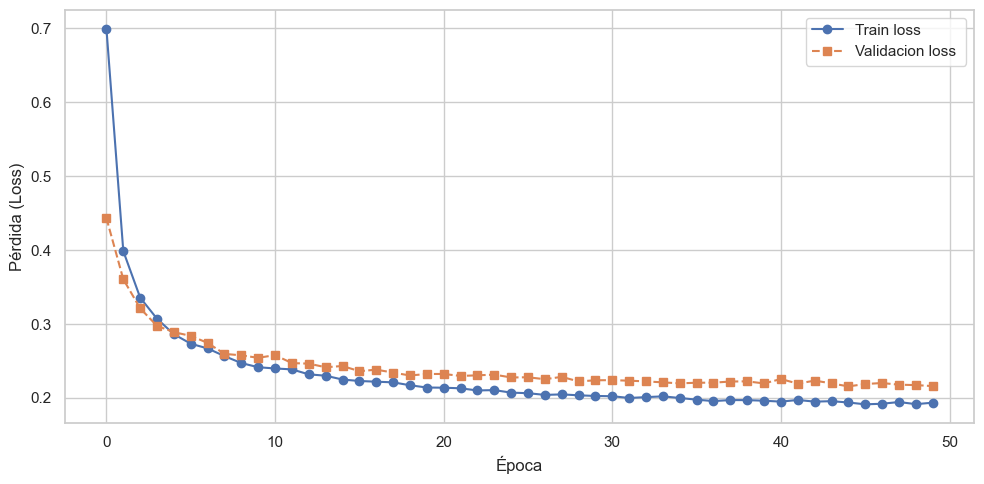



--- Ejecutando Análisis de Distribución para BRITS ---

--- Generando Gráficos de Densidad (KDE) ---



--- Análisis Completo de Distribución (Límite TOST: 5%) ---

--- Summary Table: Distribution Analysis ---


,Variable,Original Mean,Imputed Mean,Mean Difference,TOST Limit ±,Equivalent (TOST),W-Dist Relative (%)
0,Value_CO,0.399714,0.396621,0.003093,0.105,True,1.678831
1,Value_NO,4.427091,4.228078,0.199014,4.800,True,0.863616
2,Value_NO2,16.981794,17.007911,-0.026117,5.300,True,1.457133
3,Value_NOX,21.419302,21.155491,0.263811,7.250,True,1.512049
4,Value_SO2,3.021514,2.689676,0.331839,4.650,True,0.523159
5,Value_O3,41.022892,39.782347,1.240545,9.800,True,2.077384
6,Value_PM10,31.833579,31.758556,0.075023,10.200,True,1.646059
7,Value_PM25,18.918411,18.558327,0.360083,6.300,True,1.823310
8,Value_PMCO,12.917656,13.373102,-0.455446,8.700,True,0.970336
9,Value_RH,54.330322,54.992653,-0.662331,4.900,True,2.980830


Resultados del análisis de distribución guardados en 'df_imputaciones_brits_random/analisis_distribucion_brits_random_AJM.csv'

✅ Proceso de imputación finalizado.


(                      date id_station  Value_CO  Value_NO  Value_NO2  \
 1        01-01-14 01:00:00        AJM       NaN       NaN        NaN   
 40       01-01-14 02:00:00        AJM       NaN       NaN        NaN   
 79       01-01-14 03:00:00        AJM       NaN       NaN        NaN   
 118      01-01-14 04:00:00        AJM       NaN       NaN        NaN   
 157      01-01-14 05:00:00        AJM       NaN       NaN        NaN   
 ...                    ...        ...       ...       ...        ...   
 3418078  31-12-23 19:00:00        AJM      0.30       0.0       16.0   
 3418117  31-12-23 20:00:00        AJM      0.37       0.0       18.0   
 3418156  31-12-23 21:00:00        AJM      0.27       0.0       16.0   
 3418195  31-12-23 22:00:00        AJM      0.57       1.0       26.0   
 3418234  31-12-23 23:00:00        AJM      0.49       0.0       21.0   
 
          Value_NOX  Value_SO2  Value_O3  Value_PM10  Value_PM25  Value_PMCO  \
 1              NaN        NaN       NaN  

In [15]:
imputacion_brits(df_ajm)

# Grafico datos faltantes

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


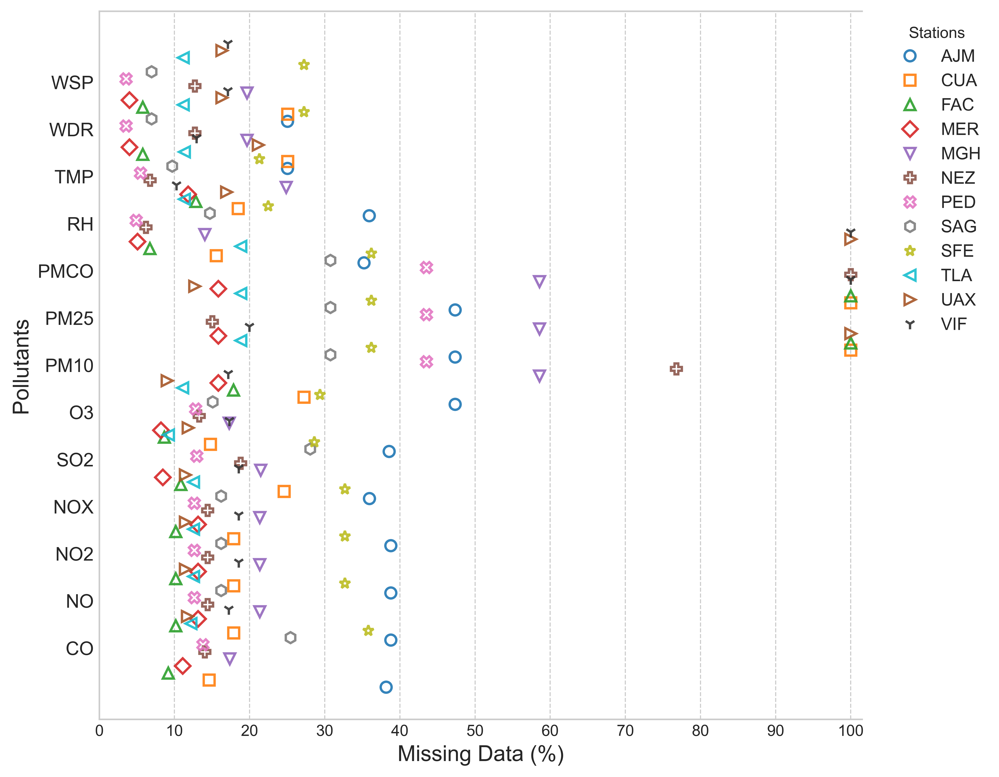

In [14]:
# Funcion para crear grafico de datos faltantes
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def plot_missing_data_markers(df_completo, lista_estaciones,fname_base='missing_data_scientific_plot'):

    if not lista_estaciones:
        raise ValueError("'lista_estaciones' no puede estar vacía")

    # ---- Calcular % faltante por estación ----
    resultados = {}
    columnas_eval = None

    for est in lista_estaciones:
        df_est = df_completo[df_completo['id_station'] == est]
        if df_est.empty:
            print(f"  Sin datos para la estación: '{est}', se omite.")
            continue

        resultados[est] = (df_est.isnull().sum() / len(df_est)) * 100
        if columnas_eval is None:
            columnas_eval = df_est.select_dtypes(include=np.number).columns

    if not resultados:
        print("No hay datos para graficar.")
        return

    df_res = pd.DataFrame(resultados).loc[columnas_eval]

    # ---- Gráfica ----
    plt.style.use('seaborn-v0_8-whitegrid')
    fig, ax = plt.subplots(figsize=(10, 7), dpi=600)

    # Paleta de colores extendida (20 colores)
    colores_rgb = [
        (0.121, 0.466, 0.705),  # azul
        (1.000, 0.498, 0.054),  # naranja
        (0.172, 0.627, 0.172),  # verde
        (0.839, 0.153, 0.157),  # rojo
        (0.580, 0.403, 0.741),  # púrpura
        (0.549, 0.337, 0.294),  # marrón
        (0.890, 0.466, 0.760),  # rosa
        (0.498, 0.498, 0.498),  # gris
        (0.737, 0.741, 0.133),  # oliva
        (0.090, 0.745, 0.811),  # cian
        (0.650, 0.337, 0.156),  # café claro
        (0.200, 0.200, 0.200),  # negro suave
        (0.992, 0.906, 0.145),  # amarillo
        (0.415, 0.239, 0.603),  # morado oscuro
        (0.996, 0.733, 0.450),  # durazno
        (0.129, 0.403, 0.674),  # azul medio
        (0.556, 0.184, 0.494),  # violeta
        (0.231, 0.616, 0.839),  # azul claro
        (0.619, 0.792, 0.227),  # verde claro
        (0.796, 0.647, 0.000),  # mostaza
    ]

    # Lista de marcadores extendida
    marcadores = ['o', 's', '^', 'D', 'v', 'P', 'X', 'h', '*', '<',
                  '>', '1', '2', '3', '4', '|', '_', '+', '.', ',']

    y_pos = np.arange(len(df_res.index))
    jitter = 0.15
    offsets = np.linspace(-jitter*(len(lista_estaciones)-1)/2,
                          jitter*(len(lista_estaciones)-1)/2,
                          len(lista_estaciones))

    for i, est in enumerate(df_res.columns):
        ax.plot(df_res[est],
                y_pos + offsets[i],
                marker=marcadores[i % len(marcadores)],
                linestyle='none',
                ms=7,
                alpha=0.9,
                label=est,
                markerfacecolor='none',
                markeredgecolor=colores_rgb[i % len(colores_rgb)],
                markeredgewidth=1.5)

    ax.set_xlabel('Missing Data (%)', fontsize=14)
    ax.set_ylabel('Pollutants', fontsize=14)
    ax.set_yticks(y_pos)
    ax.set_yticklabels([lbl.replace('Value_', '') for lbl in df_res.index],
                       fontsize=12)

    ax.set_xlim(0, 101.5)
    ax.set_xticks(np.arange(0, 101, 10))
    ax.spines['right'].set_visible(False)

    ax.legend(title='Stations', fontsize=11,
              bbox_to_anchor=(1.02, 1), loc='upper left')
    ax.grid(True, axis='x', linestyle='--', linewidth=0.7)
    ax.grid(False, axis='y')

    plt.tight_layout(rect=[0, 0, 0.9, 1])

    fig.savefig(f'{fname_base}.png', dpi=600, bbox_inches='tight')
    fig.savefig(f'{fname_base}.pdf', dpi=600, bbox_inches='tight')
    fig.savefig(f'{fname_base}.eps', dpi=600, bbox_inches='tight')
    plt.show()


# Uso de la función 
if __name__ == '__main__':
    df = pd.read_csv('df/datos_unidos2.csv')  
    estaciones = sorted([
        'MER', 'TLA', 'SAG', 'PED', 'FAC', 'NEZ',
        'UAX', 'VIF', 'CUA', 'MGH',
        'SFE', 'AJM'   # 🔹 nuevas estaciones añadidas
    ])
    plot_missing_data_markers(df, estaciones)


# Matriz nullidad 

Procesando estación: AJM...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: CUA...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: FAC...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: MER...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: MGH...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: NEZ...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: PED...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: SAG...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: SFE...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: TLA...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: UAX...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


Procesando estación: VIF...


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\3063423515.py:23: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')


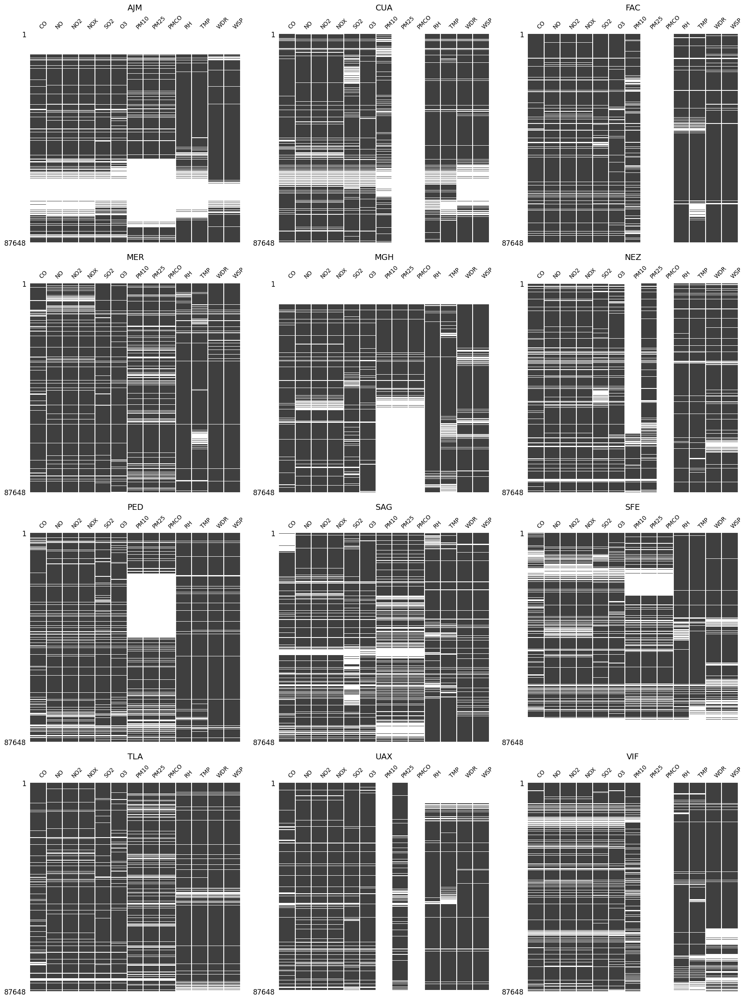

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import missingno as msno
import numpy as np

def matriz_nulidad_por_estacion(df, lista_estaciones, date_column='date', date_format=None):

    n = len(lista_estaciones)
    n_cols = 3
    n_rows = -(-n // n_cols)  # redondeo hacia arriba

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 6))
    axs = axs.flatten()

    for i, estacion in enumerate(lista_estaciones):
        print(f"Procesando estación: {estacion}...")

        # Filtrar
        df_est = df[df['id_station'] == estacion].copy()

        # Convertir y ordenar por fecha
        if date_column in df_est.columns:
            df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')
            df_est = df_est.dropna(subset=[date_column])
            df_est = df_est.sort_values(by=date_column)

        # Renombrar columnas (quitar "Value_")
        df_plot = df_est.rename(columns=lambda c: c.replace('Value_', ''))

        # Eliminar columnas que no queremos graficar
        cols_to_drop = ['id_station', date_column]
        df_plot = df_plot.drop(columns=[c for c in cols_to_drop if c in df_plot.columns])

        # Graficar la matriz de nulidad
        msno.matrix(df_plot, ax=axs[i], sparkline=False, fontsize=10)

        axs[i].set_title(f"{estacion}", fontsize=14)

    # Eliminar ejes sobrantes
    for j in range(i + 1, len(axs)):
        fig.delaxes(axs[j])

    plt.tight_layout()
    plt.savefig("matriz_nulidad_estaciones.png", dpi=600, bbox_inches='tight')
    plt.show()


#  ejecucion fuincion: 
if __name__ == '__main__':
    df = pd.read_csv('df/datos_unidos2.csv') 
    estaciones = sorted(['CUA', 'FAC', 'MER', 'MGH', 'NEZ', 'PED', 'SAG', 'TLA', 'UAX', 'VIF', 'SFE', 'AJM'])  # agregar o quitar las estaciones que se quieran 
    
    matriz_nulidad_por_estacion(df, estaciones)



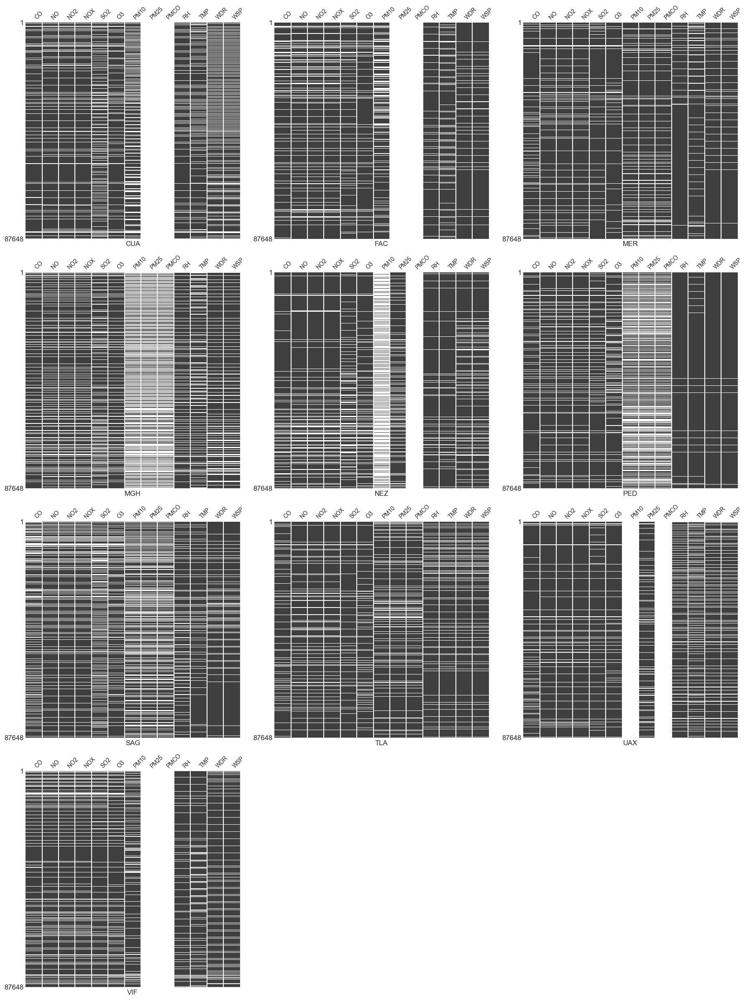

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import missingno as msno

def matriz_nulidad_por_estacion(df, lista_estaciones, date_column='Date', date_format=None):

    n = len(lista_estaciones)
    n_cols = 3
    n_rows = -(-n // n_cols) 

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 6))
    axs = axs.flatten()

    for i, estacion in enumerate(lista_estaciones):
        df_est = df[df['id_station'] == estacion].copy()
        

        if date_column in df_est.columns:
            try:

                df_est[date_column] = pd.to_datetime(df_est[date_column], format=date_format, errors='coerce')
                df_est = df_est.dropna(subset=[date_column])
                
                
                
                df_est = df_est.sort_values(by=date_column)
            except Exception as e:
                print(f"Error al convertir o ordenar la columna '{date_column}' para la estación {estacion}: {e}")
                continue 

       
        df_est_numeric = df_est.select_dtypes(include='number')
        new_columns = [col.replace('Value_', '') for col in df_est_numeric.columns]
        df_est_numeric.columns = new_columns

        
        msno.matrix(df_est_numeric, ax=axs[i], sparkline=False, fontsize=10)
        
        
        axs[i].set_xlabel(estacion, fontsize=12)
        
        axs[i].set_title('')

    
    for j in range(i + 1, len(axs)):
        fig.delaxes(axs[j])

    plt.tight_layout()
    plt.savefig("matriz_nulidad_estaciones.png", dpi=600, bbox_inches='tight')
    plt.show()


# uso de la funcion
if __name__ == '__main__':
    df = pd.read_csv('df/datos_unidos2.csv') 
    estaciones = sorted(['CUA', 'FAC', 'MER', 'MGH', 'NEZ', 'PED', 'SAG', 'TLA', 'UAX', 'VIF'])
    
    matriz_nulidad_por_estacion(df, estaciones)

# Grafica series de tiempo

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

def graficar_series_comparativas(df_original, df_imputado, contaminante, anio_inicio=2014, anio_fin=2023):

    
    # --- 1. Crear la figura con dos subplots 
    fig, axes = plt.subplots(2, 1, figsize=(30, 8), sharex=True) # sharex=True para que compartan el eje de tiempo

   
    titulo_contaminante = contaminante.replace("Value_", "")
    fig.suptitle(f'Promedio Diario de {titulo_contaminante} ({anio_inicio}-{anio_fin})', fontsize=18, weight='bold')

   
    ax1 = axes[0]
    df_obs = df_original.copy()
    
    # Procesamiento de fechas 
    if 'date' not in df_obs.columns and df_obs.index.name != 'date':
        df_obs.reset_index(inplace=True) # Si la fecha está en el índice
        
    df_obs['date'] = pd.to_datetime(df_obs['date'], format='%d-%m-%y %H:%M:%S', errors='coerce')
    df_obs.set_index('date', inplace=True)
    
    # Filtrar por años y calcular promedio diario
    df_filtro_obs = df_obs[(df_obs.index.year >= anio_inicio) & (df_obs.index.year <= anio_fin)]
    df_diario_obs = df_filtro_obs[contaminante].resample('D').mean()
    

    ax1.plot(df_diario_obs.index, df_diario_obs, color='blue', linestyle='-', alpha=0.7, linewidth=0.8, label='Original')
    ax1.set_ylabel('Promedio Diario', fontsize=15)
    ax1.tick_params(axis='y', labelsize=12)
    ax1.set_title('Datos Originales (con interrupciones por datos faltantes)', fontsize=14)
    ax1.legend()
    ax1.grid(True)

    ax2 = axes[1]
    df_imp = df_imputado.copy()

    # Procesamiento de fechas
    if 'date' not in df_imp.columns and df_imp.index.name != 'date':
        df_imp.reset_index(inplace=True)
        
    df_imp['date'] = pd.to_datetime(df_imp['date'], format='%d-%m-%y %H:%M:%S', errors='coerce')
    df_imp.set_index('date', inplace=True)

    # Filtrar por años y calcular promedio diario
    df_filtro_imp = df_imp[(df_imp.index.year >= anio_inicio) & (df_imp.index.year <= anio_fin)]
    df_diario_imp = df_filtro_imp[contaminante].resample('D').mean()
    
    # Graficar
    ax2.plot(df_diario_imp.index, df_diario_imp, color='red', linestyle='-', alpha=0.6, linewidth=0.8, label='Imputado')
    ax2.set_xlabel('Fecha', fontsize=15)
    ax2.set_ylabel('Promedio Diario', fontsize=15)
    ax2.tick_params(axis='y', labelsize=12)
    ax2.set_title('Datos Imputados (Serie de Tiempo Completa)', fontsize=14)
    ax2.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax2.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    ax2.tick_params(axis='x', labelsize=20)
    ax2.legend()
    ax2.grid(True)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
    plt.show()


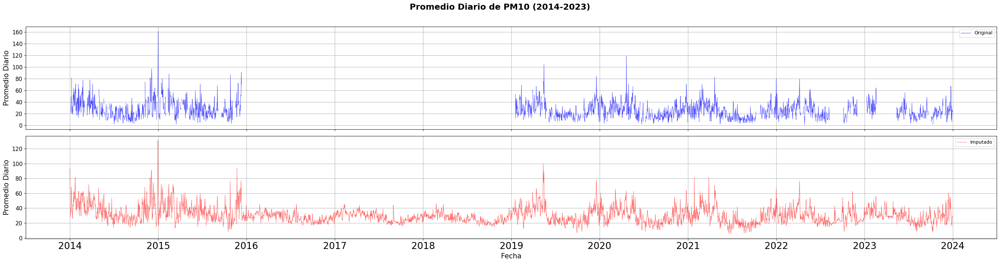

In [90]:
graficar_promedio_comparativo(df_ped, df_imputado_brits_ped, 'Value_PM10')

# Mapa de Estaciones 

In [17]:
import folium

m = folium.Map(location=[19.432608, -99.133209], zoom_start=10)

station_dict = {
    'ACO': [19.635501, -98.912003],
    'AJM': [19.272100, -99.207658],
    'ATI': [19.576963, -99.254133],
    'BJU': [19.371612, -99.158969],
    'CAM': [19.468404, -99.169794],
    'CCA': [19.3262, -99.1761],
    'CHO': [19.266948, -98.886088],
    'CUA': [19.365313, -99.291705],
    'FAC': [19.482473, -99.243524],
    'FAR': [19.473692, -99.046176],
    'HGM': [19.411617, -99.152207],
    'INN': [19.291968, -99.38052],
    'IZT': [19.384413, -99.117641],
    'LLA': [19.578792, -99.039644],
    'LPR': [19.534727, -99.11772],
    'MER': [19.42461, -99.119594],
    'MGH': [19.404050, -99.202603],
    'MON': [19.460415, -98.902853],
    'MPA': [19.176900, -98.990189],
    'NEZ': [19.393734, -99.028212],
    'PED': [19.325146, -99.204136],
    'SAG': [19.532968, -99.030324],
    'SAC': [19.34561, -99.009381],
    'TAH': [19.246459, -99.010564],
    'TLA': [19.529077, -99.204597],
    'TLI': [19.602542, -99.177173],
    'UAX': [19.304441, -99.103629],
    'UIZ': [19.360794, -99.07388],
    'VIF': [19.658223, -99.09659],
    'XAL': [19.525995, -99.0824],
    'CUT': [19.646780, -99.210240],
    'SFE': [19.357769, -99.268335],
    'AJU': [19.154674, -99.162459],
    'GAM': [19.484220, -99.109883],
}

blue_stations = [
    'MER', 'TLA', 'SAG', 'PED', 'UAX', 'NEZ',
    'FAC', 'AJM', 'CUA', 'MGH', 'SFE', 'VIF'
]  # Estaciones que se analizan

def mapping(station_list):
    for i, coords in station_list.items():
        if i in blue_stations:
            color = 'blue'
            border = '#004080'
        else:
            color = 'red'
            border = '#800000'

        # Marcador principal
        folium.Marker(
            coords,
            icon=folium.Icon(color=color),
            tooltip=i
        ).add_to(m)

        # Cuadrito con nombre debajo
        folium.map.Marker(
            location=coords,
            icon=folium.DivIcon(
                html=f"""
                <div style="
                    font-size:13px;
                    font-weight:bold;
                    color:{border};
                    background-color: rgba(255,255,255,0.85);
                    border: 1px solid {border};
                    border-radius:4px;
                    padding:2px 4px;
                    margin-bottom:20px;
                ">
                    {i}
                </div>
                """
            )
        ).add_to(m)

mapping(station_dict)

m.save("mapa_estaciones.html")
m

In [ ]:


def graficar_comparacion_promedio(df_original, df_imputado, contaminante, anio_inicio=2014, anio_fin=2023):
    """
    Grafica y compara el promedio diario de un contaminante específico
    de dos DataFrames (original e imputado) en dos subgráficos separados
    dentro de la misma imagen.
    """

    # funcion para preparar los df 
    def preparar_df(df_input):
        df = df_input.copy()
        if 'date' not in df.columns and isinstance(df.index, pd.DatetimeIndex):
            df.reset_index(inplace=True)
        df['date'] = pd.to_datetime(df['date'], errors='coerce')
        df.dropna(subset=['date'], inplace=True)
        df.set_index('date', inplace=True)
        return df


    print("Procesando DataFrame original...")
    df_obs = preparar_df(df_original)
    print("Procesando DataFrame imputado...")
    df_imp = preparar_df(df_imputado)

    # Filtrar por años
    df_obs_filtro = df_obs[(df_obs.index.year >= anio_inicio) & (df_obs.index.year <= anio_fin)]
    df_imp_filtro = df_imp[(df_imp.index.year >= anio_inicio) & (df_imp.index.year <= anio_fin)]

    # Calcular el promedio diario
    df_obs_diario = df_obs_filtro[contaminante].resample('D').mean()
    df_imp_diario = df_imp_filtro[contaminante].resample('D').mean()

    
    print("Generando gráfico...")
    fig, axes = plt.subplots(2, 1, figsize=(20, 8), sharex=True)



    axes[0].plot(df_obs_diario.index, df_obs_diario, color='blue', linestyle='-', alpha=0.7, label='Original')

    axes[0].set_ylabel(f'Daily average PM10', fontsize=12)
    axes[0].legend()
    axes[0].grid(True, linestyle='--', alpha=0.6)


    axes[1].plot(df_imp_diario.index, df_imp_diario, color='orange', linestyle='-', alpha=0.8, label='Imputed')

    axes[1].set_xlabel('Date', fontsize=12)
    axes[1].set_ylabel(f'Daily average PM10', fontsize=12)
    axes[1].legend()
    axes[1].grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()


graficar_comparacion_promedio(df_ped, df_ped_imputado, 'Value_PM10')

# Busqueda de  Parametros Random Forest


In [ ]:
#Busqueda parametro RANDOM FOREST con "GRID SEARCH"
import pandas as pd
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from IPython.display import display
import itertools
import json



def _evaluar_config_rf(df_estacion, n_estimators, max_iter, max_depth, min_samples_split, min_samples_leaf):
    """
    Función interna para evaluar una única configuración de RF.
    Acepta todos los hiperparámetros del RandomForestRegressor.
    Devuelve el MAE y RMSE promedio del conjunto de validación.
    """
    params = {
        'n_estimators': n_estimators, 'max_iter': max_iter, 'max_depth': max_depth,
        'min_samples_split': min_samples_split, 'min_samples_leaf': min_samples_leaf
    }
    print(f"  Evaluando: {params}")

    df_numeric = df_estacion.select_dtypes(include=np.number)

    # División del entrenamiento y validación (80-20)
    val_size = int(len(df_numeric) * 0.2)
    df_train = df_numeric.iloc[:-val_size]
    df_val = df_numeric.iloc[-val_size:]

    # Crear el estimador RandomForestRegressor con los parámetros dados
    estimator = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        n_jobs=-1,  # Usar todos los núcleos disponibles
        random_state=0
    )

    #  imputador iterativo
    imputer = IterativeImputer(
        estimator=estimator,
        max_iter=max_iter,
        random_state=0,
        verbose=0
    )

    
    imputer.fit(df_train)

    df_val_truth = df_val.dropna()

    # Si hay muy pocos datos completos en el conjunto de validación, no se puede evaluar
    if len(df_val_truth) < 20:
        print("  Advertencia: No hay suficientes datos de validación completos para evaluar. Omitiendo esta configuración.")
        return float('inf'), float('inf')

    # Crear huecos artificiales en el conjunto de validación
    df_val_holey = df_val_truth.copy()
    for col in df_val_holey.columns:
        hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False) # Se oculta el 20% de los datos
        df_val_holey.loc[hole_indices, col] = np.nan

    # Aplicar la imputación al conjunto de validación con agujeros
    df_val_reimputed_array = imputer.transform(df_val_holey)
    df_val_reimputed = pd.DataFrame(df_val_reimputed_array, index=df_val_holey.index, columns=df_val_holey.columns)

    # Calcular MAE y RMSE para cada variable
    maes, rmses = [], []
    for col in df_val_truth.columns:
        maes.append(mean_absolute_error(df_val_truth[col], df_val_reimputed[col]))
        rmses.append(np.sqrt(mean_squared_error(df_val_truth[col], df_val_reimputed[col])))

    # Calcular el promedio de las métricas de error
    avg_mae = np.mean(maes)
    avg_rmse = np.mean(rmses)

    print(f"  -> Resultado: Avg MAE={avg_mae:.4f}, Avg RMSE={avg_rmse:.4f}")
    return avg_mae, avg_rmse

# --- Función Principal de Búsqueda de Hiperparámetros ---

def buscar_mejores_parametros_rf(df_estacion):
    """
    Realiza una búsqueda de hiperparámetros por etapas para Random Forest.
    """
    print("--- Iniciando Búsqueda de Hiperparámetros Extendida para Random Forest ---")

    resultados_grid = []
    # Iniciar con valores por defecto razonables
    mejor_config_provisional = {
        'n_estimators': 100,
        'max_depth': None,
        'min_samples_split': 2,
        'min_samples_leaf': 1,
        'max_iter': 10
    }

    # --- Etapa 1: Encontrar el mejor n_estimators ---
    print("\n🚀 Etapa 1: Buscando el mejor número de estimadores (n_estimators)...")
    etapa1_grid = {'n_estimators': [10, 20, 50, 80]}
    mejor_rmse, mejor_mae = float('inf'), float('inf')

    for n_est in etapa1_grid['n_estimators']:
        config = mejor_config_provisional.copy()
        config['n_estimators'] = n_est
        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse, 'etapa': 1})

        if avg_rmse < mejor_rmse:
            mejor_rmse, mejor_mae = avg_rmse, avg_mae
            mejor_config_provisional['n_estimators'] = n_est

    print(f"\n✅ Mejor config tras Etapa 1: {mejor_config_provisional}")

    # --- Etapa 2: Encontrar la mejor profundidad máxima (max_depth) ---
    print("\n🚀 Etapa 2: Buscando la mejor profundidad máxima (max_depth)...")
    etapa2_grid = {'max_depth': [10, 20, None]}
    mejor_rmse, mejor_mae = float('inf'), float('inf')

    for depth in etapa2_grid['max_depth']:
        config = mejor_config_provisional.copy()
        config['max_depth'] = depth
        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse, 'etapa': 2})

        if avg_rmse < mejor_rmse:
            mejor_rmse, mejor_mae = avg_rmse, avg_mae
            mejor_config_provisional['max_depth'] = depth

    print(f"\n✅ Mejor config tras Etapa 2: {mejor_config_provisional}")

    # --- Etapa 3: Encontrar el mejor min_samples_split ---
    print("\n🚀 Etapa 3: Buscando el mejor número mínimo de muestras para dividir (min_samples_split)...")
    etapa3_grid = {'min_samples_split': [2, 5, 10, 15]}
    mejor_rmse, mejor_mae = float('inf'), float('inf')

    for split_val in etapa3_grid['min_samples_split']:
        config = mejor_config_provisional.copy()
        config['min_samples_split'] = split_val
        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse, 'etapa': 3})

        if avg_rmse < mejor_rmse:
            mejor_rmse, mejor_mae = avg_rmse, avg_mae
            mejor_config_provisional['min_samples_split'] = split_val

    print(f"\n✅ Mejor config tras Etapa 3: {mejor_config_provisional}")

    # --- Etapa 4: Encontrar el mejor min_samples_leaf ---
    print("\n🚀 Etapa 4: Buscando el mejor número mínimo de muestras por hoja (min_samples_leaf)...")
    etapa4_grid = {'min_samples_leaf': [1, 2, 4, 6]}
    mejor_rmse, mejor_mae = float('inf'), float('inf')

    for leaf_val in etapa4_grid['min_samples_leaf']:
        config = mejor_config_provisional.copy()
        config['min_samples_leaf'] = leaf_val
        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse, 'etapa': 4})

        if avg_rmse < mejor_rmse:
            mejor_rmse, mejor_mae = avg_rmse, avg_mae
            mejor_config_provisional['min_samples_leaf'] = leaf_val

    print(f"\n✅ Mejor config tras Etapa 4: {mejor_config_provisional}")

    # --- Etapa 5: Encontrar el mejor max_iter ---
    print("\n🚀 Etapa 5: Buscando el mejor número de iteraciones de imputación (max_iter)...")
    etapa5_grid = {'max_iter': [5, 10, 15, 20]}
    mejor_rmse, mejor_mae = float('inf'), float('inf')

    for m_iter in etapa5_grid['max_iter']:
        config = mejor_config_provisional.copy()
        config['max_iter'] = m_iter
        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_grid.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse, 'etapa': 5})

        if avg_rmse < mejor_rmse:
            mejor_rmse, mejor_mae = avg_rmse, avg_mae
            mejor_config_provisional['max_iter'] = m_iter

    print(f"\n✅ Mejor config tras Etapa 5: {mejor_config_provisional}")

    mejor_config_final = mejor_config_provisional
    print("\n\n" + "="*50)
    print("🟢 Búsqueda Finalizada. Mejor configuración encontrada:")
    print(json.dumps(mejor_config_final, indent=4))
    print(f"Con un RMSE promedio de: {mejor_rmse:.4f} y un MAE promedio de: {mejor_mae:.4f}")
    print("="*50 + "\n")

    # Guardar resultados
    try:
        with open("mejor_config_rf.json", "w") as f:
            json.dump(mejor_config_final, f, indent=4)

        df_resultados = pd.DataFrame(resultados_grid)
        df_resultados.to_csv("resultados_grid_rf.csv", index=False)

        print("Resultados de la búsqueda guardados en 'mejor_config_rf.json' y 'resultados_grid_rf.csv'")
        print("\nResultados completos de la búsqueda:")
        display(df_resultados)
    except Exception as e:
        print(f"Error al guardar los archivos de resultados: {e}")

    return mejor_config_final, pd.DataFrame(resultados_grid)





In [ ]:
# Busqueda de parametros Random Forest por RANDOM SEARCH
import pandas as pd
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
import json
import random
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns




def _evaluar_config_rf(df_estacion, n_estimators, max_iter, max_depth, min_samples_split, min_samples_leaf):
    """
    Función interna para evaluar una única configuración de RF. (SIN CAMBIOS)
    Acepta todos los hiperparámetros del RandomForestRegressor.
    Devuelve el MAE y RMSE promedio del conjunto de validación.
    """
    params = {
        'n_estimators': n_estimators, 'max_iter': max_iter, 'max_depth': max_depth,
        'min_samples_split': min_samples_split, 'min_samples_leaf': min_samples_leaf
    }
    print(f"  Evaluando: {params}")

    df_numeric = df_estacion.select_dtypes(include=np.number)
    val_size = int(len(df_numeric) * 0.2)
    df_train = df_numeric.iloc[:-val_size]
    df_val = df_numeric.iloc[-val_size:]

    estimator = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        n_jobs=-1,
        random_state=0
    )

    imputer = IterativeImputer(
        estimator=estimator,
        max_iter=max_iter,
        random_state=0,
        verbose=0
    )

    imputer.fit(df_train)
    df_val_truth = df_val.dropna()

    if len(df_val_truth) < 20:
        print("  Advertencia: No hay suficientes datos de validación completos para evaluar.")
        return float('inf'), float('inf')

    df_val_holey = df_val_truth.copy()
    for col in df_val_holey.columns:
        hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False)
        df_val_holey.loc[hole_indices, col] = np.nan

    df_val_reimputed_array = imputer.transform(df_val_holey)
    df_val_reimputed = pd.DataFrame(df_val_reimputed_array, index=df_val_holey.index, columns=df_val_holey.columns)

    maes, rmses = [], []
    for col in df_val_truth.columns:
        maes.append(mean_absolute_error(df_val_truth[col], df_val_reimputed[col]))
        rmses.append(np.sqrt(mean_squared_error(df_val_truth[col], df_val_reimputed[col])))

    avg_mae = np.mean(maes)
    avg_rmse = np.mean(rmses)

    print(f"  -> Resultado: Avg MAE={avg_mae:.4f}, Avg RMSE={avg_rmse:.4f}")
    return avg_mae, avg_rmse


def graficar_resultados_busqueda(df_resultados):
    """
    Crea gráficos para visualizar los resultados de la búsqueda de hiperparámetros.
    """
    print("\nGenerando gráficos de resultados de la búsqueda...")
    
    # Filtrar resultados infinitos si los hubiera
    df_plot = df_resultados[np.isfinite(df_resultados['avg_rmse'])].copy()
    
    if df_plot.empty:
        print("No hay resultados válidos para graficar.")
        return

    # Reemplazar None en max_depth por un valor numérico para graficar
    max_depth_val = df_plot['max_depth'].max() if df_plot['max_depth'].notna().any() else 50
    df_plot['max_depth_plot'] = df_plot['max_depth'].fillna(max_depth_val + 10)


    sns.set_theme(style="whitegrid")
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Análisis de Resultados de Búsqueda Aleatoria para Random Forest', fontsize=16)

    # Gráfico 1: RMSE vs. n_estimators
    sns.scatterplot(ax=axes[0, 0], data=df_plot, x='n_estimators', y='avg_rmse', alpha=0.7)
    axes[0, 0].set_title('RMSE vs. Número de Estimadores')
    axes[0, 0].set_xlabel('n_estimators')
    axes[0, 0].set_ylabel('RMSE Promedio')

    # Gráfico 2: RMSE vs. max_depth
    sns.scatterplot(ax=axes[0, 1], data=df_plot, x='max_depth_plot', y='avg_rmse', alpha=0.7)
    axes[0, 1].set_title('RMSE vs. Profundidad Máxima')
    axes[0, 1].set_xlabel('max_depth (None se muestra a la derecha)')
    axes[0, 1].set_ylabel('RMSE Promedio')

    # Gráfico 3: MAE vs. min_samples_split
    sns.scatterplot(ax=axes[1, 0], data=df_plot, x='min_samples_split', y='avg_mae', alpha=0.7)
    axes[1, 0].set_title('MAE vs. Muestras Mínimas para Dividir')
    axes[1, 0].set_xlabel('min_samples_split')
    axes[1, 0].set_ylabel('MAE Promedio')

    # Gráfico 4: MAE vs. min_samples_leaf
    sns.scatterplot(ax=axes[1, 1], data=df_plot, x='min_samples_leaf', y='avg_mae', alpha=0.7)
    axes[1, 1].set_title('MAE vs. Muestras Mínimas por Hoja')
    axes[1, 1].set_xlabel('min_samples_leaf')
    axes[1, 1].set_ylabel('MAE Promedio')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


def buscar_mejores_parametros_rf_random(df_estacion, n_iteraciones=50):
    """
    Realiza una búsqueda de hiperparámetros aleatoria y unificada para Random Forest.
    """
    print("--- Iniciando Búsqueda Aleatoria para Random Forest ---")

    # --- ESPACIO DE BÚSQUEDA CON VALORES ESPECÍFICOS ---
    search_space = {
        'n_estimators': [10, 20, 50, 80],
        'max_depth': [10, 20, None],
        'max_iter': [5, 10, 15],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    }

    resultados_busqueda = []
    mejor_config_final = None
    mejor_rmse = float('inf')

    print(f"\n🚀 Iniciando Búsqueda con {n_iteraciones} iteraciones...")

    for _ in tqdm(range(n_iteraciones), desc="Buscando Hiperparámetros de RF"):
        # Generar una configuración aleatoria
        config = {
            'n_estimators': random.choice(search_space['n_estimators']),
            'max_iter': random.choice(search_space['max_iter']),
            'max_depth': random.choice(search_space['max_depth']),
            'min_samples_split': random.choice(search_space['min_samples_split']),
            'min_samples_leaf': random.choice(search_space['min_samples_leaf'])
        }

        avg_mae, avg_rmse = _evaluar_config_rf(df_estacion, **config)
        resultados_busqueda.append({**config, 'avg_mae': avg_mae, 'avg_rmse': avg_rmse})

        if avg_rmse < mejor_rmse:
            mejor_rmse = avg_rmse
            mejor_config_final = config
            print(f"🎉 Nueva mejor config encontrada: RMSE={mejor_rmse:.4f}")

    print("\n\n" + "="*50)
    print("🟢 Búsqueda Finalizada. Mejor configuración encontrada:")
    print(json.dumps(mejor_config_final, indent=4))
    print(f"Con un RMSE promedio de: {mejor_rmse:.4f}")
    print("="*50 + "\n")

    # Guardar resultados
    df_resultados = pd.DataFrame(resultados_busqueda)
    try:
        with open("mejor_config_rf_random.json", "w") as f:
            json.dump(mejor_config_final, f, indent=4)
        df_resultados.to_csv("resultados_random_search_rf.csv", index=False)
        print("Resultados guardados en 'mejor_config_rf_random.json' y 'resultados_random_search_rf.csv'")
    except Exception as e:
        print(f"Error al guardar los archivos de resultados: {e}")

    # Graficar los resultados
    graficar_resultados_busqueda(df_resultados)

    return mejor_config_final, df_resultados

In [ ]:
# --- LLAMADA BUSQUEDA PARAMETROS POR GRID SEARCH --
if __name__ == '__main__':
    try:
        
        print(f"Usando el DataFrame 'df_mer' existente. Forma: {df_xal.shape}")
        mejor_config_rf, resultados_rf = buscar_mejores_parametros_rf(df_xal)

        print("\n--- Vista Previa de los resultados de la búsqueda ---")
        display(resultados_rf)

    except NameError:
        print("Error: El DataFrame 'df_mer' no está definido. Por favor, cárgalo antes de ejecutar.")
    except Exception as e:
        print(f"Ocurrió un error inesperado: {e}")

--- Iniciando Búsqueda Aleatoria para Random Forest ---

🚀 Iniciando Búsqueda con 50 iteraciones...


Buscando Hiperparámetros de RF:   0%|          | 0/50 [00:00<?, ?it/s]

  Evaluando: {'n_estimators': 10, 'max_iter': 10, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:   2%|▏         | 1/50 [00:49<40:04, 49.07s/it]

  -> Resultado: Avg MAE=1.8040, Avg RMSE=5.9277
🎉 Nueva mejor config encontrada: RMSE=5.9277
  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:   4%|▍         | 2/50 [01:14<27:57, 34.95s/it]

  -> Resultado: Avg MAE=1.7685, Avg RMSE=5.8007
🎉 Nueva mejor config encontrada: RMSE=5.8007
  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7678, Avg RMSE=5.7121


Buscando Hiperparámetros de RF:   6%|▌         | 3/50 [02:49<48:49, 62.32s/it]

🎉 Nueva mejor config encontrada: RMSE=5.7121
  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:   8%|▊         | 4/50 [03:11<35:48, 46.70s/it]

  -> Resultado: Avg MAE=1.8064, Avg RMSE=5.8978
  Evaluando: {'n_estimators': 80, 'max_iter': 10, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7400, Avg RMSE=5.6560


Buscando Hiperparámetros de RF:  10%|█         | 5/50 [07:00<1:24:10, 112.24s/it]

🎉 Nueva mejor config encontrada: RMSE=5.6560
  Evaluando: {'n_estimators': 80, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7418, Avg RMSE=5.6534


Buscando Hiperparámetros de RF:  12%|█▏        | 6/50 [08:48<1:21:22, 110.97s/it]

🎉 Nueva mejor config encontrada: RMSE=5.6534
  Evaluando: {'n_estimators': 10, 'max_iter': 10, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  14%|█▍        | 7/50 [09:33<1:04:02, 89.37s/it] 

  -> Resultado: Avg MAE=1.7454, Avg RMSE=5.7058
  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7713, Avg RMSE=5.7354


Buscando Hiperparámetros de RF:  16%|█▌        | 8/50 [14:14<1:45:08, 150.19s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.6860, Avg RMSE=5.5039


Buscando Hiperparámetros de RF:  18%|█▊        | 9/50 [17:06<1:47:17, 157.00s/it]

🎉 Nueva mejor config encontrada: RMSE=5.5039
  Evaluando: {'n_estimators': 10, 'max_iter': 15, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  20%|██        | 10/50 [17:53<1:22:01, 123.03s/it]

  -> Resultado: Avg MAE=1.7738, Avg RMSE=5.7712
  Evaluando: {'n_estimators': 20, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7918, Avg RMSE=5.8667


Buscando Hiperparámetros de RF:  22%|██▏       | 11/50 [20:10<1:22:55, 127.58s/it]

  Evaluando: {'n_estimators': 80, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7585, Avg RMSE=5.7262


Buscando Hiperparámetros de RF:  24%|██▍       | 12/50 [24:48<1:49:46, 173.33s/it]

  Evaluando: {'n_estimators': 20, 'max_iter': 5, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  26%|██▌       | 13/50 [25:13<1:19:09, 128.38s/it]

  -> Resultado: Avg MAE=1.7567, Avg RMSE=5.7449
  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7578, Avg RMSE=5.7591


Buscando Hiperparámetros de RF:  28%|██▊       | 14/50 [31:40<2:03:46, 206.30s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7806, Avg RMSE=5.7904


Buscando Hiperparámetros de RF:  30%|███       | 15/50 [33:16<1:40:57, 173.06s/it]

  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7416, Avg RMSE=5.6515


Buscando Hiperparámetros de RF:  32%|███▏      | 16/50 [39:56<2:16:49, 241.47s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  34%|███▍      | 17/50 [40:45<1:40:58, 183.60s/it]

  -> Resultado: Avg MAE=1.7541, Avg RMSE=5.7970
  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7817, Avg RMSE=5.8082


Buscando Hiperparámetros de RF:  36%|███▌      | 18/50 [46:49<2:06:51, 237.86s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7491, Avg RMSE=5.7562


Buscando Hiperparámetros de RF:  38%|███▊      | 19/50 [48:02<1:37:17, 188.30s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  40%|████      | 20/50 [48:27<1:09:34, 139.15s/it]

  -> Resultado: Avg MAE=1.7755, Avg RMSE=5.8308
  Evaluando: {'n_estimators': 80, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7430, Avg RMSE=5.6705


Buscando Hiperparámetros de RF:  42%|████▏     | 21/50 [52:18<1:20:34, 166.70s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7566, Avg RMSE=5.8364


Buscando Hiperparámetros de RF:  44%|████▍     | 22/50 [53:34<1:05:06, 139.53s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  46%|████▌     | 23/50 [54:01<47:39, 105.90s/it]  

  -> Resultado: Avg MAE=1.8171, Avg RMSE=5.8738
  Evaluando: {'n_estimators': 10, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  48%|████▊     | 24/50 [55:16<41:46, 96.42s/it] 

  -> Resultado: Avg MAE=1.8117, Avg RMSE=5.9420
  Evaluando: {'n_estimators': 20, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7534, Avg RMSE=5.6956


Buscando Hiperparámetros de RF:  50%|█████     | 25/50 [57:23<44:03, 105.73s/it]

  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  52%|█████▏    | 26/50 [1:01:19<57:55, 144.80s/it]

  -> Resultado: Avg MAE=1.7279, Avg RMSE=5.6275
  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7304, Avg RMSE=5.7093


Buscando Hiperparámetros de RF:  54%|█████▍    | 27/50 [1:05:16<1:06:05, 172.42s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  56%|█████▌    | 28/50 [1:05:40<46:55, 127.96s/it]  

  -> Resultado: Avg MAE=1.7877, Avg RMSE=5.8987
  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7434, Avg RMSE=5.6561


Buscando Hiperparámetros de RF:  58%|█████▊    | 29/50 [1:11:57<1:10:53, 202.57s/it]

  Evaluando: {'n_estimators': 10, 'max_iter': 5, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  60%|██████    | 30/50 [1:12:12<48:50, 146.55s/it]  

  -> Resultado: Avg MAE=1.7775, Avg RMSE=5.7380
  Evaluando: {'n_estimators': 20, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  62%|██████▏   | 31/50 [1:12:55<36:28, 115.18s/it]

  -> Resultado: Avg MAE=1.7543, Avg RMSE=5.7881
  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7520, Avg RMSE=5.7338


Buscando Hiperparámetros de RF:  64%|██████▍   | 32/50 [1:15:26<37:46, 125.93s/it]

  Evaluando: {'n_estimators': 20, 'max_iter': 10, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  66%|██████▌   | 33/50 [1:16:16<29:17, 103.38s/it]

  -> Resultado: Avg MAE=1.7638, Avg RMSE=5.6995
  Evaluando: {'n_estimators': 50, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7090, Avg RMSE=5.6346


Buscando Hiperparámetros de RF:  68%|██████▊   | 34/50 [1:17:31<25:14, 94.68s/it] 

  Evaluando: {'n_estimators': 20, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  70%|███████   | 35/50 [1:18:09<19:27, 77.83s/it]

  -> Resultado: Avg MAE=1.7468, Avg RMSE=5.7178
  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 10, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7623, Avg RMSE=5.8204


Buscando Hiperparámetros de RF:  72%|███████▏  | 36/50 [1:20:53<24:09, 103.52s/it]

  Evaluando: {'n_estimators': 20, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  74%|███████▍  | 37/50 [1:21:32<18:15, 84.25s/it] 

  -> Resultado: Avg MAE=1.7686, Avg RMSE=5.8094
  Evaluando: {'n_estimators': 10, 'max_iter': 10, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  76%|███████▌  | 38/50 [1:22:18<14:32, 72.74s/it]

  -> Resultado: Avg MAE=1.7858, Avg RMSE=5.8732
  Evaluando: {'n_estimators': 80, 'max_iter': 15, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7731, Avg RMSE=5.7481


Buscando Hiperparámetros de RF:  78%|███████▊  | 39/50 [1:26:21<22:42, 123.88s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  80%|████████  | 40/50 [1:29:24<23:36, 141.66s/it]

  -> Resultado: Avg MAE=1.7348, Avg RMSE=5.6516
  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7243, Avg RMSE=5.7236


Buscando Hiperparámetros de RF:  82%|████████▏ | 41/50 [1:33:31<25:57, 173.09s/it]

  Evaluando: {'n_estimators': 80, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7576, Avg RMSE=5.7415


Buscando Hiperparámetros de RF:  84%|████████▍ | 42/50 [1:35:29<20:53, 156.69s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7185, Avg RMSE=5.5983


Buscando Hiperparámetros de RF:  86%|████████▌ | 43/50 [1:39:28<21:10, 181.49s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 2, 'min_samples_leaf': 4}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7557, Avg RMSE=5.7472


Buscando Hiperparámetros de RF:  88%|████████▊ | 44/50 [1:40:43<14:56, 149.47s/it]

  Evaluando: {'n_estimators': 80, 'max_iter': 5, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7930, Avg RMSE=5.7814


Buscando Hiperparámetros de RF:  90%|█████████ | 45/50 [1:41:51<10:24, 124.93s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 5, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  92%|█████████▏| 46/50 [1:42:37<06:44, 101.17s/it]

  -> Resultado: Avg MAE=1.7118, Avg RMSE=5.6066
  Evaluando: {'n_estimators': 50, 'max_iter': 5, 'max_depth': None, 'min_samples_split': 5, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7804, Avg RMSE=5.8710


Buscando Hiperparámetros de RF:  94%|█████████▍| 47/50 [1:44:00<04:47, 95.81s/it] 

  Evaluando: {'n_estimators': 20, 'max_iter': 5, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(
Buscando Hiperparámetros de RF:  96%|█████████▌| 48/50 [1:44:43<02:40, 80.03s/it]

  -> Resultado: Avg MAE=1.7536, Avg RMSE=5.7231
  Evaluando: {'n_estimators': 50, 'max_iter': 10, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 2}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7533, Avg RMSE=5.7206


Buscando Hiperparámetros de RF:  98%|█████████▊| 49/50 [1:46:19<01:24, 84.86s/it]

  Evaluando: {'n_estimators': 50, 'max_iter': 15, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 1}


c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


  -> Resultado: Avg MAE=1.7405, Avg RMSE=5.6924


Buscando Hiperparámetros de RF: 100%|██████████| 50/50 [1:50:48<00:00, 132.98s/it]




🟢 Búsqueda Finalizada. Mejor configuración encontrada:
{
    "n_estimators": 50,
    "max_iter": 10,
    "max_depth": null,
    "min_samples_split": 5,
    "min_samples_leaf": 2
}
Con un RMSE promedio de: 5.5039

Resultados guardados en 'mejor_config_rf_random.json' y 'resultados_random_search_rf.csv'

Generando gráficos de resultados de la búsqueda...


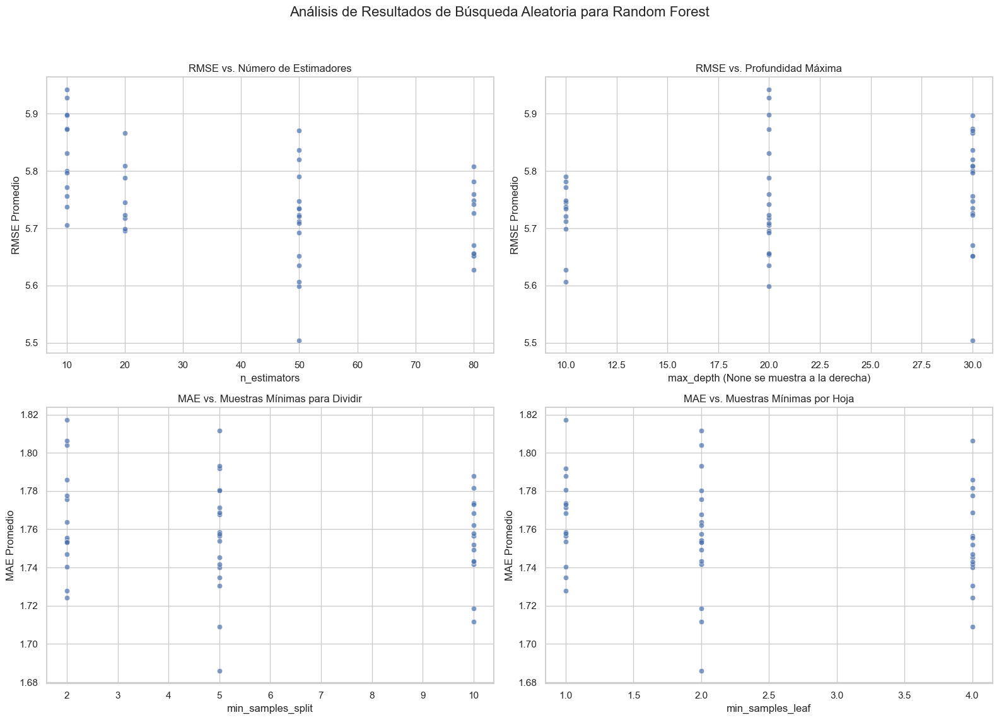

In [ ]:
# LLAMADA BUSUQUEDA DE PARAMETROS POR RANDOM SEARCH
mejor_config, historial_rf = buscar_mejores_parametros_rf_random(df_ajm)

# Imputacion para RANDOM FOREST

In [ ]:
#Imputacion RANDOM FOREST
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.stats.weightstats import ttost_ind
from scipy.stats import wasserstein_distance
from IPython.display import display
import json

# Funciones de Ayuda 

def plot_real_vs_imputed_validation(results_dict, station_name):
    """Genera y guarda los gráficos de dispersión de la validación."""
    print("\n--- Generando Gráficos de Valor Real vs. Imputado ---")
    plot_vars = [var for var, data in results_dict.items() if not data['real_values'].empty]
    n_vars = len(plot_vars)
    if n_vars == 0: return
    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4.5))
    axes = axes.flatten()
    for i, var_name in enumerate(plot_vars):
        ax = axes[i]
        data = results_dict[var_name]
        reales = data['real_values']
        imputados = data['imputed_values']
        ax.scatter(reales, imputados, alpha=0.5, s=10)
        lims = [min(ax.get_xlim()[0], ax.get_ylim()[0]), max(ax.get_xlim()[1], ax.get_ylim()[1])]
        ax.plot(lims, lims, 'r--', alpha=0.75, zorder=0, label='Imputación Perfecta')
        ax.set_xlim(lims); ax.set_ylim(lims)
        ax.set_xlabel(f"Valor Real ({var_name.replace('Value_', '')})")
        ax.set_ylabel("Valor Imputado")
        ax.legend(fontsize='small'); ax.grid(True, linestyle='--', alpha=0.6)
        ax.set_aspect('equal', 'box')
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    plt.tight_layout(pad=1.5)
    # MODIFICADO: Se asegura que el archivo se guarde en la carpeta correcta.
    plt.savefig(f"df_imputaciones_rf_random/real_vs_imputed_validation_rf__random{station_name}.png", dpi=600)
    plt.show()

def analisis_distribucion_kde(df_original, df_imputado, station_name):
    """
    Genera gráficos de densidad (KDE) para comparar las distribuciones 
    """
    print("\n--- Generando Gráficos de Densidad (KDE) ---")
    numeric_cols = df_original.select_dtypes(include=np.number).columns
    n_vars = len(numeric_cols)
    if n_vars == 0: return

    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 4))
    axes = axes.flatten()

    for i, col in enumerate(numeric_cols):
        ax = axes[i]
        
        obs_dist = df_original[col].dropna()
        imp_dist = df_imputado[col]

        sns.kdeplot(obs_dist, label=f'Original ({len(obs_dist)} samples)', fill=True, color='grey', ax=ax)
        sns.kdeplot(imp_dist, label=f'Imputed ({len(imp_dist)} samples)', fill=True, color='orange', ax=ax)
        
        ax.set_title("")
        ax.set_xlabel(col.replace('Value_', ''))
        ax.set_ylabel("Density")
        ax.legend(loc='upper right', frameon=True, fontsize='small')
        ax.text(0.05, 0.05, f'({chr(97 + i)})', transform=ax.transAxes, fontsize=10, va='bottom')
        ax.grid(False)

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    # Carpeta donde  se guardan el archivop 
    plt.savefig(f"df_imputaciones_rf_random/kde_comparison_rf_{station_name}.png", dpi=600)
    plt.show()


def analisis_final_con_tost(df_original, df_imputado, station_name, umbral_relativo=0.05):

    print(f"\n--- Análisis de Distribución Final con TOST y Wasserstein (Límite: {umbral_relativo*100:.0f}%) ---")
    resumen_final = []
    columnas_numericas = df_imputado.select_dtypes(include=np.number).columns

    for col in columnas_numericas:
        obs_dist = df_original[col].dropna()
        imp_dist = df_imputado[col]
        
        if len(obs_dist) < 5: continue
        
        obs_mean = np.mean(obs_dist)
        imp_mean = np.mean(imp_dist)
        mean_diff = obs_mean - imp_mean

        rango = np.nanmax(obs_dist) - np.nanmin(obs_dist)
        if rango == 0 or np.isnan(rango): rango = 1e-8
        limite = umbral_relativo * rango
        
        tost_result = ttost_ind(obs_dist, imp_dist, -limite, limite, usevar='unequal')
        p_val_low, p_val_high = tost_result[1][1], tost_result[2][1]
        equivalencia_tost = (p_val_low < 0.05) and (p_val_high < 0.05)

        w_distance = wasserstein_distance(obs_dist, imp_dist)
        w_distance_relativa = (w_distance / rango) * 100

        resumen_final.append({
            "Variable": col,
            "Original_Mean": obs_mean,
            "Imputed_Mean": imp_mean,
            "Mean_Difference": mean_diff,
            "TOST_Limit_±": limite,
            "p-value_Lower": p_val_low,
            "p-value_Upper": p_val_high,
            "Equivalent_(TOST)": equivalencia_tost,
            "W-Dist_Relative(%)": w_distance_relativa
        })
        
    if resumen_final:
        df_resumen_final = pd.DataFrame(resumen_final)
        print("\n--- Tabla de Análisis de Distribución Final (TOST y Wasserstein) ---")
        display(df_resumen_final)
        
        # MODIFICADO: Se asegura que el archivo se guarde en la carpeta correcta.
        filename = f"df_imputaciones_rf_random/analisis_tost_final_rf_random_{station_name}.csv"
        df_resumen_final.to_csv(filename, index=False)
        print(f"Resultados del análisis final guardados en '{filename}'")

# --- Función Principal Modificada ---

def imputar_y_evaluar_con_rf(df_estacion, rf_params=None):
    """
    Realiza una imputación completa con Random Forest, evalúa, guarda todos los artefactos
    y genera los gráficos y análisis finales.
    """
    print("--- Iniciando Proceso de Imputación y Evaluación con Random Forest ---")
    
    station_name = df_estacion['id_station'].iloc[0] if 'id_station' in df_estacion.columns else 'unknown'
    
    if rf_params is None:
        rf_params = {
            'n_estimators': 50, 'max_depth': None, 'max_iter': 10,                                ################################################
            'min_samples_split': 5, 'min_samples_leaf':2                                  ################################################
        }                                                                                       ################################################
    print(f"Usando hiperparámetros: {rf_params}")
    df_original_completo = df_estacion.copy()
    non_numeric_cols = df_original_completo.select_dtypes(exclude=np.number)
    df_numeric = df_original_completo.select_dtypes(include=np.number)
    val_size = int(len(df_numeric) * 0.2)
    df_train = df_numeric.iloc[:-val_size]
    df_val = df_numeric.iloc[-val_size:]
    print(f"\nDatos divididos: Entrenamiento={len(df_train)} filas, Validación={len(df_val)} filas.")
    estimator = RandomForestRegressor(
        n_estimators=rf_params['n_estimators'], max_depth=rf_params.get('max_depth', None),
        min_samples_split=rf_params.get('min_samples_split', 2),
        min_samples_leaf=rf_params.get('min_samples_leaf', 1),
        n_jobs=-1, random_state=0
    )
    imputer = IterativeImputer(estimator=estimator, max_iter=rf_params['max_iter'], random_state=0, verbose=2)
    imputer.fit(df_train)
    print("Entrenamiento del imputador finalizado.")

    print("\n--- Evaluación Detallada en el Conjunto de Validación ---")
    df_val_truth = df_val.dropna()
    
    if len(df_val_truth) < 20:
        print("Advertencia: No hay suficientes filas completas para una evaluación fiable.")
    else:
        df_val_holey = df_val_truth.copy()
        mascara_huecos = pd.DataFrame(False, index=df_val_holey.index, columns=df_val_holey.columns)
        
        for col in df_val_holey.columns:
            hole_indices = np.random.choice(df_val_holey.index, size=int(len(df_val_holey) * 0.20), replace=False) # <===== 20% de huecos en cada columna
            df_val_holey.loc[hole_indices, col] = np.nan
            mascara_huecos.loc[hole_indices, col] = True

        # MODIFICADO: Se asegura que el archivo se guarde en la carpeta correcta.
        mascara_filename = f"df_imputaciones_rf_random/mascara_huecos_rf_random_{station_name}.json"
        mascara_huecos.to_json(mascara_filename, orient='split')
        print(f"\nMáscara de huecos de validación guardada en '{mascara_filename}'")

        df_val_reimputed_array = imputer.transform(df_val_holey)
        df_val_reimputed = pd.DataFrame(df_val_reimputed_array, index=df_val_holey.index, columns=df_val_holey.columns)

        resumen_val = []
        plot_data_dict = {}

        for col in df_val_truth.columns:
            valores_reales = df_val_truth.loc[mascara_huecos[col], col]
            valores_imputados = df_val_reimputed.loc[mascara_huecos[col], col]
            
            if len(valores_reales) > 0:
                plot_data_dict[col] = {'real_values': valores_reales, 'imputed_values': valores_imputados}
                
                # --- CÁLCULO DE MÉTRICAS Y TOST PARA LA VALIDACIÓN ---
                mae = mean_absolute_error(valores_reales, valores_imputados)
                rmse = np.sqrt(mean_squared_error(valores_reales, valores_imputados))
                r2 = r2_score(valores_reales, valores_imputados)
                
                mean_diff = np.mean(valores_reales) - np.mean(valores_imputados)
                rango_val = np.nanmax(valores_reales) - np.nanmin(valores_reales)
                if rango_val == 0: rango_val = 1e-8
                limite_val = 0.2 * rango_val # Límite del 20% del rango para la validación
                
                tost_val = ttost_ind(valores_reales, valores_imputados, -limite_val, limite_val, usevar='unequal')
                p_low_val, p_high_val = tost_val[1][1], tost_val[2][1]
                equivalencia_val = (p_low_val < 0.05) and (p_high_val < 0.05)
                
                resumen_val.append({
                    "Variable": col,
                    "MAE": mae,
                    "RMSE": rmse,
                    "R2": r2,
                    "Mean_Difference": mean_diff,
                    "TOST_Limit_±": limite_val,
                    "p-value_Lower": p_low_val,
                    "p-value_Upper": p_high_val,
                    "Equivalent_(TOST)": equivalencia_val
                })

        if plot_data_dict:
            serializable_plot_data = {k: {'real_values': v['real_values'].tolist(), 'imputed_values': v['imputed_values'].tolist()} for k, v in plot_data_dict.items()}
            # MODIFICADO: Se asegura que el archivo se guarde en la carpeta correcta.
            results_filename = f"df_imputaciones_rf_random/results_dict_rf_random_{station_name}.json"
            with open(results_filename, 'w') as f:
                json.dump(serializable_plot_data, f, indent=4)
            print(f"Diccionario de resultados de validación guardado en '{results_filename}'")
        
        if resumen_val:
            df_resumen_val = pd.DataFrame(resumen_val)
            print("\n--- Resumen de Métricas y TOST (Validación) ---")
            display(df_resumen_val)
            # MODIFICADO: Se asegura que el archivo se guarde en la carpeta correcta.
            summary_filename = f"df_imputaciones_rf_random/resumen_validacion_rf_random_{station_name}.csv"
            df_resumen_val.to_csv(summary_filename, index=False)
            print(f"Tabla de resumen de validación guardada en '{summary_filename}'")
        
        plot_real_vs_imputed_validation(plot_data_dict, station_name)

    print("\n--- Imputando el DataFrame completo ---")
    df_imputado_final_numeric_array = imputer.transform(df_numeric)
    df_imputado_final_numeric = pd.DataFrame(df_imputado_final_numeric_array, index=df_numeric.index, columns=df_numeric.columns)
    df_imputado_final = pd.concat([non_numeric_cols, df_imputado_final_numeric], axis=1)
    
    imputed_filename = f"df_imputaciones_rf_random/df_imputado_rf_random_{station_name}.csv"
    df_imputado_final.to_csv(imputed_filename, index=False)
    print(f"\nDataFrame final imputado guardado en '{imputed_filename}'")

    
    analisis_final_con_tost(df_original_completo, df_imputado_final, station_name)
    analisis_distribucion_kde(df_original_completo, df_imputado_final, station_name)
    
    print("\n✅ Proceso de imputación y evaluación con Random Forest finalizado.")
    return df_original_completo, df_imputado_final


--- Iniciando Proceso de Imputación y Evaluación con Random Forest ---
Usando hiperparámetros: {'n_estimators': 50, 'max_depth': None, 'max_iter': 10, 'min_samples_split': 5, 'min_samples_leaf': 2}

Datos divididos: Entrenamiento=70119 filas, Validación=17529 filas.
[IterativeImputer] Completing matrix with shape (70119, 13)
[IterativeImputer] Ending imputation round 1/10, elapsed time 14.39
[IterativeImputer] Change: 198.03028920975717, scaled tolerance: 0.36 
[IterativeImputer] Ending imputation round 2/10, elapsed time 59.08
[IterativeImputer] Change: 181.665369047619, scaled tolerance: 0.36 
[IterativeImputer] Ending imputation round 3/10, elapsed time 79.03
[IterativeImputer] Change: 161.72068873015874, scaled tolerance: 0.36 
[IterativeImputer] Ending imputation round 4/10, elapsed time 121.64
[IterativeImputer] Change: 175.96084259740266, scaled tolerance: 0.36 
[IterativeImputer] Ending imputation round 5/10, elapsed time 168.79
[IterativeImputer] Change: 155.93851321789316, sc

c:\Users\PC PRIDE GOAT\Documents\Programa\BRITS\lib\site-packages\sklearn\impute\_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


[IterativeImputer] Ending imputation round 1/10, elapsed time 0.40
[IterativeImputer] Ending imputation round 2/10, elapsed time 0.81
[IterativeImputer] Ending imputation round 3/10, elapsed time 1.22
[IterativeImputer] Ending imputation round 4/10, elapsed time 1.63
[IterativeImputer] Ending imputation round 5/10, elapsed time 2.03
[IterativeImputer] Ending imputation round 6/10, elapsed time 2.44
[IterativeImputer] Ending imputation round 7/10, elapsed time 2.84
[IterativeImputer] Ending imputation round 8/10, elapsed time 3.25
[IterativeImputer] Ending imputation round 9/10, elapsed time 3.65
[IterativeImputer] Ending imputation round 10/10, elapsed time 4.06
Diccionario de resultados de validación guardado en 'df_imputaciones_rf_random/results_dict_rf_random_AJM.json'

--- Resumen de Métricas y TOST (Validación) ---


,Variable,MAE,RMSE,R2,Mean_Difference,TOST_Limit_±,p-value_Lower,p-value_Upper,Equivalent_(TOST)
0,Value_CO,0.125452,0.157021,0.611935,0.010273,0.42,0.000000e+00,0.000000e+00,True
1,Value_NO,1.935406,4.410610,0.607000,-0.425768,15.60,0.000000e+00,0.000000e+00,True
2,Value_NO2,2.590857,5.479855,0.666761,0.060930,17.60,0.000000e+00,0.000000e+00,True
3,Value_NOX,3.282935,6.617490,0.789532,-0.350443,28.20,0.000000e+00,0.000000e+00,True
4,Value_SO2,2.082078,3.779497,0.277603,-0.297068,11.60,0.000000e+00,0.000000e+00,True
5,Value_O3,8.038124,10.939626,0.819357,0.247316,30.20,1.943330e-223,2.352490e-217,True
6,Value_PM10,3.153885,6.360704,0.871972,-0.463556,25.60,1.590555e-299,2.919604e-317,True
7,Value_PM25,2.915985,6.048781,0.729316,0.088763,17.80,0.000000e+00,0.000000e+00,True
8,Value_PMCO,2.531309,5.116424,0.617863,-0.555957,15.60,0.000000e+00,0.000000e+00,True
9,Value_RH,8.248895,11.140641,0.721894,0.240823,18.60,9.275214e-140,1.810147e-133,True


Tabla de resumen de validación guardada en 'df_imputaciones_rf_random/resumen_validacion_rf_random_AJM.csv'

--- Generando Gráficos de Valor Real vs. Imputado ---


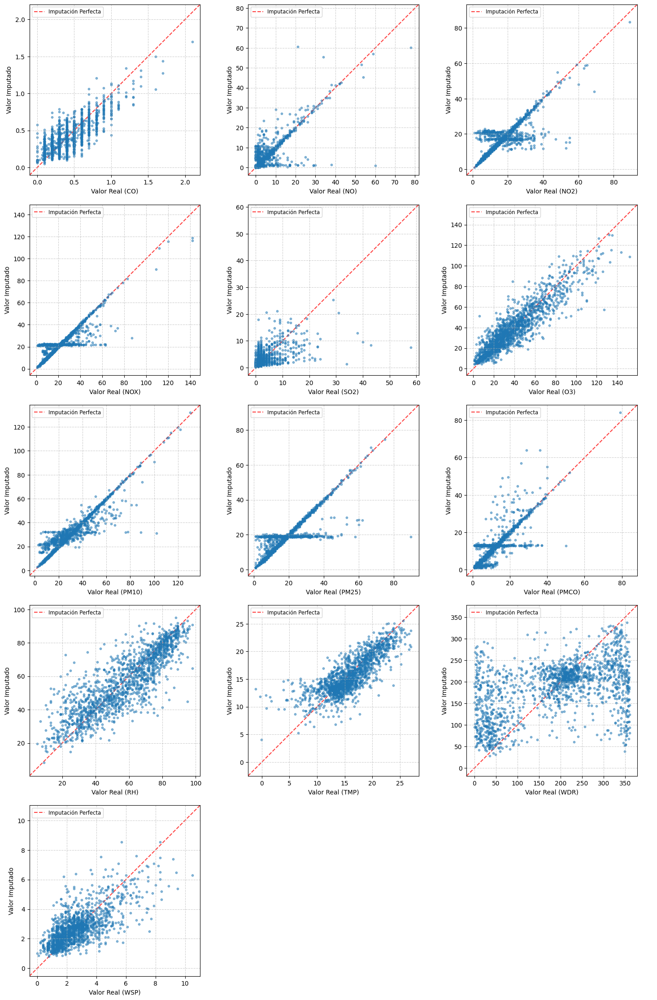


--- Imputando el DataFrame completo ---
[IterativeImputer] Completing matrix with shape (87648, 13)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.86
[IterativeImputer] Ending imputation round 2/10, elapsed time 1.66
[IterativeImputer] Ending imputation round 3/10, elapsed time 2.41
[IterativeImputer] Ending imputation round 4/10, elapsed time 3.13
[IterativeImputer] Ending imputation round 5/10, elapsed time 3.83
[IterativeImputer] Ending imputation round 6/10, elapsed time 4.54
[IterativeImputer] Ending imputation round 7/10, elapsed time 5.24
[IterativeImputer] Ending imputation round 8/10, elapsed time 5.98
[IterativeImputer] Ending imputation round 9/10, elapsed time 6.73
[IterativeImputer] Ending imputation round 10/10, elapsed time 7.44

DataFrame final imputado guardado en 'df_imputaciones_rf_random/df_imputado_rf_random_AJM.csv'

--- Análisis de Distribución Final con TOST y Wasserstein (Límite: 5%) ---

--- Tabla de Análisis de Distribución Final (TOST y Was

,Variable,Original_Mean,Imputed_Mean,Mean_Difference,TOST_Limit_±,p-value_Lower,p-value_Upper,Equivalent_(TOST),W-Dist_Relative(%)
0,Value_CO,0.399714,0.349078,0.050636,0.105,0.000000e+00,0.000000e+00,True,2.935001
1,Value_NO,4.427091,4.654681,-0.227589,4.800,0.000000e+00,0.000000e+00,True,1.889029
2,Value_NO2,16.981794,17.014557,-0.032764,5.300,0.000000e+00,0.000000e+00,True,2.679145
3,Value_NOX,21.419302,21.622971,-0.203669,7.250,0.000000e+00,0.000000e+00,True,2.908942
4,Value_SO2,3.021514,2.472660,0.548854,4.650,0.000000e+00,0.000000e+00,True,0.741108
5,Value_O3,41.022892,39.905088,1.117804,9.800,0.000000e+00,0.000000e+00,True,2.643208
6,Value_PM10,31.833579,31.917003,-0.083424,10.200,0.000000e+00,0.000000e+00,True,3.414402
7,Value_PM25,18.918411,18.878616,0.039795,6.300,0.000000e+00,0.000000e+00,True,3.430079
8,Value_PMCO,12.917656,12.908662,0.008994,8.700,0.000000e+00,0.000000e+00,True,1.936060
9,Value_RH,54.330322,51.914311,2.416010,4.900,0.000000e+00,8.537775e-119,True,4.875473


Resultados del análisis final guardados en 'df_imputaciones_rf_random/analisis_tost_final_rf_random_AJM.csv'

--- Generando Gráficos de Densidad (KDE) ---


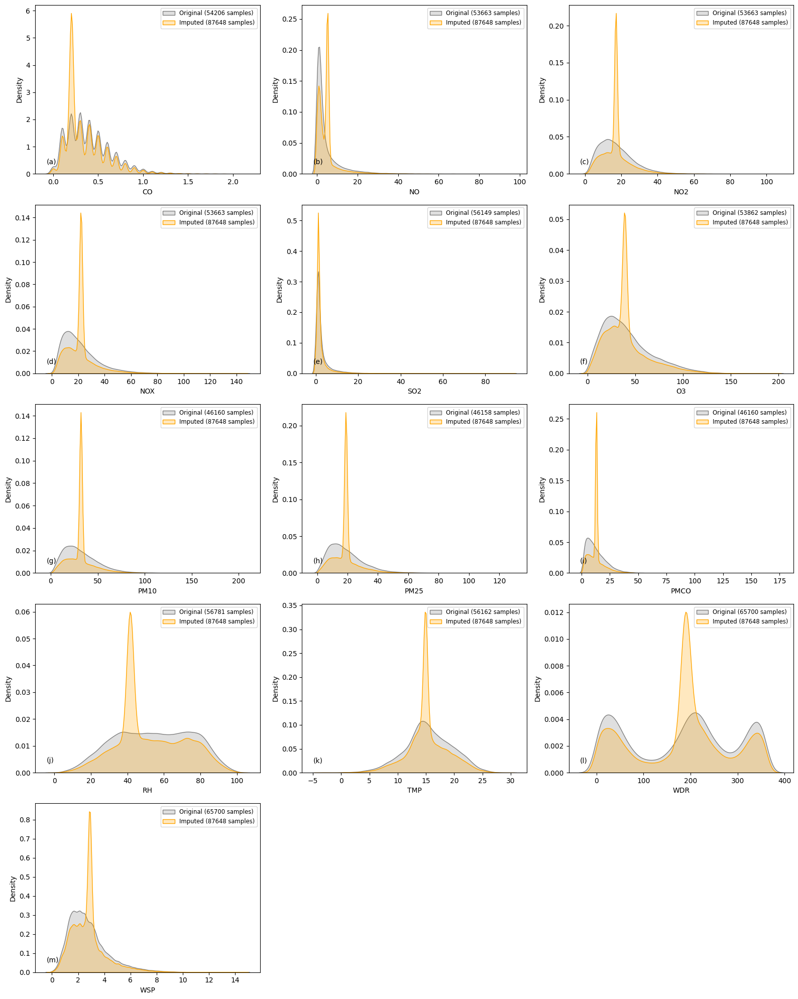


✅ Proceso de imputación y evaluación con Random Forest finalizado.


(                      date id_station  Value_CO  Value_NO  Value_NO2  \
 1        01-01-14 01:00:00        AJM       NaN       NaN        NaN   
 40       01-01-14 02:00:00        AJM       NaN       NaN        NaN   
 79       01-01-14 03:00:00        AJM       NaN       NaN        NaN   
 118      01-01-14 04:00:00        AJM       NaN       NaN        NaN   
 157      01-01-14 05:00:00        AJM       NaN       NaN        NaN   
 ...                    ...        ...       ...       ...        ...   
 3418078  31-12-23 19:00:00        AJM      0.30       0.0       16.0   
 3418117  31-12-23 20:00:00        AJM      0.37       0.0       18.0   
 3418156  31-12-23 21:00:00        AJM      0.27       0.0       16.0   
 3418195  31-12-23 22:00:00        AJM      0.57       1.0       26.0   
 3418234  31-12-23 23:00:00        AJM      0.49       0.0       21.0   
 
          Value_NOX  Value_SO2  Value_O3  Value_PM10  Value_PM25  Value_PMCO  \
 1              NaN        NaN       NaN  

In [6]:
# Llamada a  funcion de Imputacion de Random Forest
imputar_y_evaluar_con_rf(df_ajm)

# Cargar DataFrame de las Imputaciones BRITS Y RANDOM FOREST 

In [ ]:
#Cargar DataFrame de las Imputaciones BRITS Y RANDOM FOREST 
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', "cua", 'sfe', 'ajm']

# Cargar archivos imputados por BRITS
df_imputado_brits = {
    est: pd.read_csv(f"df_imputaciones_brits_random/df_imputado_random_{est}.csv")
    for est in estaciones
}

# Cargar archivos imputados por Random Forest
df_imputado_rf = {
    est: pd.read_csv(f"df_imputaciones_rf_random/df_imputado_rf_random_{est.upper()}.csv")
    for est in estaciones
}

# Creacion de graficos KDE  de todas las estaciones 

In [24]:
#Graficos KDE de todas las Estaciones
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

def analisis_distribucion_kde_comparativo(df_original, df_imputado_rf, df_imputado_brits, station_name):
    """
    Genera una figura consolidada con gráficos de densidad (KDE) para comparar
    el DataFrame original con las imputaciones de RF y BRITS
    """
    print(f"\n--- Generando Gráficos de Densidad Comparativos para la Estación {station_name} ---")
    
    numeric_cols = df_original.select_dtypes(include=np.number).columns
    
    n_vars = len(numeric_cols)
    if n_vars == 0:
        print("No se encontraron columnas numéricas para graficar.")
        return

    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, n_rows * 4))
    axes = axes.flatten()

    for i, col in enumerate(numeric_cols):
        ax = axes[i]
        
        
        sns.kdeplot(df_original[col].dropna(), label='Original', color="#0a4f86", fill=True, alpha=0.3, linewidth=0, ax=ax)
        sns.kdeplot(df_imputado_rf[col], label='Imputed RF', color="black", linestyle='--', ax=ax)
        if df_imputado_brits is not None:
            sns.kdeplot(df_imputado_brits[col], label='Imputed BRITS', color='#e41a1c', linestyle='--', ax=ax)
        
        
        if ax.get_legend():
            ax.get_legend().remove()
            
      
        ax.set_title("")
        ax.set_xlabel(col.replace('Value_', ''))
        ax.set_ylabel("Density")
        ax.grid(False)
        ax.text(0.95, 0.03, f'({chr(97 + i)})', transform=ax.transAxes, ha='right', va='bottom', fontweight='bold')

   
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

   
    handles, labels = axes[0].get_legend_handles_labels()


    fig.legend(
        handles,
        labels,
        loc='lower left', 
        bbox_to_anchor=(0.7, 0.01), 
        ncol=len(labels), 
        frameon=True,
        fontsize='large'
    )

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    
    plt.savefig(f"imagenes_KDE_random/kde_comparison_all_models_{station_name}.png", dpi=600)
    plt.show()


--- Generando Gráficos de Densidad Comparativos para la Estación MER ---


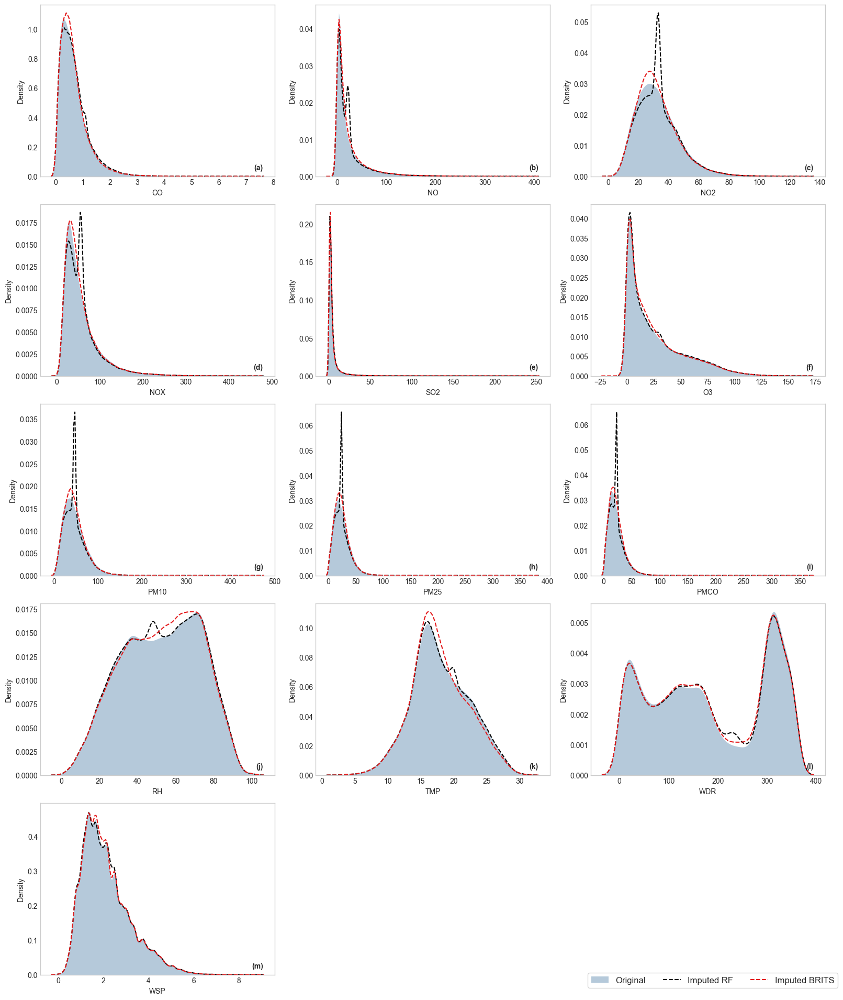


--- Generando Gráficos de Densidad Comparativos para la Estación TLA ---


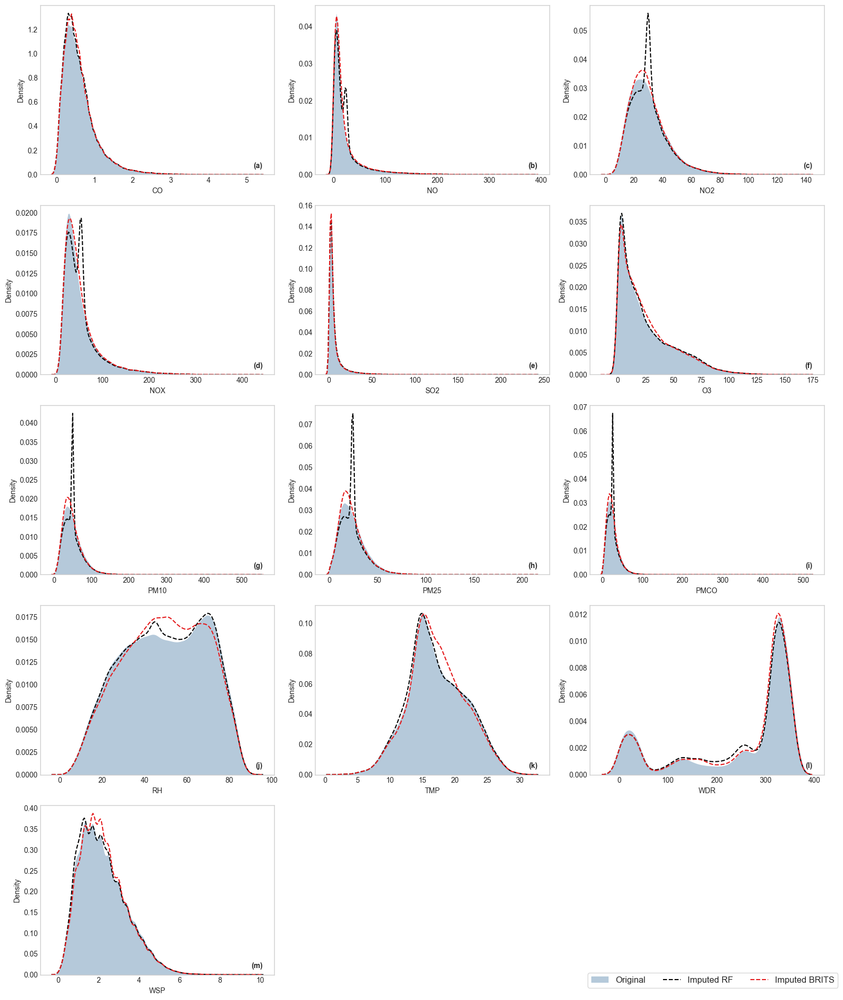


--- Generando Gráficos de Densidad Comparativos para la Estación SAG ---


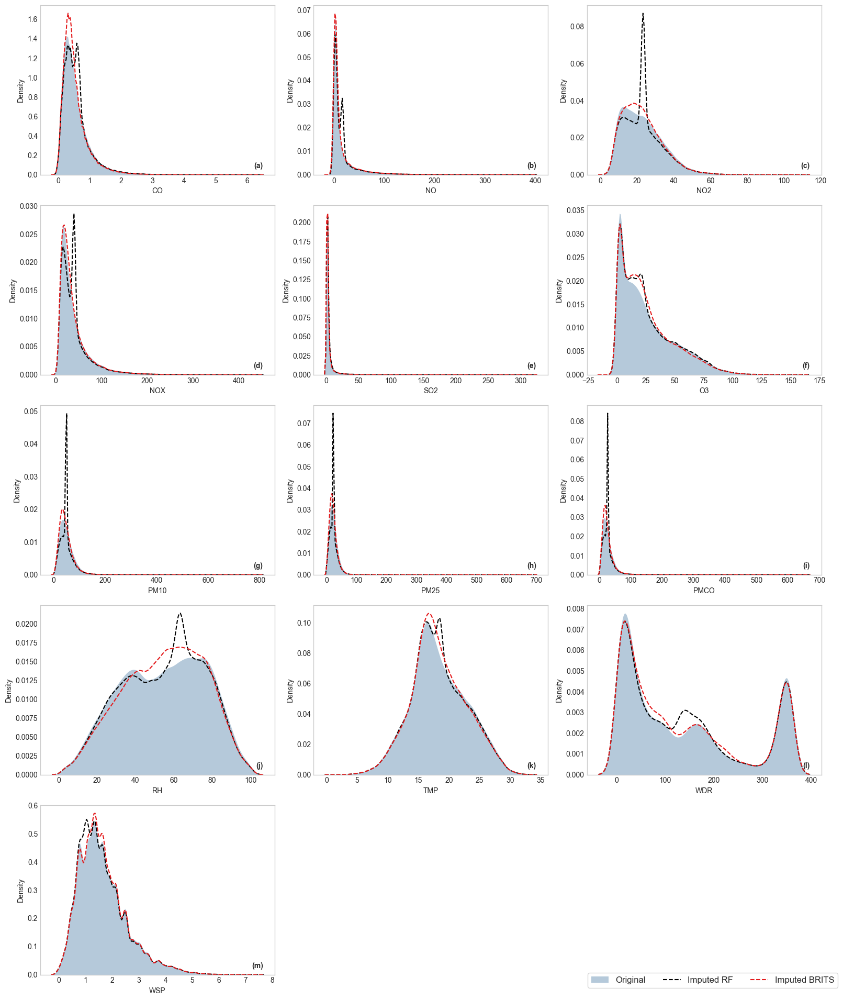


--- Generando Gráficos de Densidad Comparativos para la Estación UAX ---


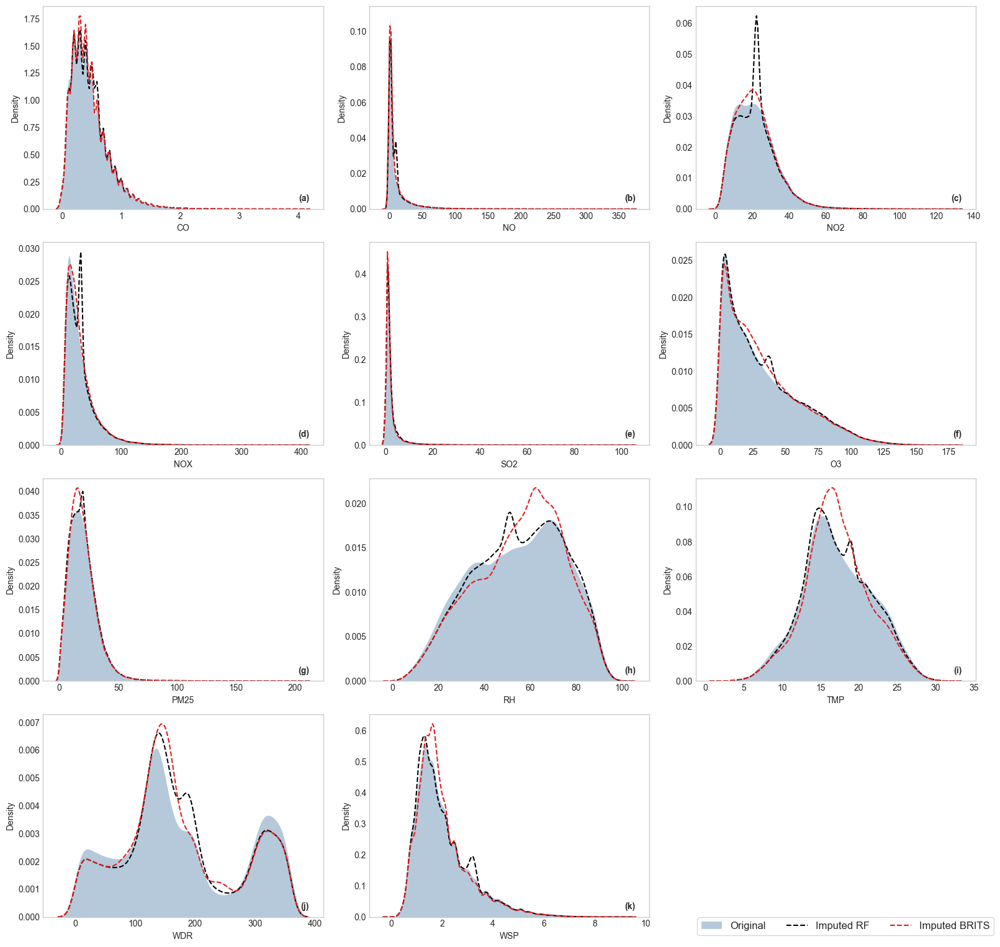


--- Generando Gráficos de Densidad Comparativos para la Estación FAC ---


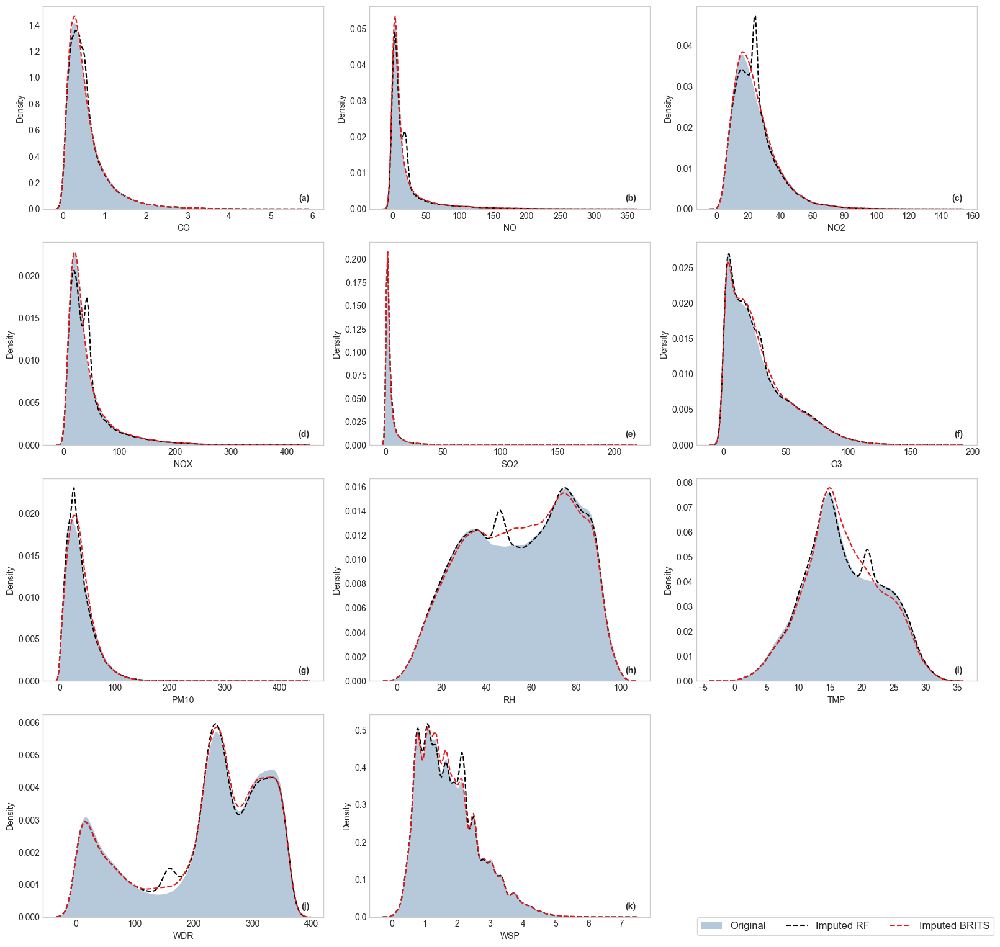


--- Generando Gráficos de Densidad Comparativos para la Estación NEZ ---


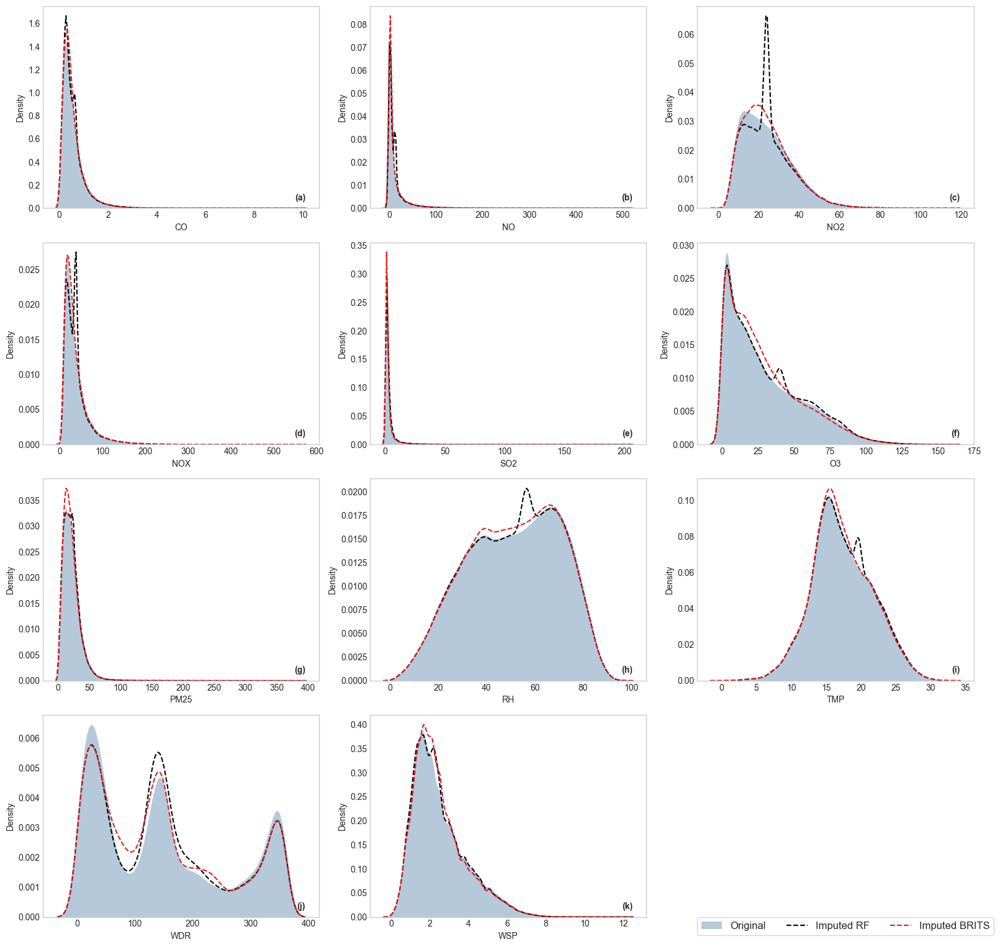


--- Generando Gráficos de Densidad Comparativos para la Estación PED ---


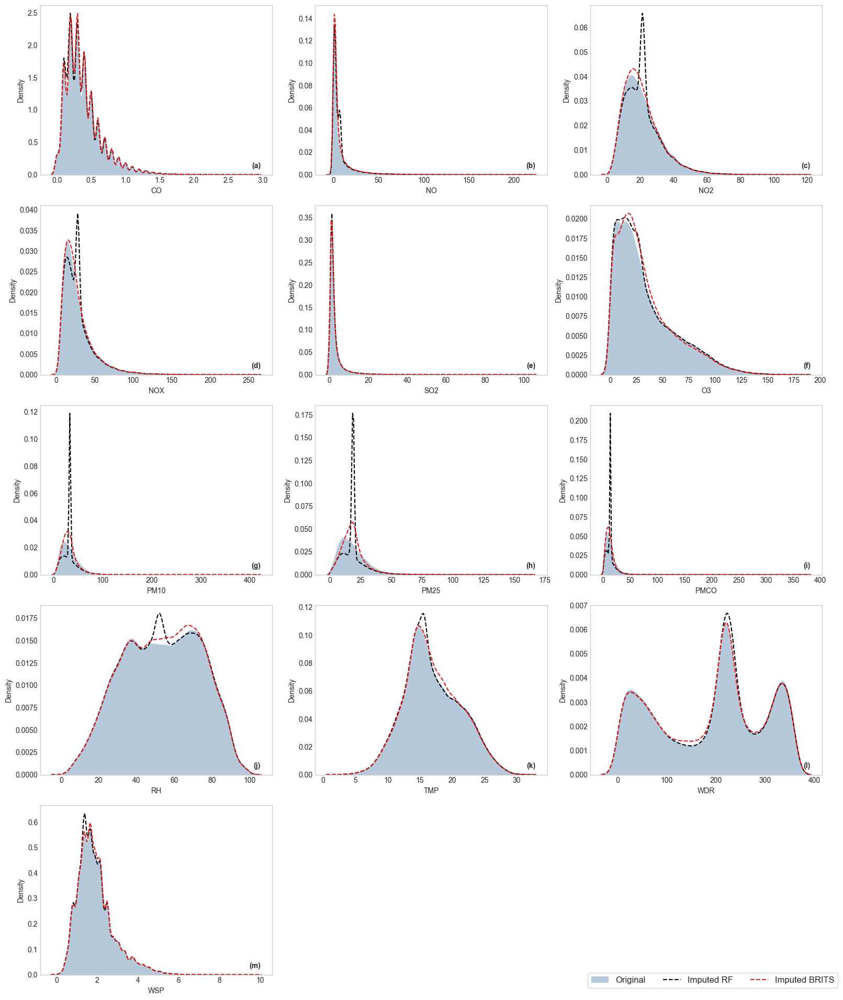


--- Generando Gráficos de Densidad Comparativos para la Estación VIF ---


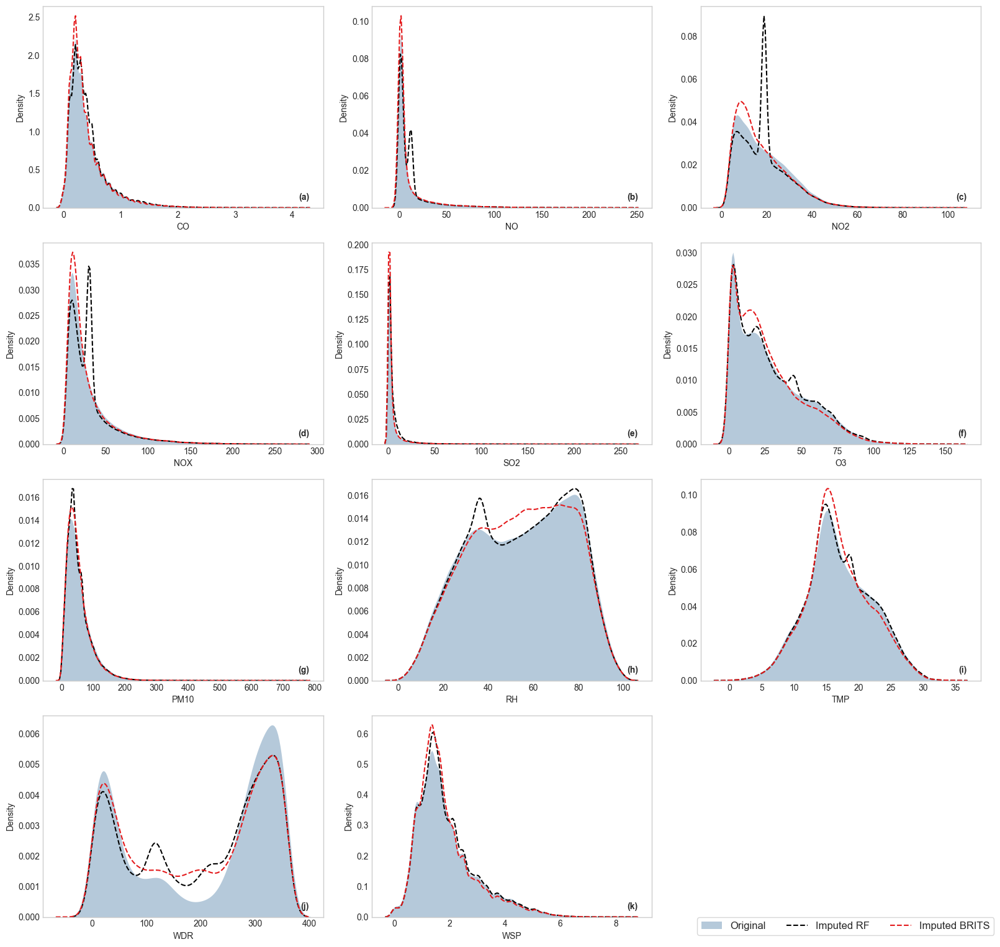


--- Generando Gráficos de Densidad Comparativos para la Estación MGH ---


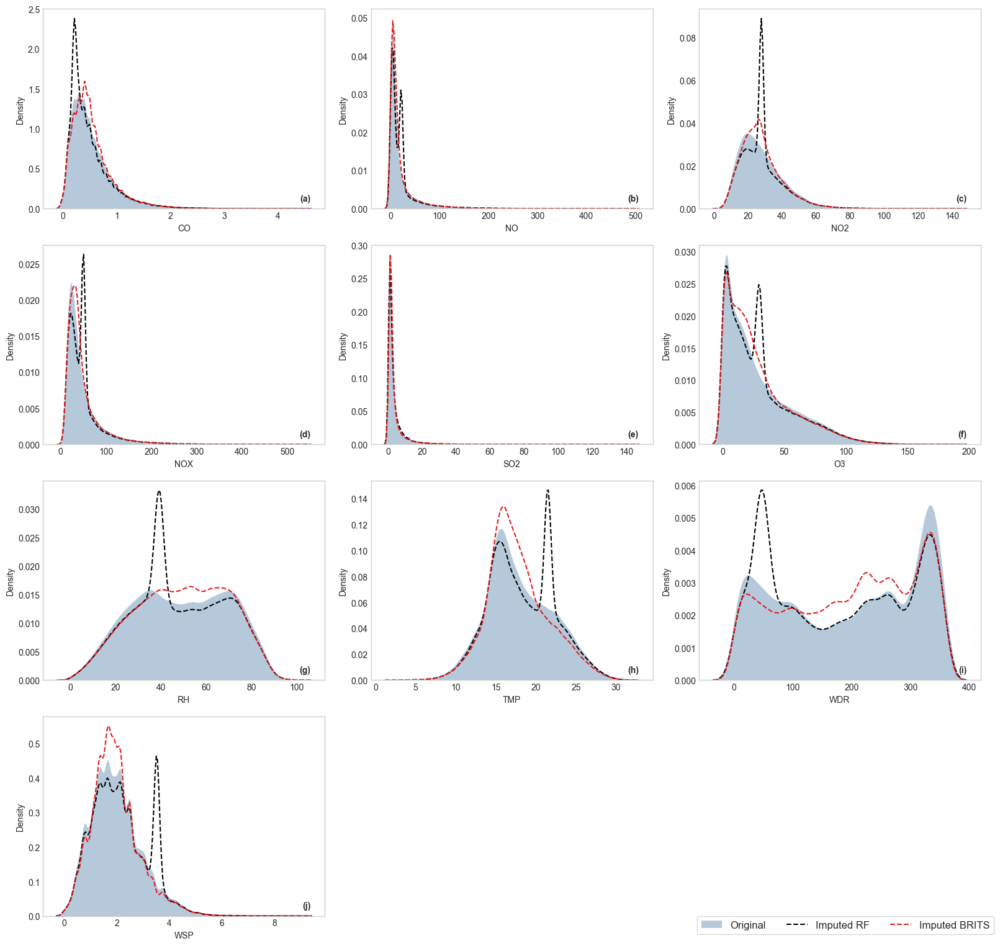


--- Generando Gráficos de Densidad Comparativos para la Estación CUA ---


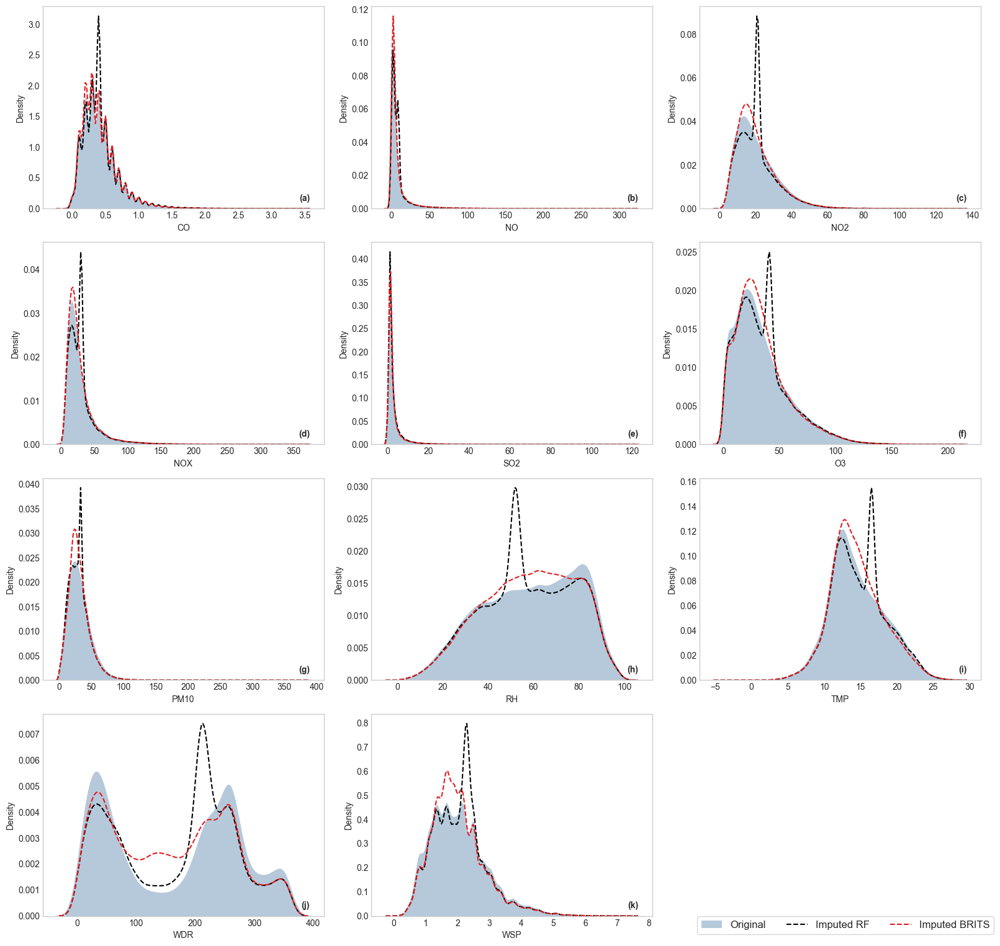


--- Generando Gráficos de Densidad Comparativos para la Estación SFE ---


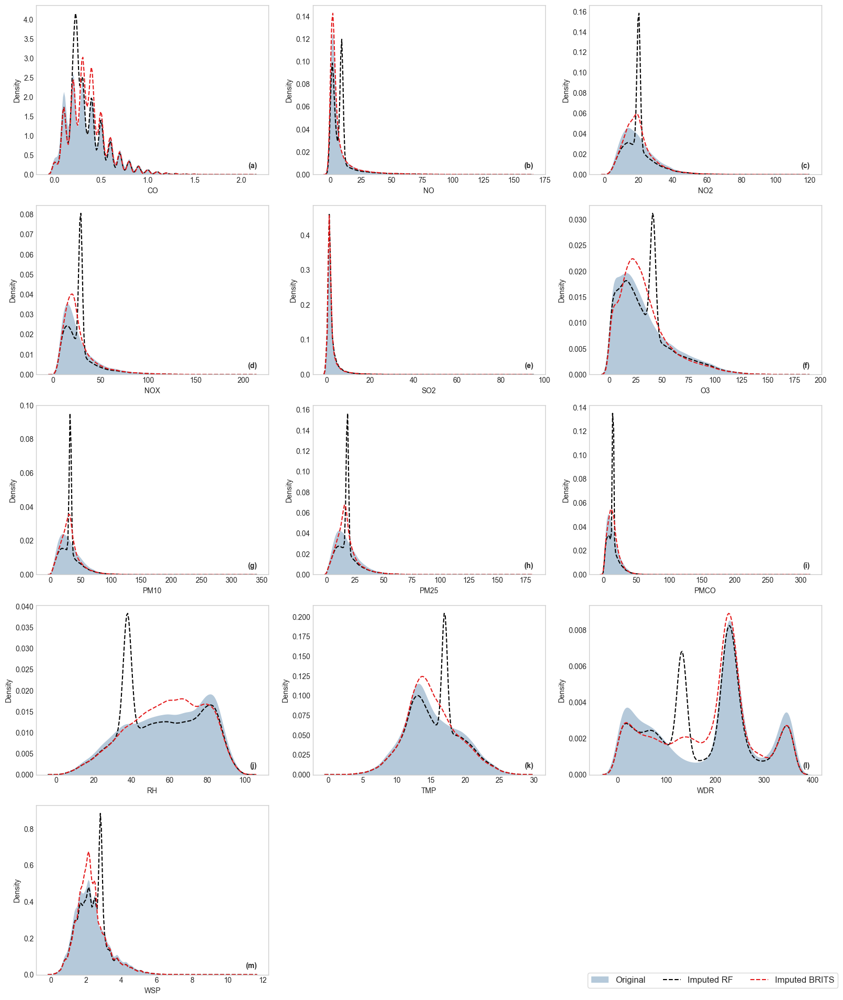


--- Generando Gráficos de Densidad Comparativos para la Estación AJM ---


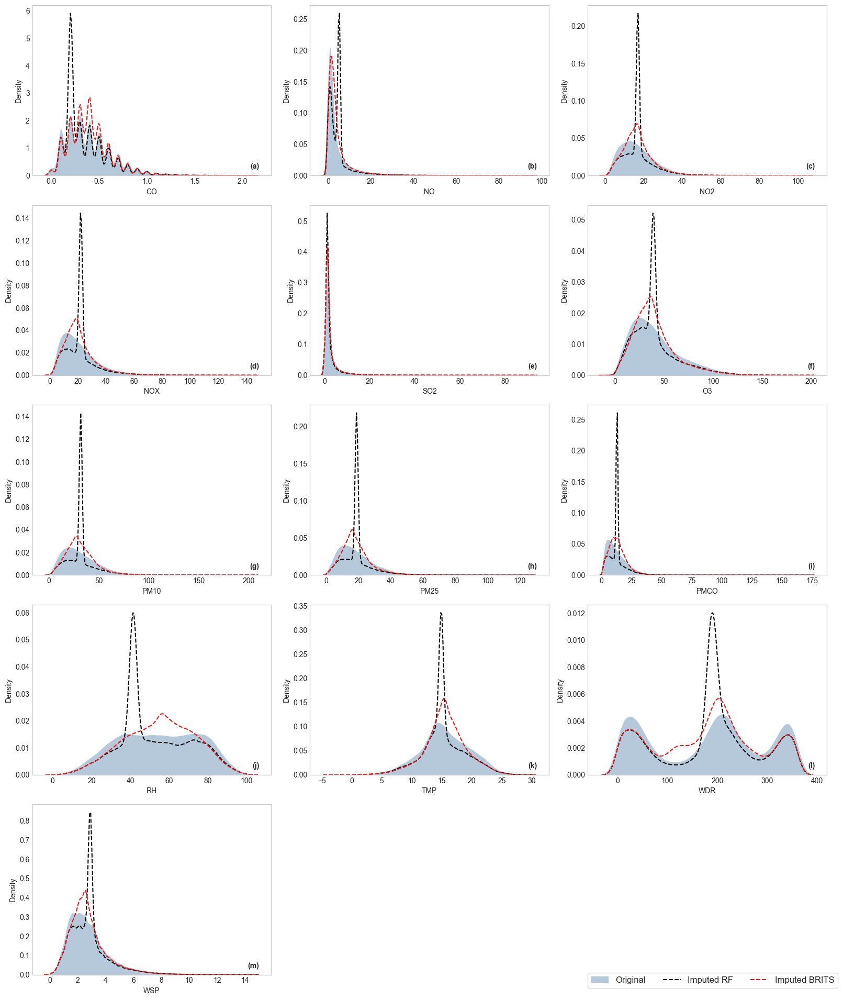

In [25]:
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua' , 'sfe', 'ajm']

# diccionario con los DataFrames originales
dfs = {
    "mer": df_mer,
    "tla": df_tla,
    "sag": df_sag,
    "uax": df_uax,
    "fac": df_fac,
    "nez": df_nez,
    "ped": df_ped,
    "vif": df_vif,
    "mgh": df_mgh,
    "cua": df_cua,
    "sfe": df_sfe,
    "ajm": df_ajm
}

for station in estaciones:
    # Imputaciones
    df_imputado_rf = pd.read_csv(f"df_imputaciones_rf_random/df_imputado_rf_random_{station.upper()}.csv")
    df_imputado_brits = pd.read_csv(f"df_imputaciones_brits_random/df_imputado_random_{station}.csv")


    df_original = dfs[station]


    analisis_distribucion_kde_comparativo(
        df_original,
        df_imputado_rf,
        df_imputado_brits,
        station.upper()      
    )


# Series de tiempo 

In [26]:
# Series tiempo original vs imputado 

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os
from matplotlib.lines import Line2D 

def plot_series_comparison(df_original, df_imputado, date_column_name, model_name, station_name=""):

    print(f"\n---  Generando Gráficos de Series de Tiempo: Estación {station_name} (Modelo: {model_name}) ---")

    df_obs = df_original.copy()
    df_imp = df_imputado.copy()

    
    for df, name in [(df_obs, 'original'), (df_imp, 'imputed')]:
        if date_column_name not in df.columns:
            print(f"Error: La columna de fecha '{date_column_name}' no se encuentra en el DataFrame {name}.")
            return
        try:
           
            df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
            
           
            if df[date_column_name].isnull().all():
                print(f"Error Crítico: No se pudo convertir ninguna fecha en la columna '{date_column_name}' del DataFrame {name}.")
                print("Por favor, revisa el formato de las fechas en tu archivo CSV. Deberían ser consistentes (ej. YYYY-MM-DD HH:MM:SS).")
                return

            df.set_index(date_column_name, inplace=True)
            df.sort_index(inplace=True)

        except Exception as e:
            print(f"Error al procesar la columna de fecha para el DataFrame {name}: {e}")
            return

    
    original_cols = df_original.select_dtypes(include=np.number).columns
    imputed_cols = df_imputado.select_dtypes(include=np.number).columns
    all_columns = original_cols.intersection(imputed_cols)

    if 'id_station' in all_columns:
        all_columns = all_columns.drop('id_station')

    
    unidades = {
        'Value_O3': 'ppb', 'Value_PM10': 'µg/m³', 'Value_PM25': 'µg/m³',
        'Value_CO': 'ppm', 'Value_NO': 'ppb', 'Value_NO2': 'ppb',
        'Value_NOX': 'ppb', 'Value_SO2': 'ppb', 'Value_RH': '%',
        'Value_TMP': '°C', 'Value_WDR': 'Azimuth', 'Value_WSP': 'km/h',
        'Value_PMCO': 'ppb'
    }

    
    n_vars = len(all_columns)
    if n_vars == 0:
        print("No se encontraron columnas numéricas comunes para graficar.")
        return

    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 3.5), sharex=False)

    if n_vars == 1:
        axes = np.array([axes])
    axes = axes.flatten()

    
    for i, col in enumerate(all_columns):
        ax = axes[i]

        
        ax.plot(df_imp.index, df_imp[col], color='orange', linewidth=1.2, label=f'{model_name} Imputed')
        ax.plot(df_obs.index, df_obs[col], color='#007ACC', linewidth=1.0, label='Original')

        variable_name = col.replace('Value_', '')
        unit = unidades.get(col, '')
        ax.set_ylabel(f"{variable_name} ({unit})", fontsize=12)
        
        ax.set_xlabel("Date", fontsize=12)
        
        ax.grid(True, which='major', linestyle='--', linewidth=0.5)

        ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.setp(ax.get_xticklabels(), rotation=0, ha="center")

       
        ax.text(0.98, 0.02, f'({chr(97 + i)})',
                transform=ax.transAxes,
                ha='right',
                va='bottom',
                fontweight='bold',
                bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', pad=1.5))
        
        
        if ax.get_legend():
            ax.get_legend().remove()

    
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    
    legend_ax = axes[-1]
    legend_ax.spines[:].set_visible(False)
    legend_ax.tick_params(left=False, right=False, top=False, bottom=False, labelleft=False, labelbottom=False)
    
    legend_elements = [
        Line2D([0], [0], color='#007ACC', lw=2, label='Original'),
        Line2D([0], [0], color='orange', lw=2, label=f'{model_name} Imputed')
    ]
    legend_ax.legend(handles=legend_elements, loc='center', fontsize=14, frameon=True)
    plt.tight_layout()

    # gurdado de la imagen
    output_dir = 'series_tiempo_random'
    os.makedirs(output_dir, exist_ok=True)
    
    output_filename = f"{output_dir}/serie_{station_name}_{model_name}.png"
    
    plt.savefig(output_filename, dpi=600)
    print(f"Gráfico guardado en: {output_filename}")
    
    plt.show()



---  Generando Gráficos de Series de Tiempo: Estación MER (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_MER_RF.png


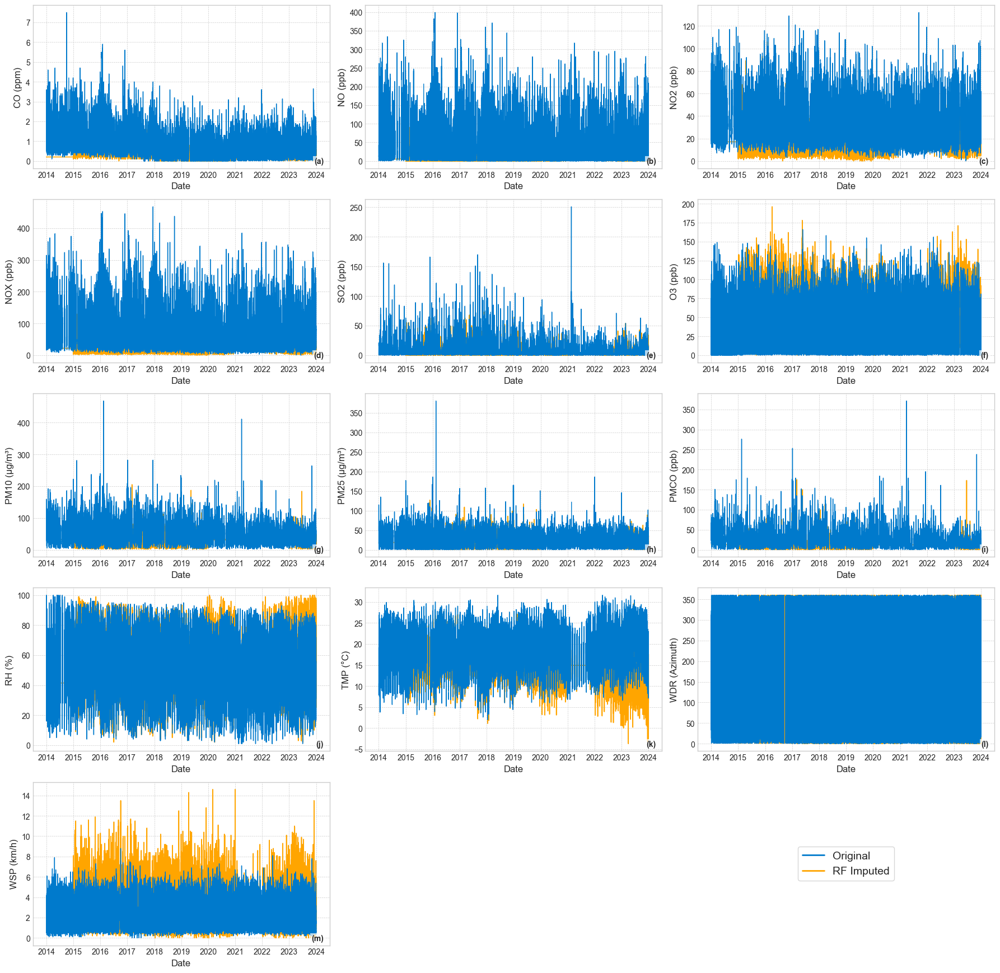


---  Generando Gráficos de Series de Tiempo: Estación MER (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_MER_BRITS.png


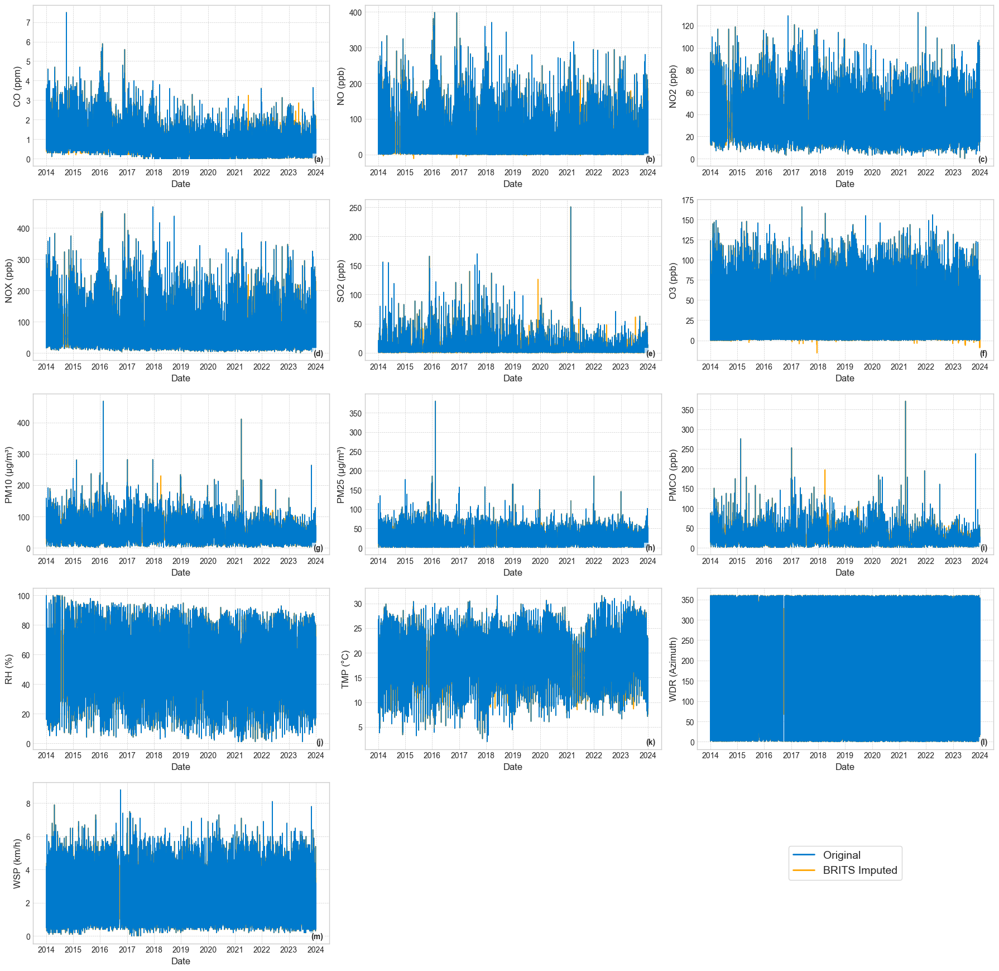


---  Generando Gráficos de Series de Tiempo: Estación TLA (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_TLA_RF.png


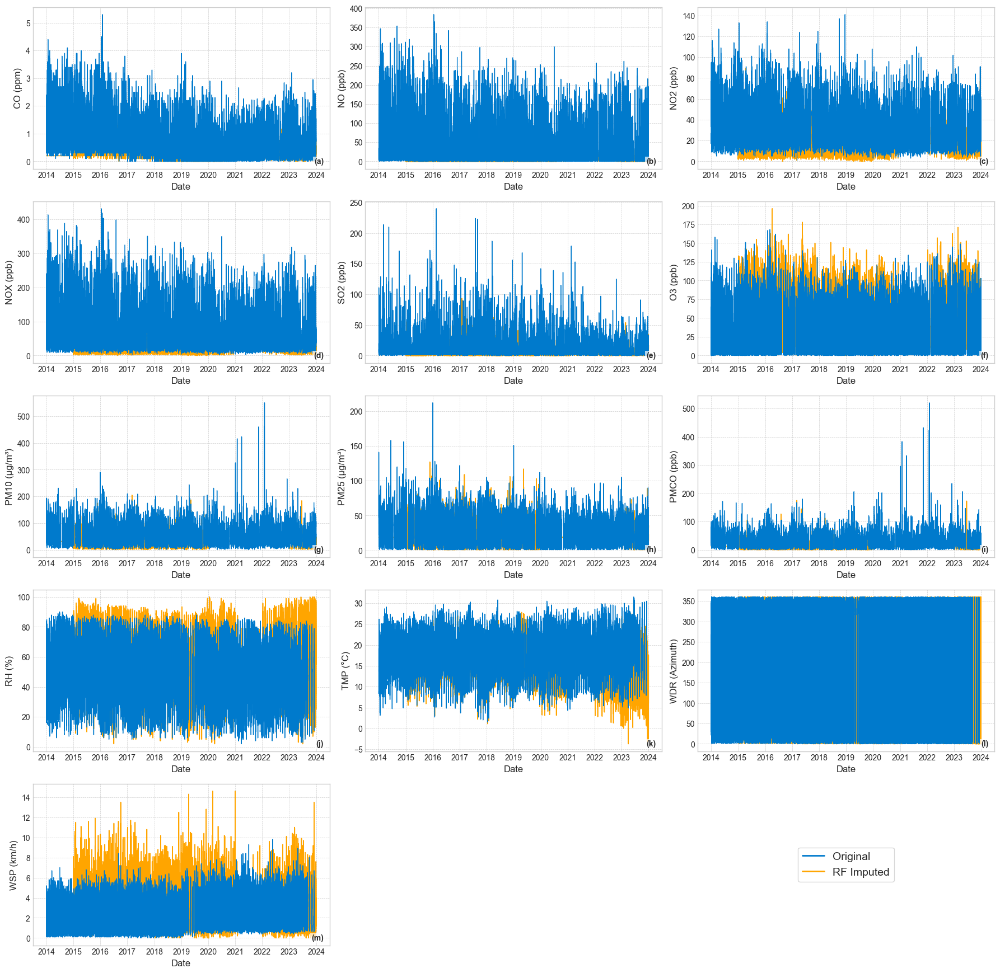


---  Generando Gráficos de Series de Tiempo: Estación TLA (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_TLA_BRITS.png


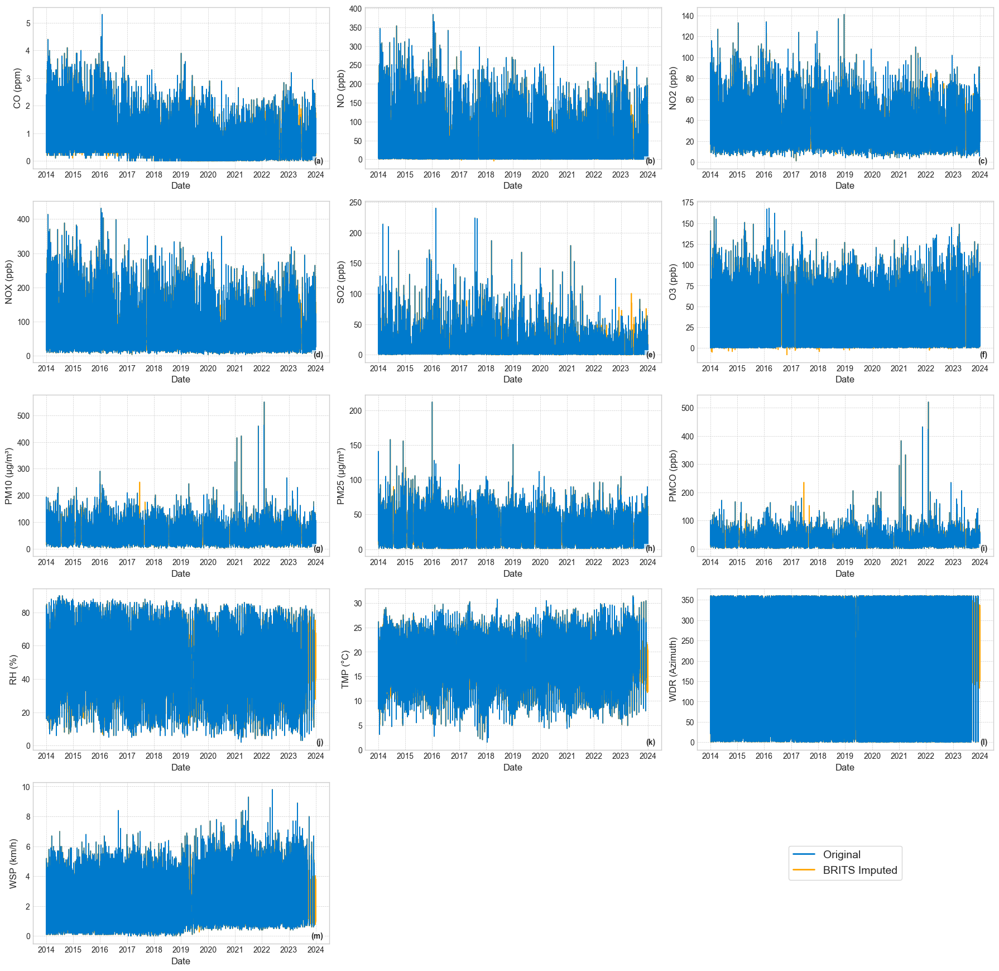


---  Generando Gráficos de Series de Tiempo: Estación SAG (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_SAG_RF.png


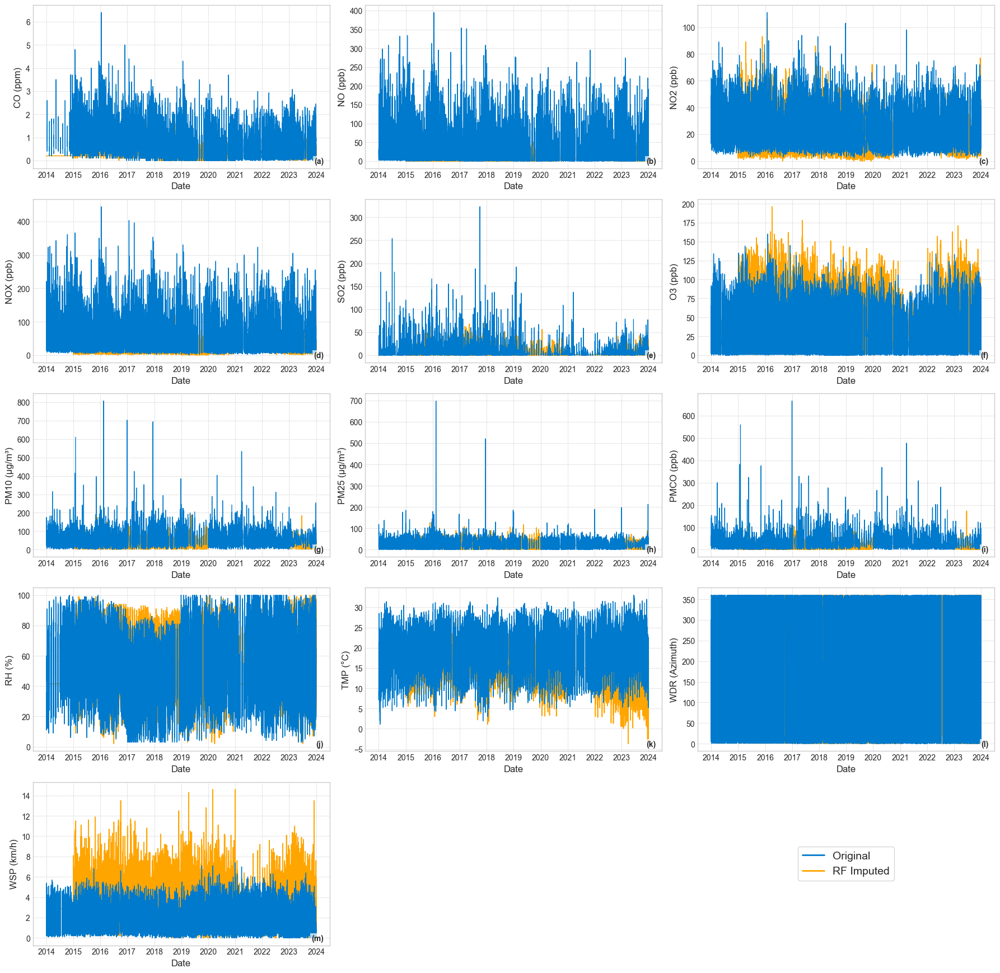


---  Generando Gráficos de Series de Tiempo: Estación SAG (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_SAG_BRITS.png


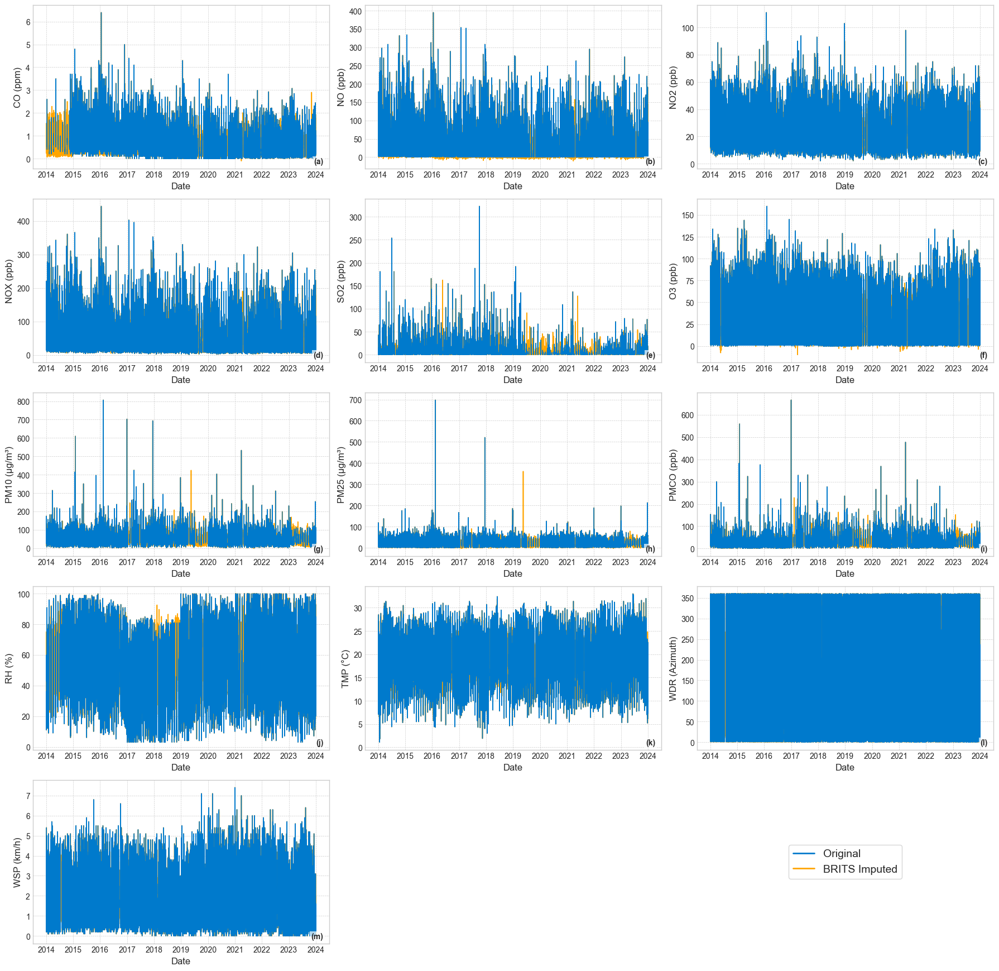


---  Generando Gráficos de Series de Tiempo: Estación UAX (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_UAX_RF.png


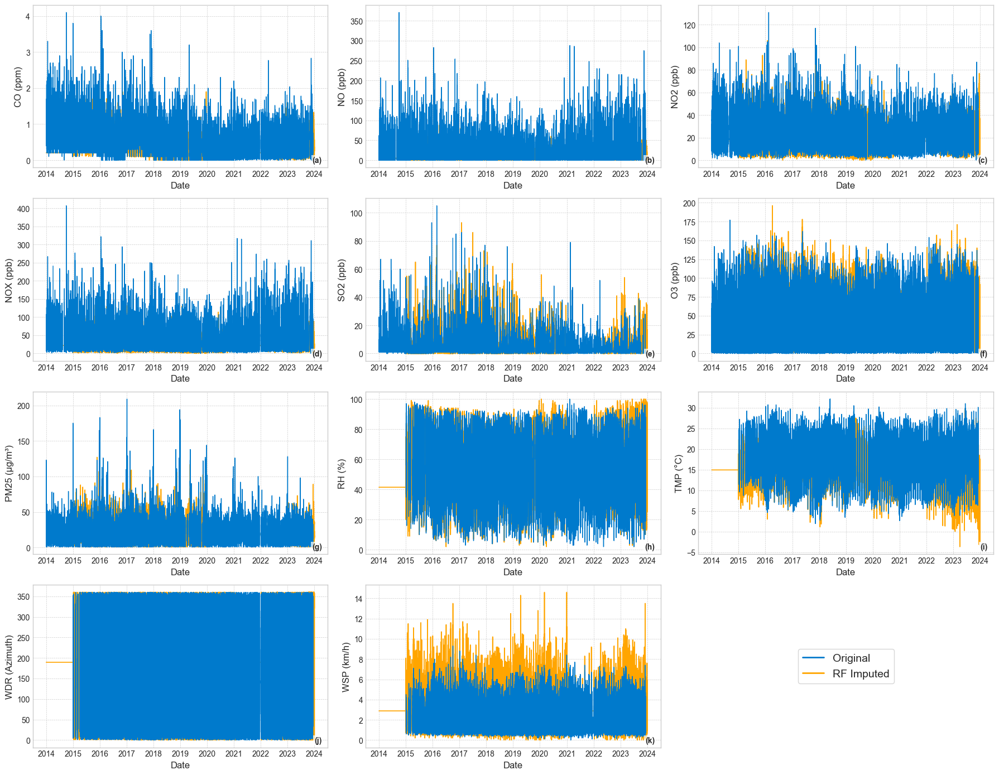


---  Generando Gráficos de Series de Tiempo: Estación UAX (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_UAX_BRITS.png


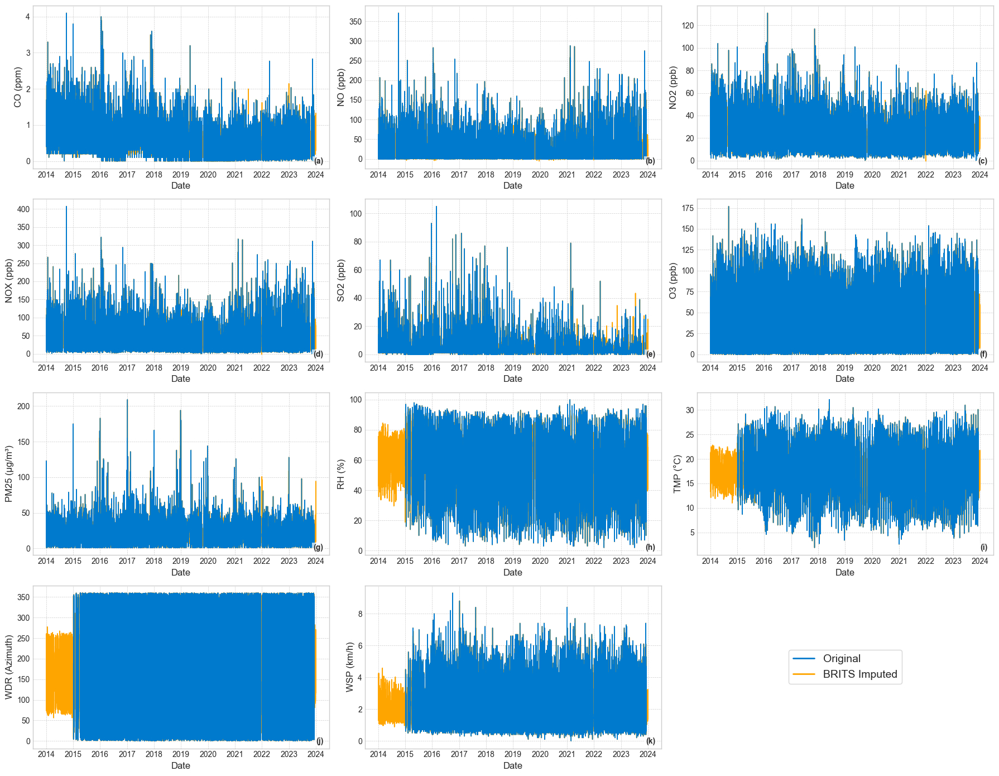


---  Generando Gráficos de Series de Tiempo: Estación FAC (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_FAC_RF.png


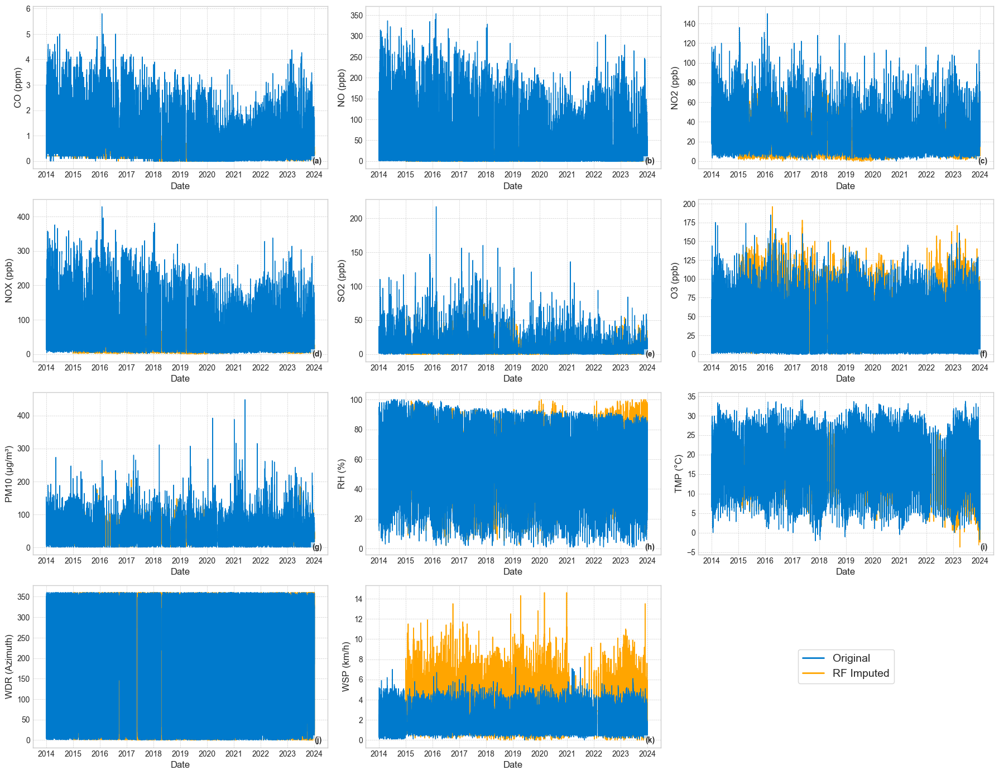


---  Generando Gráficos de Series de Tiempo: Estación FAC (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_FAC_BRITS.png


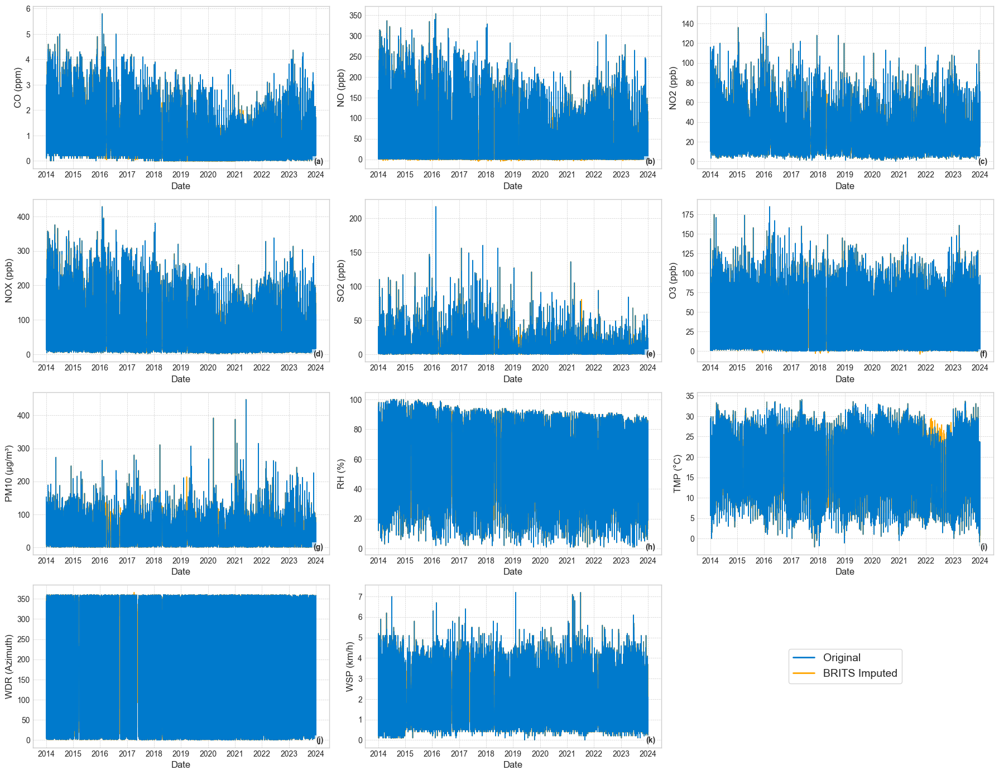


---  Generando Gráficos de Series de Tiempo: Estación NEZ (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_NEZ_RF.png


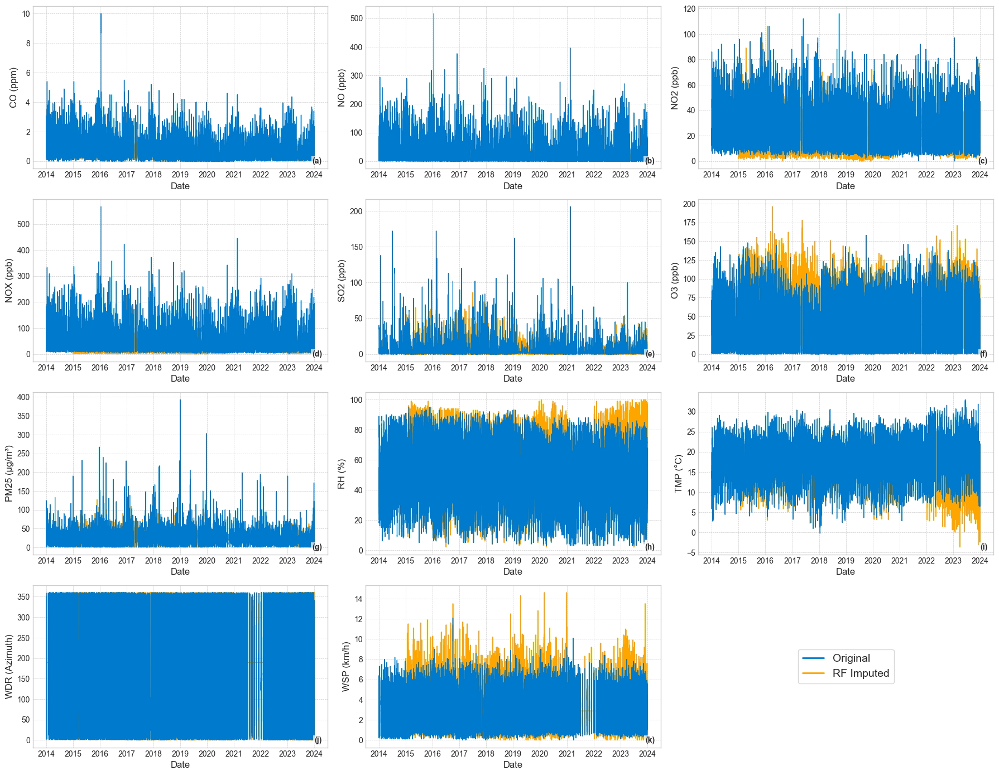


---  Generando Gráficos de Series de Tiempo: Estación NEZ (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_NEZ_BRITS.png


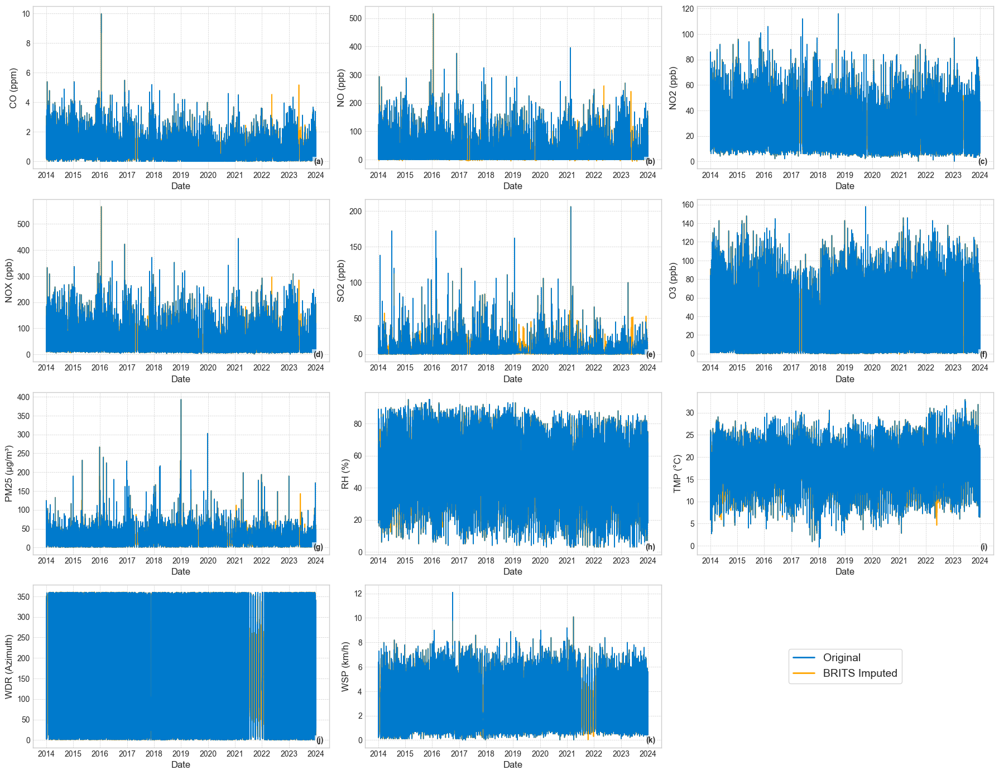


---  Generando Gráficos de Series de Tiempo: Estación PED (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_PED_RF.png


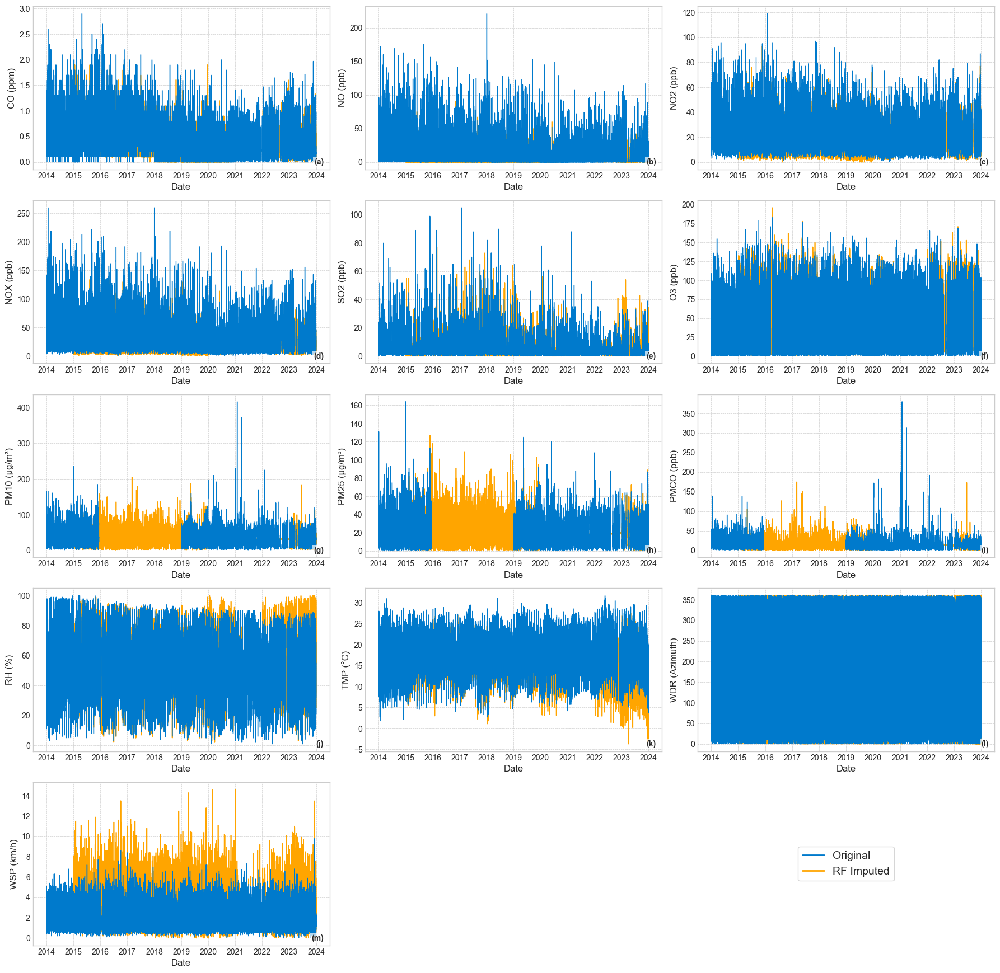


---  Generando Gráficos de Series de Tiempo: Estación PED (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_PED_BRITS.png


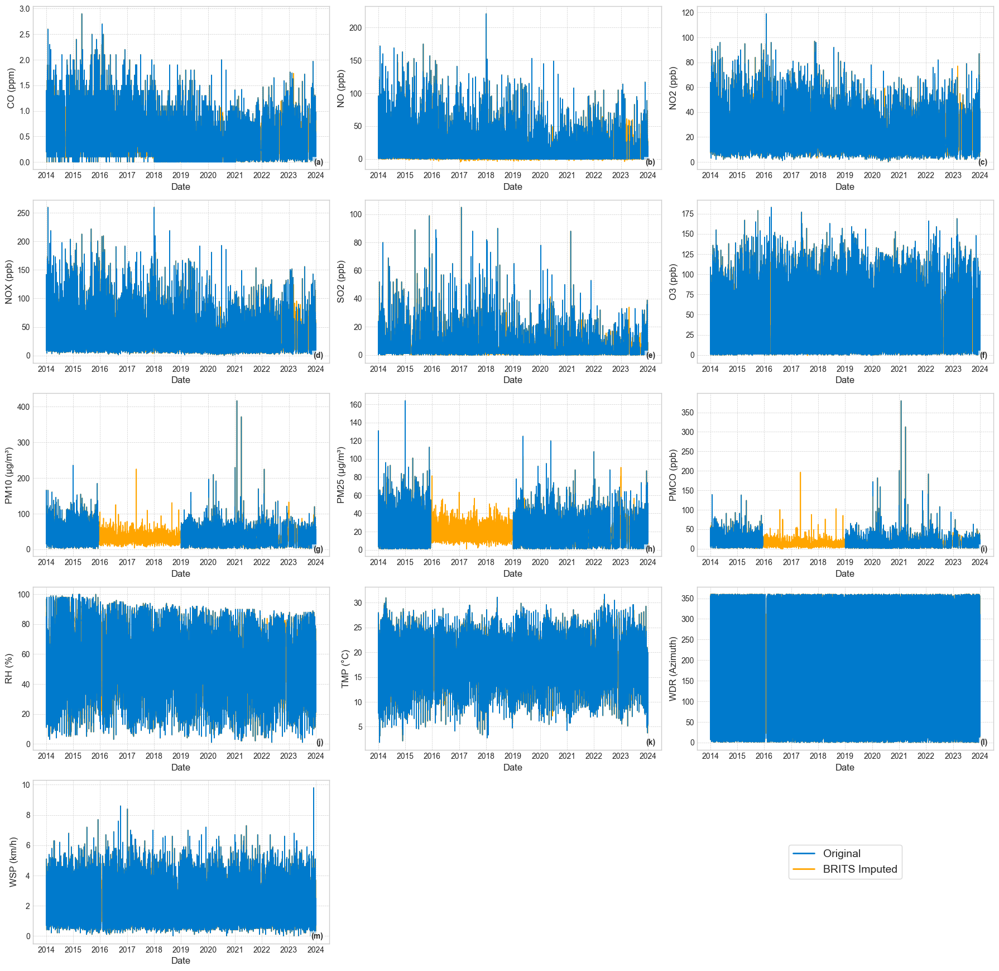


---  Generando Gráficos de Series de Tiempo: Estación VIF (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_VIF_RF.png


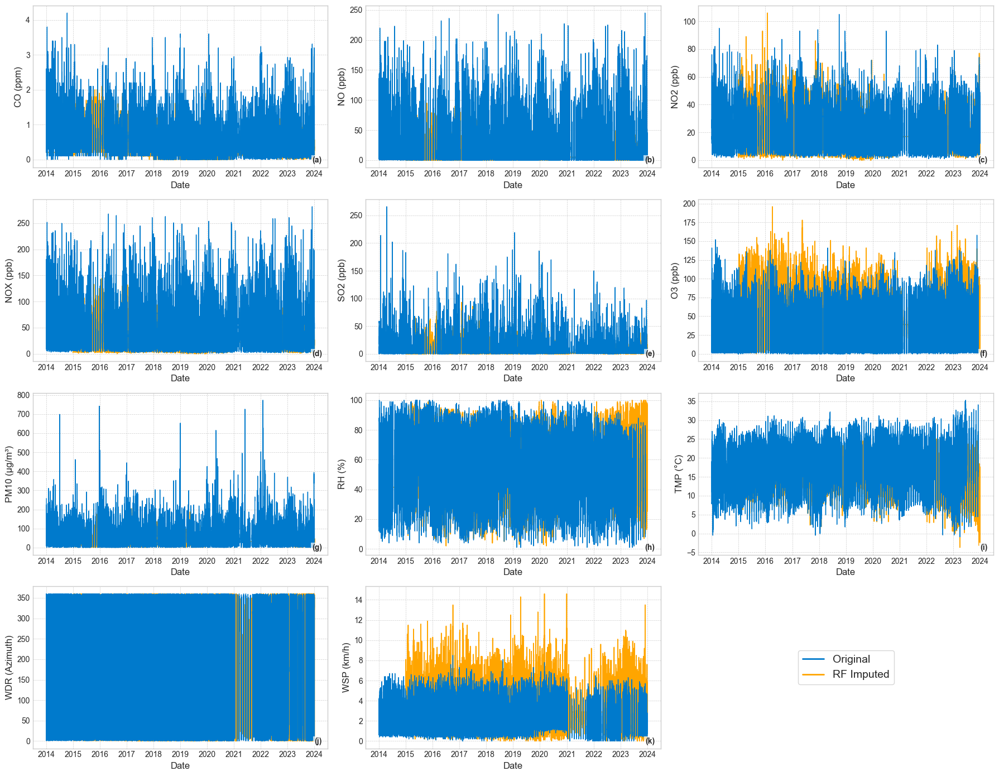


---  Generando Gráficos de Series de Tiempo: Estación VIF (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_VIF_BRITS.png


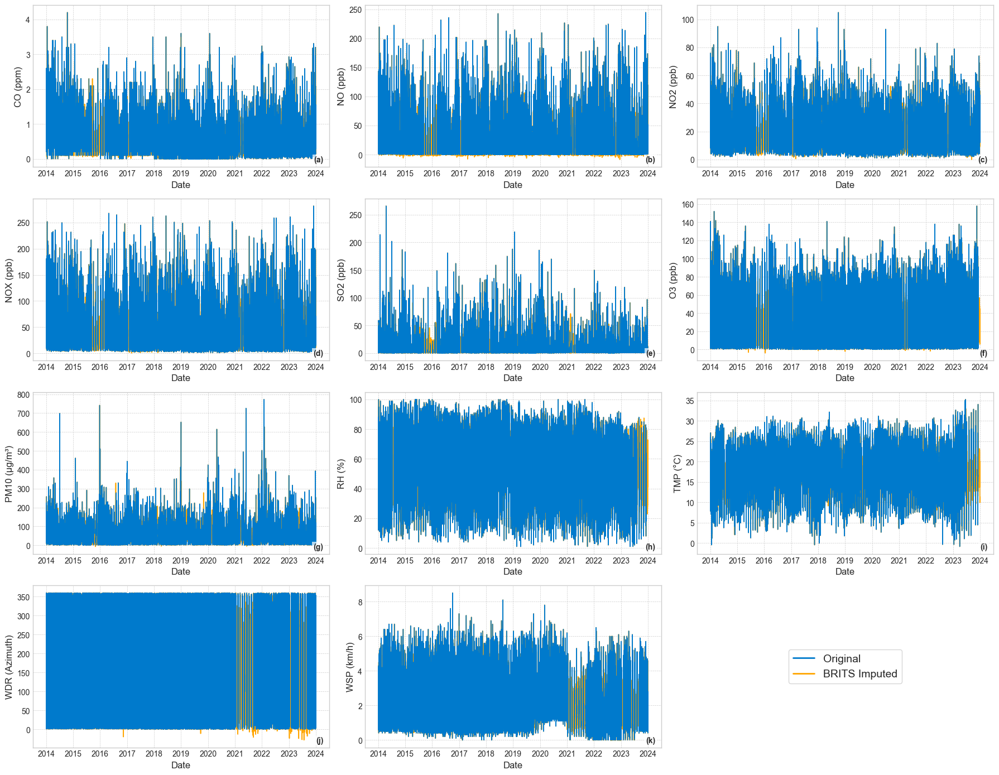


---  Generando Gráficos de Series de Tiempo: Estación MGH (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_MGH_RF.png


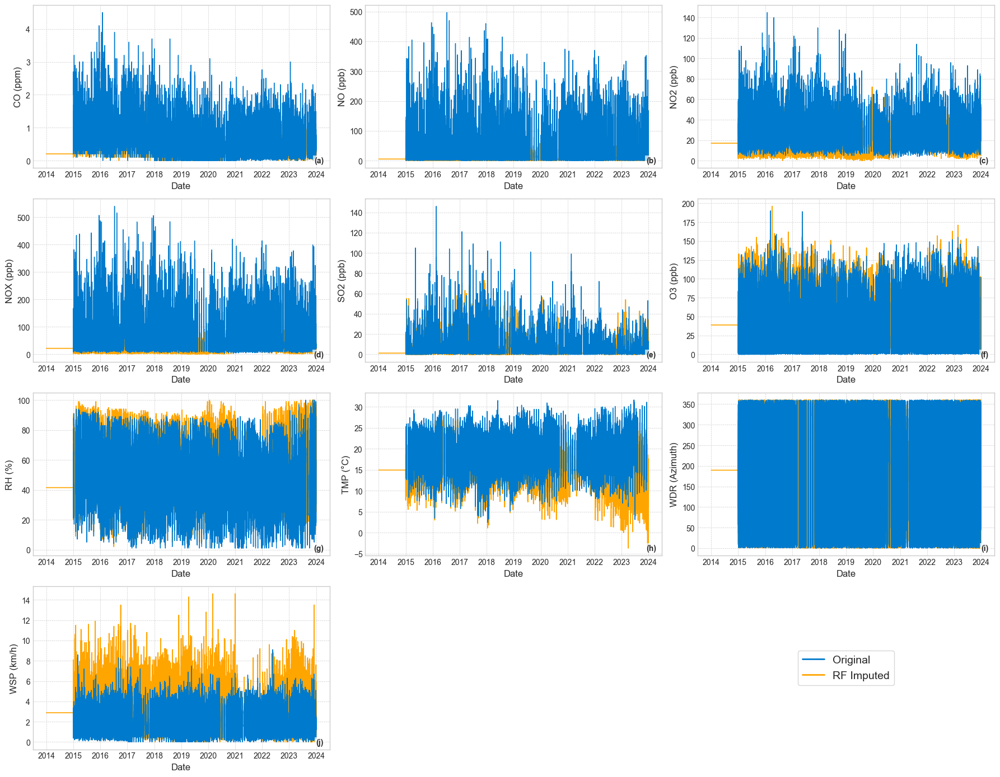


---  Generando Gráficos de Series de Tiempo: Estación MGH (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_MGH_BRITS.png


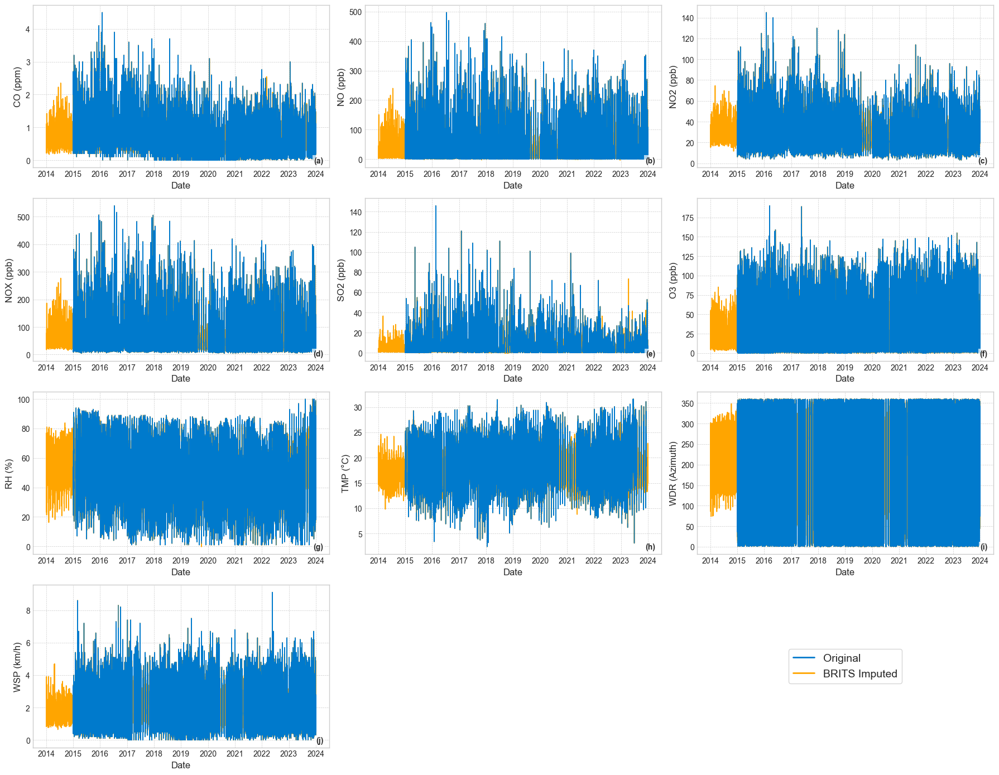


---  Generando Gráficos de Series de Tiempo: Estación CUA (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_CUA_RF.png


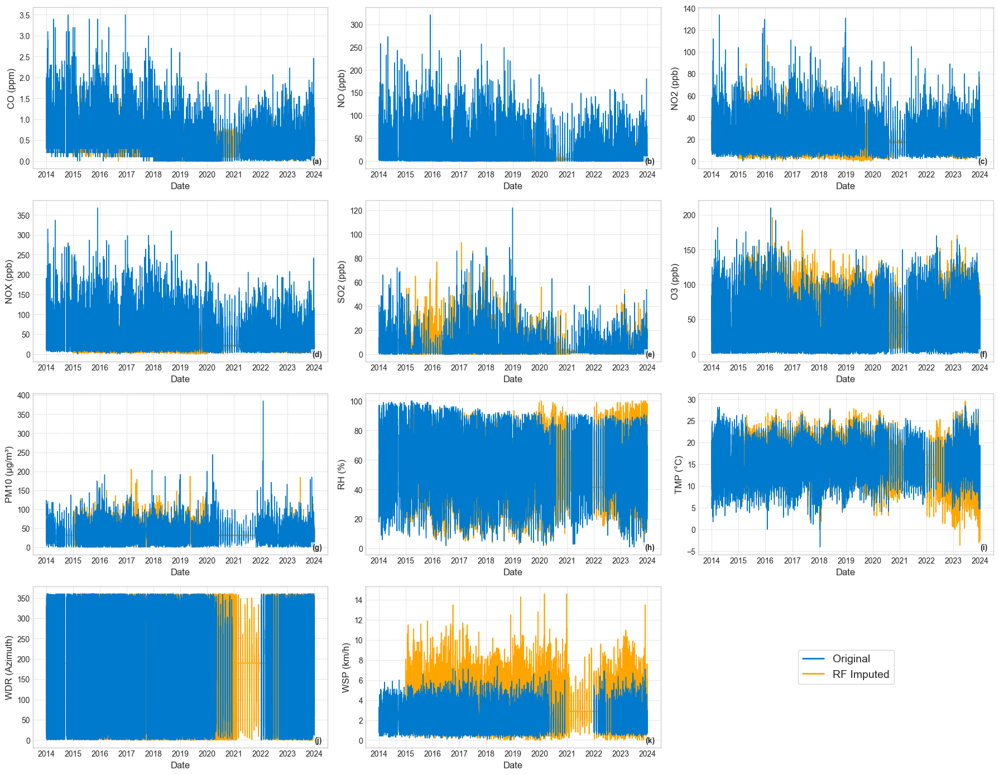


---  Generando Gráficos de Series de Tiempo: Estación CUA (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_CUA_BRITS.png


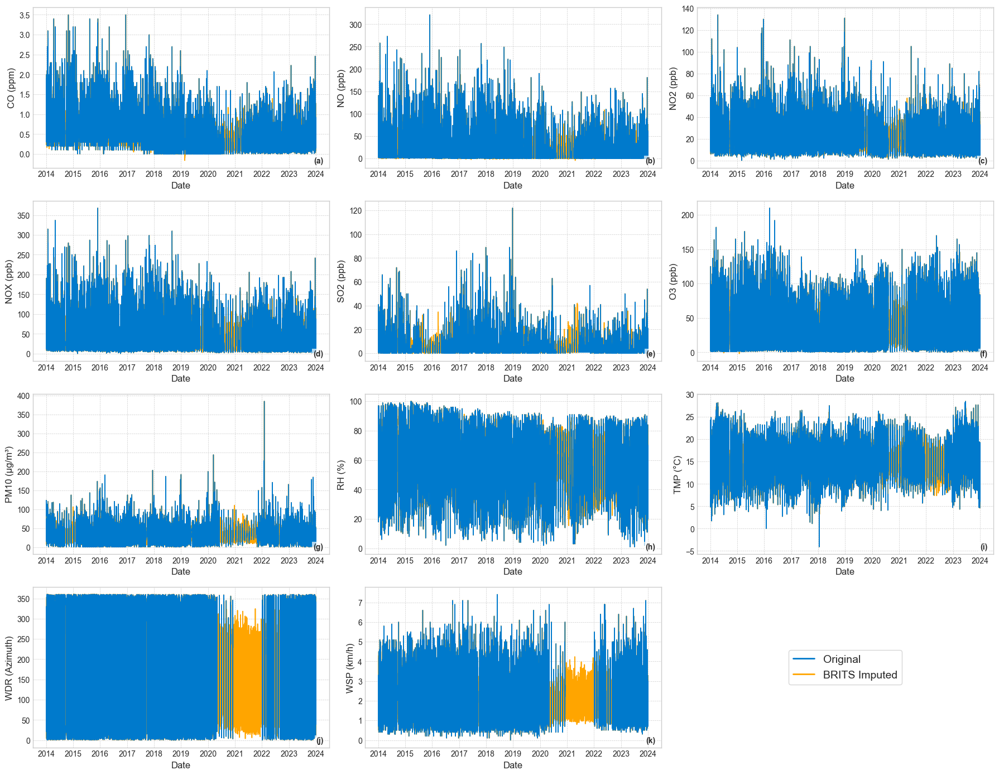


---  Generando Gráficos de Series de Tiempo: Estación SFE (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_SFE_RF.png


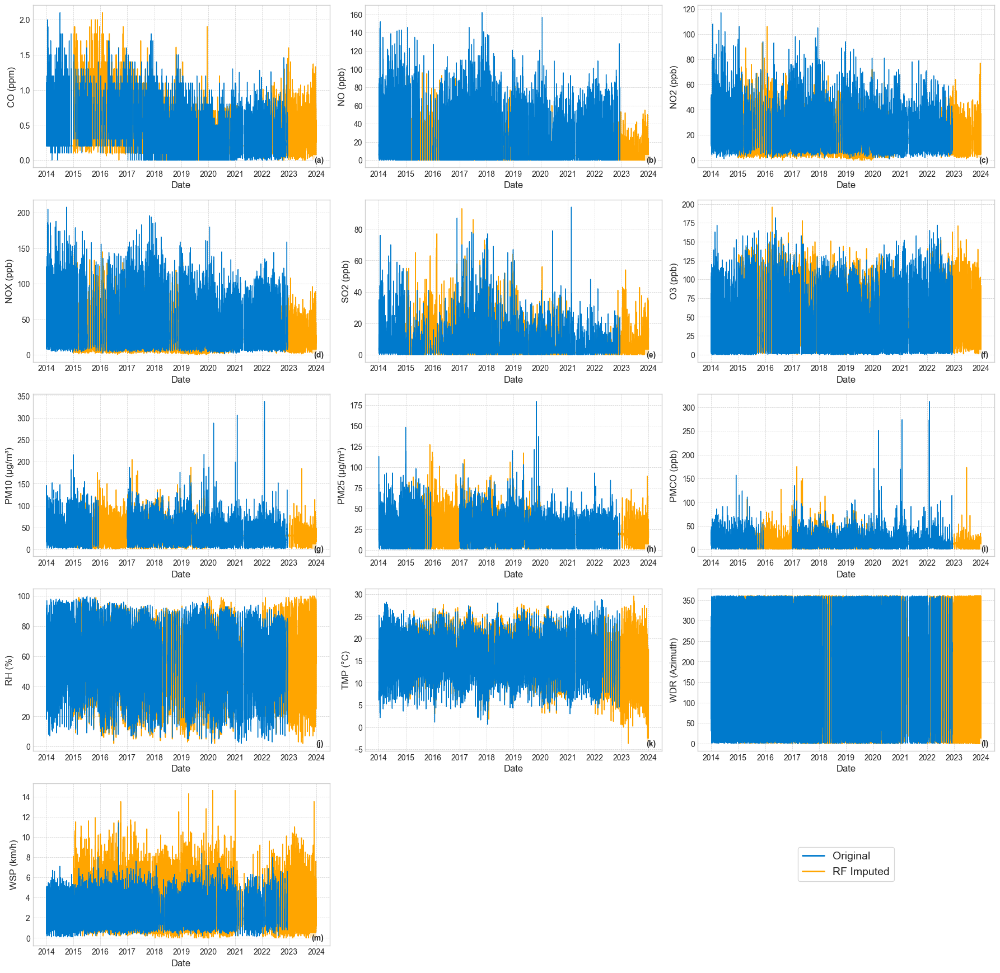


---  Generando Gráficos de Series de Tiempo: Estación SFE (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_SFE_BRITS.png


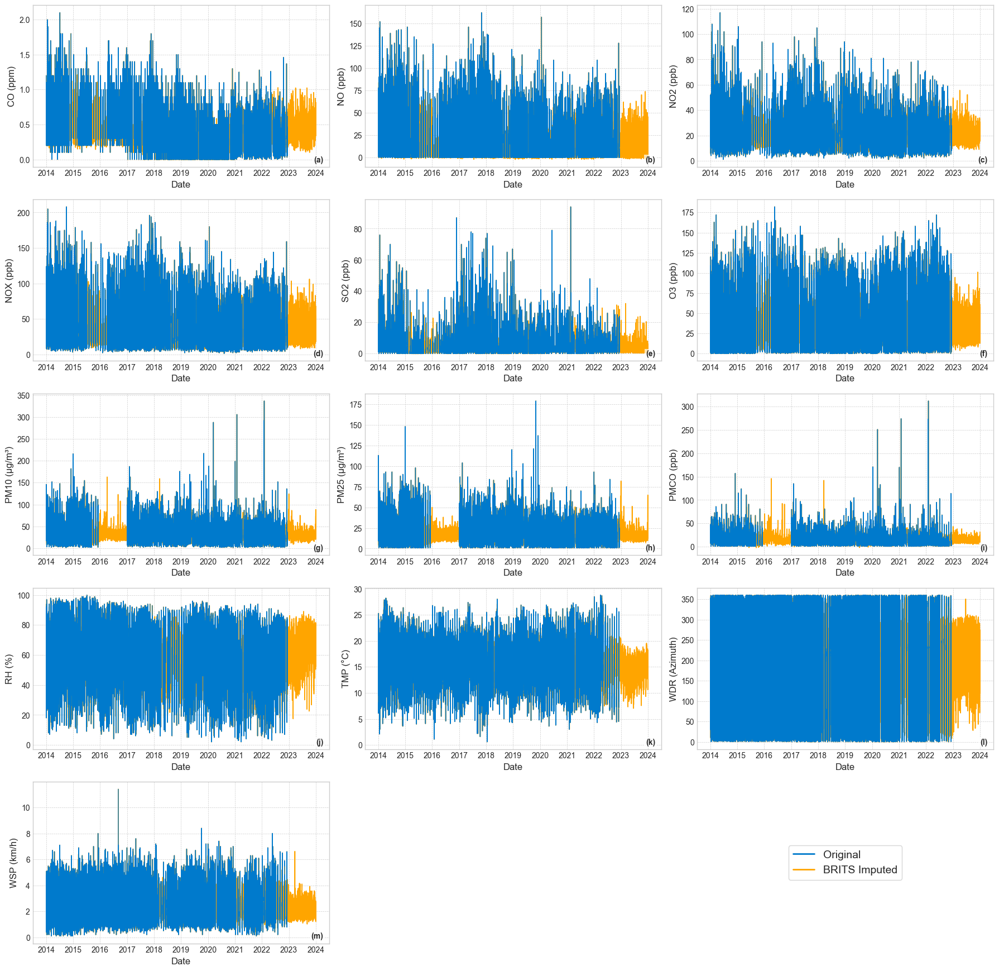


---  Generando Gráficos de Series de Tiempo: Estación AJM (Modelo: RF) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_AJM_RF.png


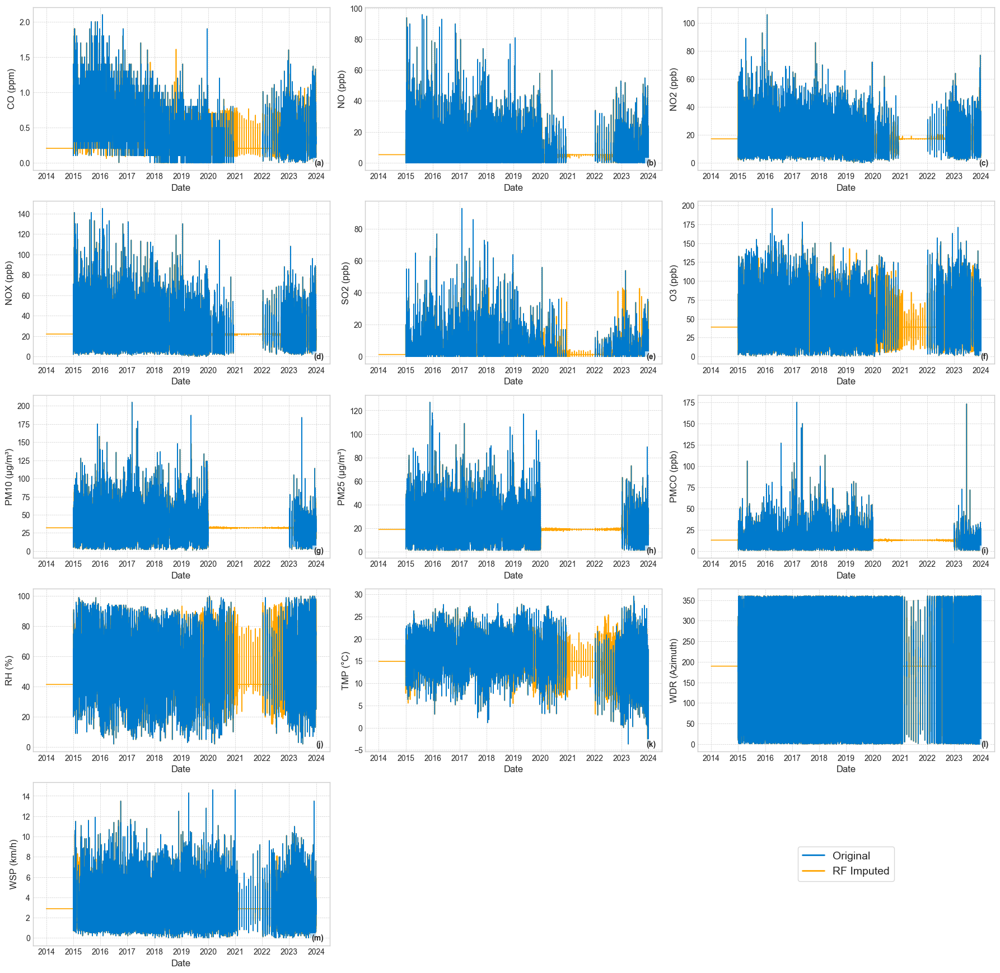


---  Generando Gráficos de Series de Tiempo: Estación AJM (Modelo: BRITS) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_14744\32461788.py:24: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df[date_column_name] = pd.to_datetime(df[date_column_name], errors='coerce')


Gráfico guardado en: series_tiempo_random/serie_AJM_BRITS.png


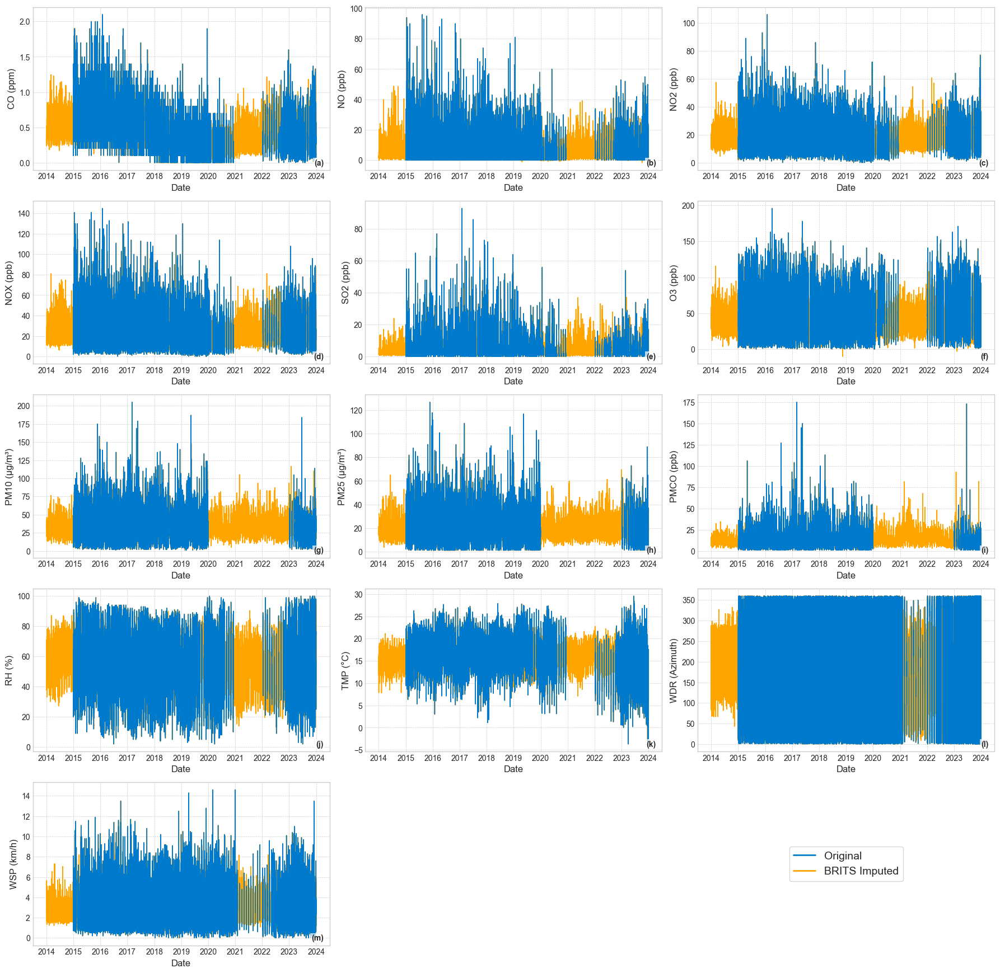

In [28]:
# Uso de la funcion "plot_series_comparison "
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua','sfe', 'ajm']

#  diccionario con los DataFrames originales
dfs = {
    "mer": df_mer,
    "tla": df_tla,
    "sag": df_sag,
    "uax": df_uax,
    "fac": df_fac,
    "nez": df_nez,
    "ped": df_ped,
    "vif": df_vif,
    "mgh": df_mgh,
    "cua": df_cua,
    "sfe": df_sfe,
    "ajm": df_ajm,
}

for station in estaciones:
    # Imputaciones
    df_imputado= pd.read_csv(f"df_imputaciones_rf_random/df_imputado_rf_random_{station.upper()}.csv")
    df_imputado_brits = pd.read_csv(f"df_imputaciones_brits_random/df_imputado_random_{station}.csv")
    df_original = dfs[station]
                # Llama a la función para la imputación de RF 
    plot_series_comparison(
                df_original=df_original,
                df_imputado=df_imputado_rf,
                date_column_name='date',  
                model_name="RF",
                station_name=station.upper()
            )
            
            #  Llama a la función para la imputación de BRITS
    plot_series_comparison(
                df_original=df_original,
                df_imputado=df_imputado_brits,
                date_column_name='date',
                model_name="BRITS",
                station_name=station.upper()
            )

# Genera una imagen boxplot de MAE Y RMSE 

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.lines import Line2D

# --- CONFIGURACIÓN ---
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez',
              'ped', 'vif', 'mgh', 'cua', 'sfe', 'ajm']
ruta_rf = 'df_imputaciones_rf_random'
ruta_brits = 'df_imputaciones_brits_random'

# --- CARGAR DATOS ---
registros = []
print("--- Iniciando carga de archivos de métricas (MAE/RMSE) ---")
for modelo, ruta in [('RF', ruta_rf), ('BRITS', ruta_brits)]:
    for est in estaciones:
        if modelo == 'RF':
            archivo = f"resumen_validacion_rf_random_{est.upper()}.csv"
        else:
            archivo = f"resumen_validacion_brits_random_{est.upper()}.csv"
        
        path = os.path.join(ruta, archivo)
        
        if not os.path.exists(path):
            print(f"[⚠] Archivo faltante, se omitirá: {path}")
            continue
        
        # 
        try:
            df_tmp = pd.read_csv(path)
            rename_dict_brits = {'MAE (Validation)': 'MAE', 'RMSE (Validation)': 'RMSE'}
            if modelo == 'BRITS':
                cols_to_rename = {k: v for k, v in rename_dict_brits.items() if k in df_tmp.columns}
                df_tmp.rename(columns=cols_to_rename, inplace=True)

            df_tmp['station'] = est.lower()
            df_tmp['model'] = modelo
            registros.append(df_tmp)
        except Exception as e:
            print(f"[❌] Error al procesar el archivo {path}: {e}")

if not registros:
    raise SystemExit("¡Error Crítico! No se encontró ningún archivo de métricas válido.")

df = pd.concat(registros, ignore_index=True)
df['Variable'] = df['Variable'].str.replace('Value_', '', regex=False)
df[['MAE', 'RMSE']] = df[['MAE', 'RMSE']].apply(pd.to_numeric, errors='coerce')
df.dropna(subset=['MAE', 'RMSE'], inplace=True)


# --- CONFIGURACIÓN DE ESTÉTICA ---
palette_model = {'RF': '#1f77b4', 'BRITS': '#ff7f0e'}

# 1. Paleta de colores con mayor contraste visual
station_colors = dict(zip(estaciones, sns.color_palette('tab20', len(estaciones))))

# 2. Marcadores con figuras distintas para las últimas estaciones
station_markers = ['o', 's', '^', 'v', 'D', 'P', 'X', '<', '>', 'p', '*', 'd'] 
marker_dict = dict(zip(estaciones, station_markers))


def plot_error_subplots(metric, outfile):
    variables = sorted(df['Variable'].unique())
    if not variables:
        print(f"[!] No hay datos para graficar la métrica '{metric}'.")
        return
        
    n_vars = len(variables)
    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 5))
    axes = axes.flatten()

    for i, var_name in enumerate(variables):
        ax = axes[i]
        df_var = df[df['Variable'] == var_name]
        if df_var.empty: continue
        model_order = sorted(df_var['model'].unique())

        sns.boxplot(data=df_var, x='model', y=metric, palette=palette_model, width=0.5, fliersize=0, ax=ax, order=model_order, zorder=1)
        model_pos = {model: pos for pos, model in enumerate(model_order)}
        
        for _, row in df_var.iterrows():
            jitter = np.random.uniform(-0.05, 0.05)
            st = row['station']
            if st in marker_dict:
                x_pos = model_pos[row['model']] + jitter
                # --- ESTILO DE FIGURAS  ---
                ax.scatter(x=x_pos, y=row[metric],
                           marker=marker_dict[st], s=100,
                           facecolors='none',                  # Sin relleno
                           edgecolors=station_colors[st],      # Borde con el color de la estación
                           linewidths=1.8,                     # Un borde más grueso
                           zorder=5)

        ax.set_title(var_name, fontsize=17, weight='bold')
        ax.set_xlabel("")
        ax.set_ylabel(metric, fontsize=15)
        ax.tick_params(axis='x', labelsize=17)
        ax.tick_params(axis='y', labelsize=16)
        ax.grid(axis='y', linestyle='--', alpha=0.7)

    for i in range(n_vars, len(axes)):
        axes[i].axis('off')
    
    # --- Estilo leyenda ---
    estaciones_cargadas = df['station'].unique()
    handles = [Line2D([0], [0], marker=marker_dict[st], color='none',
                      markerfacecolor='none',                 # Sin relleno
                      markeredgecolor=station_colors[st],     # Borde de color
                      markersize=10, 
                      markeredgewidth=1.8,                    # Grosor del borde
                      label=st.upper()) 
               for st in sorted(estaciones_cargadas)]
    
    if n_vars < len(axes):
        legend_ax = axes[-1]
        legend_ax.legend(handles=handles, title='Estaciones', loc='center', frameon=True, ncol=2, fontsize=14, title_fontsize=16)
        legend_ax.axis('off')
    else:
        fig.legend(handles=handles, title='Estaciones', loc='upper center', bbox_to_anchor=(0.5, -0.01), ncol=6, fontsize=14, title_fontsize=16)

    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.savefig(outfile, dpi=300, bbox_inches='tight')
    plt.close(fig)
    print(f"✅ Gráfico generado: '{outfile}'")

# --- EJECUCIÓN ---
plot_error_subplots('MAE', 'comparacion_MAE_subplots.png')
plot_error_subplots('RMSE', 'comparacion_RMSE_subplots.png')
print("\n✅ Proceso finalizado.")


--- Iniciando carga de archivos de métricas (MAE/RMSE) ---


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_var, x='model', y=metric, palette=palette_model, width=0.5, fliersize=0, ax=ax, order=model_order, zorder=1)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_var, x='model', y=metric, palette=palette_model, width=0.5, fliersize=0, ax=ax, order=model_order, zorder=1)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `

✅ Gráfico generado: 'comparacion_MAE_subplots.png'


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_var, x='model', y=metric, palette=palette_model, width=0.5, fliersize=0, ax=ax, order=model_order, zorder=1)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_var, x='model', y=metric, palette=palette_model, width=0.5, fliersize=0, ax=ax, order=model_order, zorder=1)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\2373458688.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `

✅ Gráfico generado: 'comparacion_RMSE_subplots.png'

✅ Proceso finalizado.


# Generra una imagen para la distancia relativa de W

In [26]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.lines import Line2D

# --- CONFIGURACIÓN ---
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua', 'sfe', 'ajm']
ruta_rf = 'df_imputaciones_rf_random' 
ruta_brits = 'df_imputaciones_brits_random'

# --- CARGAR DATOS ---
registros = []
print("--- Iniciando carga de archivos de métricas de Wasserstein ---")
for modelo, ruta in [('RF', ruta_rf), ('BRITS', ruta_brits)]:
    for est in estaciones:
        if modelo == 'RF':
            archivo = f"analisis_tost_final_rf_random_{est.upper()}.csv"
        else:
            archivo = f"analisis_distribucion_brits_random_{est.upper()}.csv"
        
        path = os.path.join(ruta, archivo)
        
        if not os.path.exists(path):
            print(f"[⚠] Archivo faltante, se omitirá: {path}")
            continue
        
        print(f"[✔] Cargando archivo: {path}")
        try:
            df_tmp = pd.read_csv(path)

            if 'W-Dist_Relative(%)' in df_tmp.columns:
                df_tmp.rename(columns={'W-Dist_Relative(%)': 'W-Dist Relative (%)'}, inplace=True)

            df_tmp['station'] = est.lower()
            df_tmp['model'] = modelo
            registros.append(df_tmp)
        except Exception as e:
            print(f"[❌] Error al procesar el archivo {path}: {e}")

if not registros:
    raise SystemExit("No se encontró ningún archivo de métricas válido.")

df = pd.concat(registros, ignore_index=True)
df['Variable'] = df['Variable'].str.replace('Value_', '', regex=False)
metric_col = 'W-Dist Relative (%)'

if metric_col not in df.columns:
    raise SystemExit(f"La columna requerida '{metric_col}' no se encuentra en los archivos cargados.")

df[metric_col] = pd.to_numeric(df[metric_col], errors='coerce')
df.dropna(subset=[metric_col], inplace=True)


# --- CONFIGURACIÓN DE ESTÉTICA ---
palette_model = {'RF': '#1f77b4', 'BRITS': '#ff7f0e'}
station_colors = dict(zip(estaciones, sns.color_palette('tab20', len(estaciones))))
station_markers = ['o', 's', '^', 'v', 'D', 'P', 'X', '<', '>', 'p', '*', 'd'] 
marker_dict = dict(zip(estaciones, station_markers))


def plot_wasserstein_subplots(outfile):
    variables = sorted(df['Variable'].unique())
    n_vars = len(variables)
    n_cols = 3
    n_rows = (n_vars + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 5))
    axes = axes.flatten()

    for i, var_name in enumerate(variables):
        ax = axes[i]
        df_var = df[df['Variable'] == var_name]
        if df_var.empty: continue
        model_order = sorted(df_var['model'].unique())

        sns.boxplot(
            data=df_var, x='model', y=metric_col,
            palette=palette_model, width=0.5,
            fliersize=0, ax=ax, order=model_order, zorder=1
        )

        model_pos = {model: pos for pos, model in enumerate(model_order)}
        
        for _, row in df_var.iterrows():
            jitter = np.random.uniform(-0.05, 0.05)
            st = row['station']
            if row['model'] in model_pos and st in marker_dict:
                x_pos = model_pos[row['model']] + jitter
                
                ax.scatter(x=x_pos, y=row[metric_col],
                           marker=marker_dict[st], s=100,
                           facecolors='none',                  # Sin relleno
                           edgecolors=station_colors[st],      # Borde con el color de la estación
                           linewidths=1.8,                     # Un borde más grueso para que se vea bien
                           zorder=5)

        ax.set_title(var_name, fontsize=17, weight='bold')
        ax.set_xlabel("")
        ax.set_ylabel('Wasserstein Distance (%)', fontsize=15)
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.tick_params(axis='x', labelsize=17)
        ax.tick_params(axis='y', labelsize=16)

    for i in range(n_vars, len(axes)):
        axes[i].axis('off')
    
    # ---  LEYENDA  ---
    estaciones_cargadas = df['station'].unique()
    handles = [Line2D([0], [0], marker=marker_dict[st], color='none',
                      markerfacecolor='none',                 # Sin relleno
                      markeredgecolor=station_colors[st],     # Borde de color
                      markersize=10, 
                      markeredgewidth=1.8,                    # Grosor del borde
                      label=st.upper()) 
               for st in sorted(estaciones_cargadas)]
    
    if n_vars < len(axes):
        legend_ax = axes[-1]
        legend_ax.legend(handles=handles, title='Estaciones', loc='center', frameon=True, ncol=2, fontsize=14, title_fontsize=16)
        legend_ax.axis('off')
    else:
        fig.legend(handles=handles, title='Estaciones', loc='upper center', bbox_to_anchor=(0.5, -0.01), ncol=6, fontsize=14, title_fontsize=16)
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.savefig(outfile, dpi=300, bbox_inches='tight')
    plt.close(fig)
    print(f"✅ Gráfico generado: '{outfile}'")

# --- EJECUTAR ---
plot_wasserstein_subplots('comparacion_Wasserstein_subplots.png')

print("\n✅ Proceso finalizado.")

--- Iniciando carga de archivos de métricas de Wasserstein ---
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_MER.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_TLA.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_SAG.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_UAX.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_FAC.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_NEZ.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_PED.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_VIF.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_MGH.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random_CUA.csv
[✔] Cargando archivo: df_imputaciones_rf_random\analisis_tost_final_rf_random

C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\189572816.py:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\189572816.py:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\189572816.py:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_1308\189572816.py:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assig

✅ Gráfico generado: 'comparacion_Wasserstein_subplots.png'

✅ Proceso finalizado.


# consilidacion de metricas de todos los archivos

In [ ]:
# CONSOLIDA LOS ARCHIVOS DE LAS ESTACIONES BRITS Y RF
import os
import pandas as pd

# --- CONFIGURACIÓN ---
estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua']

# Rutas a las carpetas con los resultados
ruta_mae_rmse_rf = 'df_imputaciones_rf_random'
ruta_mae_rmse_brits = 'df_imputaciones_brits_random'
ruta_wasserstein_rf = 'df_imputaciones_rf_random' 
ruta_wasserstein_brits = 'df_imputaciones_brits_random'


all_data = []
print("--- Iniciando consolidación de métricas de todos los modelos y estaciones ---")

for station in estaciones:
    print(f"\nProcesando estación: {station.upper()}")
    
    try:
        # --- Cargar datos de RF ---
        # 1. Archivo de MAE/RMSE
        path_error_rf = os.path.join(ruta_mae_rmse_rf, f"resumen_validacion_rf_random_{station.upper()}.csv")
        df_error_rf = pd.read_csv(path_error_rf)[['Variable', 'MAE', 'RMSE']]
        
        # 2. Archivo de Wasserstein
        path_w_rf = os.path.join(ruta_wasserstein_rf, f"analisis_tost_final_rf_random_{station.upper()}.csv")
        df_w_rf = pd.read_csv(path_w_rf)
        # Estandarizar nombre de columna
        if 'W-Dist_Relative(%)' in df_w_rf.columns:
            df_w_rf.rename(columns={'W-Dist_Relative(%)': 'W-Dist Relative (%)'}, inplace=True)
        df_w_rf = df_w_rf[['Variable', 'W-Dist Relative (%)']]
        
        # Unir los datos de RF
        df_rf_merged = pd.merge(df_error_rf, df_w_rf, on='Variable', how='outer')
        df_rf_merged['station'] = station.upper()
        df_rf_merged['model'] = 'RF'
        all_data.append(df_rf_merged)
        print(f"  [✔] Datos de RF para {station.upper()} procesados.")

    except FileNotFoundError as e:
        print(f"  [⚠] Faltan archivos para RF en la estación {station.upper()}. Se omitirá. Detalle: {e.filename}")

    try:
        # Cargar datos de BRITS -
        #  Archivo de MAE/RMSE
        path_error_brits = os.path.join(ruta_mae_rmse_brits, f"resumen_validacion_brits_random_{station.upper()}.csv")
        df_error_brits = pd.read_csv(path_error_brits)
        # Estandarizar nombres de columnas
        df_error_brits.rename(columns={'MAE (Validation)': 'MAE', 'RMSE (Validation)': 'RMSE'}, inplace=True)
        df_error_brits = df_error_brits[['Variable', 'MAE', 'RMSE']]

        #  Archivo de Wasserstein
        path_w_brits = os.path.join(ruta_wasserstein_brits, f"analisis_distribucion_brits_random_{station.upper()}.csv")
        df_w_brits = pd.read_csv(path_w_brits)
        # Estandarizar nombre de columna
        if 'W-Dist_Relative(%)' in df_w_brits.columns:
            df_w_brits.rename(columns={'W-Dist_Relative(%)': 'W-Dist Relative (%)'}, inplace=True)
        df_w_brits = df_w_brits[['Variable', 'W-Dist Relative (%)']]

        # Unir los datos de BRITS
        df_brits_merged = pd.merge(df_error_brits, df_w_brits, on='Variable', how='outer')
        df_brits_merged['station'] = station.upper()
        df_brits_merged['model'] = 'BRITS'
        all_data.append(df_brits_merged)
        print(f"  [✔] Datos de BRITS para {station.upper()} procesados.")

    except FileNotFoundError as e:
        print(f"  [⚠] Faltan archivos para BRITS en la estación {station.upper()}. Se omitirá. Detalle: {e.filename}")


#GUARDAR EL ARCHIVO 
if not all_data:
    raise SystemExit(" No se pudo cargar ningún dato. No se generará el archivo consolidado.")

df_final = pd.concat(all_data, ignore_index=True)


df_final['Variable'] = df_final['Variable'].str.replace('Value_', '', regex=False)


column_order = ['station', 'model', 'Variable', 'MAE', 'RMSE', 'W-Dist Relative (%)']
df_final = df_final[column_order]

output_filename = 'resumen_consolidado_errores.csv'
df_final.to_csv(output_filename, index=False, float_format='%.4f')

print(f"\n✅ Proceso finalizado. Todas las métricas han sido consolidadas en el archivo '{output_filename}'")

--- Iniciando consolidación de métricas de todos los modelos y estaciones ---

Procesando estación: MER
  [✔] Datos de RF para MER procesados.
  [✔] Datos de BRITS para MER procesados.

Procesando estación: TLA
  [✔] Datos de RF para TLA procesados.
  [✔] Datos de BRITS para TLA procesados.

Procesando estación: SAG
  [✔] Datos de RF para SAG procesados.
  [✔] Datos de BRITS para SAG procesados.

Procesando estación: UAX
  [✔] Datos de RF para UAX procesados.
  [✔] Datos de BRITS para UAX procesados.

Procesando estación: FAC
  [✔] Datos de RF para FAC procesados.
  [✔] Datos de BRITS para FAC procesados.

Procesando estación: NEZ
  [✔] Datos de RF para NEZ procesados.
  [✔] Datos de BRITS para NEZ procesados.

Procesando estación: PED
  [✔] Datos de RF para PED procesados.
  [✔] Datos de BRITS para PED procesados.

Procesando estación: VIF
  [✔] Datos de RF para VIF procesados.
  [✔] Datos de BRITS para VIF procesados.

Procesando estación: MGH
  [✔] Datos de RF para MGH procesados.
 

# Calculo calidad del aire 

In [ ]:
#CALCULO ICA

"""
Este script contiene funciones para calcular el Índice de Calidad del Aire (ICA/AQI)
basado en los estándares de la EPA de EE. UU. para un DataFrame de datos de
calidad del aire.
"""

import pandas as pd
import numpy as np
import os

# ================================================
#  DEFINICIÓN DE LOS PUNTOS DE CORTE DEL ICA 
# ================================================
# Estructura: [I_Lo, I_Hi, BP_Lo, BP_Hi]
BREAKPOINTS = {
    'O3_8h': [ # en ppm
        [0, 50, 0.000, 0.054],
        [51, 100, 0.055, 0.070],
        [101, 150, 0.071, 0.085],
        [151, 200, 0.086, 0.105],
        [201, 300, 0.106, 0.200]
    ],
    'PM25_24h': [ # en µg/m³
        [0, 50, 0.0, 12.0],
        [51, 100, 12.1, 35.4],
        [101, 150, 35.5, 55.4],
        [151, 200, 55.5, 150.4],
        [201, 300, 150.5, 250.4],
        [301, 400, 250.5, 350.4],
        [401, 500, 350.5, 500.4]
    ],
    'PM10_24h': [ # en µg/m³
        [0, 50, 0, 54],
        [51, 100, 55, 154],
        [101, 150, 155, 254],
        [151, 200, 255, 354],
        [201, 300, 355, 424],
        [301, 400, 425, 504],
        [401, 500, 505, 604]
    ],
    'CO_8h': [ # en ppm
        [0, 50, 0.0, 4.4],
        [51, 100, 4.5, 9.4],
        [101, 150, 9.5, 12.4],
        [151, 200, 12.5, 15.4],
        [201, 300, 15.5, 30.4],
        [301, 400, 30.5, 40.4],
        [401, 500, 40.5, 50.4]
    ],
    'SO2_1h': [ # en ppb
        [0, 50, 0, 35],
        [51, 100, 36, 75],
        [101, 150, 76, 185],
        [151, 200, 186, 304]
        # La EPA no define consistentemente niveles más altos para 1h
    ],
    'NO2_1h': [ # en ppb
        [0, 50, 0, 53],
        [51, 100, 54, 100],
        [101, 150, 101, 360],
        [151, 200, 361, 649],
        [201, 300, 650, 1249],
        [301, 400, 1250, 1649],
        [401, 500, 1650, 2049]
    ]
}

# Mapeo de columnas del DataFrame a las claves de BREAKPOINTS
COLUMN_TO_POLLUTANT_MAP = {
    'Value_O3': 'O3_8h',
    'Value_PM25': 'PM25_24h',
    'Value_PM10': 'PM10_24h',
    'Value_CO': 'CO_8h',
    'Value_SO2': 'SO2_1h',
    'Value_NO2': 'NO2_1h'
}

# ================================================
#  FUNCIÓN DE CÁLCULO
# ================================================

def calculate_sub_index(concentration, pollutant_key):
    """Calcula el sub-índice ICA para una concentración y contaminante dados."""
    if pd.isna(concentration) or concentration < 0:
        return np.nan
    
    breakpoints = BREAKPOINTS.get(pollutant_key)
    if not breakpoints:
        return np.nan

    for i_lo, i_hi, bp_lo, bp_hi in breakpoints:
        if bp_lo <= concentration <= bp_hi:
            # Fórmula de interpolación lineal del ICA
            return ((i_hi - i_lo) / (bp_hi - bp_lo)) * (concentration - bp_lo) + i_lo
    
    # Si la concentración es mayor que el último breakpoint, se retorna el máximo de ese rango
    return breakpoints[-1][1]


def calculate_aqi_for_df(df, date_column='date'):
    """
    Calcula el ICA para un DataFrame completo.

    Args:
        df (pd.DataFrame): DataFrame con datos de calidad del aire.
        date_column (str): Nombre de la columna de fecha.

    Returns:
        pd.DataFrame: El DataFrame original con las columnas de ICA añadidas.
    """
    df_aqi = df.copy()
    
   
    if date_column in df_aqi.columns:
        df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')
        df_aqi = df_aqi.set_index(date_column).sort_index()

    sub_indices = pd.DataFrame(index=df_aqi.index)

    for col, pollutant_key in COLUMN_TO_POLLUTANT_MAP.items():
        if col in df_aqi.columns:
            print(f"  Procesando {col} como {pollutant_key}...")
            
            # serie de concentraciones
            concentration_series = df_aqi[col]
            
            # Convertir unidades
            if pollutant_key == 'O3_8h': # El estándar es en ppm, los datos suelen estar en ppb
                concentration_series = concentration_series / 1000.0

            # Calcular promedios móviles para contaminantes que lo requieran
            if '24h' in pollutant_key:
                concentration_series = concentration_series.rolling(window=24, min_periods=1).mean()
            elif '8h' in pollutant_key:
                concentration_series = concentration_series.rolling(window=8, min_periods=1).mean()

            # Calcular el sub-índice para cada punto
            sub_indices[f"AQI_{col.replace('Value_', '')}"] = concentration_series.apply(
                lambda x: calculate_sub_index(x, pollutant_key)
            )

    # Calcular el ICA general y el contaminante dominante
    df_aqi['AQI'] = sub_indices.max(axis=1)
    df_aqi['Dominant_Pollutant'] = sub_indices.idxmax(axis=1)
    
    return df_aqi.reset_index()

# ================================================
#                     EJECUCIÓN 
# ================================================

if __name__ == '__main__':
    estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua']
    
    # Rutas a las carpetas con los datos imputados
    ruta_rf = 'df_imputaciones_rf'
    ruta_brits = 'df_imputaciones_brits'
    output_dir = 'datos_con_ica'
    
    os.makedirs(output_dir, exist_ok=True)

    for station in estaciones:
        print(f"\n========================================================")
        print(f"Procesando estación: {station.upper()}")
        print(f"========================================================")

        # Procesar datos de Random Forest
        try:
            path_rf = os.path.join(ruta_rf, f"df_imputado_rf_{station.upper()}.csv")
            print(f"Cargando archivo: {path_rf}")
            df_rf = pd.read_csv(path_rf)
            
            df_rf_con_ica = calculate_aqi_for_df(df_rf, date_column='date')
            
            output_path_rf = os.path.join(output_dir, f"df_aqi_rf_{station.upper()}.csv")
            df_rf_con_ica.to_csv(output_path_rf, index=False)
            print(f"  [✔] Archivo con ICA de RF guardado en: {output_path_rf}")
            
        except FileNotFoundError:
            print(f"  [⚠] No se encontró el archivo para RF en la estación {station.upper()}. Se omitirá.")
        except Exception as e:
            print(f"  [❌] Ocurrió un error procesando RF para {station.upper()}: {e}")

        # Procesar datos de BRITS
        try:
            path_brits = os.path.join(ruta_brits, f"df_imputado_{station}.csv")
            print(f"Cargando archivo: {path_brits}")
            df_brits = pd.read_csv(path_brits)
            
            df_brits_con_ica = calculate_aqi_for_df(df_brits, date_column='date')
            
            output_path_brits = os.path.join(output_dir, f"df_aqi_brits_{station.upper()}.csv")
            df_brits_con_ica.to_csv(output_path_brits, index=False)
            print(f"  [✔] Archivo con ICA de BRITS guardado en: {output_path_brits}")

        except FileNotFoundError:
            print(f"  [⚠] No se encontró el archivo para BRITS en la estación {station.upper()}. Se omitirá.")
        except Exception as e:
            print(f"  [❌] Ocurrió un error procesando BRITS para {station.upper()}: {e}")

    print("\n✅ Proceso de cálculo de ICA finalizado.")


Procesando estación: MER
Cargando archivo: df_imputaciones_rf\df_imputado_rf_MER.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_MER.csv
Cargando archivo: df_imputaciones_brits\df_imputado_mer.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_MER.csv

Procesando estación: TLA
Cargando archivo: df_imputaciones_rf\df_imputado_rf_TLA.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_TLA.csv
Cargando archivo: df_imputaciones_brits\df_imputado_tla.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_TLA.csv

Procesando estación: SAG
Cargando archivo: df_imputaciones_rf\df_imputado_rf_SAG.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_SAG.csv
Cargando archivo: df_imputaciones_brits\df_imputado_sag.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_SAG.csv

Procesando estación: UAX
Cargando archivo: df_imputaciones_rf\df_imputado_rf_UAX.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_UAX.csv
Cargando archivo: df_imputaciones_brits\df_imputado_uax.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_UAX.csv

Procesando estación: FAC
Cargando archivo: df_imputaciones_rf\df_imputado_rf_FAC.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_FAC.csv
Cargando archivo: df_imputaciones_brits\df_imputado_fac.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_FAC.csv

Procesando estación: NEZ
Cargando archivo: df_imputaciones_rf\df_imputado_rf_NEZ.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_NEZ.csv
Cargando archivo: df_imputaciones_brits\df_imputado_nez.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_NEZ.csv

Procesando estación: PED
Cargando archivo: df_imputaciones_rf\df_imputado_rf_PED.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_PED.csv
Cargando archivo: df_imputaciones_brits\df_imputado_ped.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM25 como PM25_24h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_PED.csv

Procesando estación: VIF
Cargando archivo: df_imputaciones_rf\df_imputado_rf_VIF.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_VIF.csv
Cargando archivo: df_imputaciones_brits\df_imputado_vif.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_VIF.csv

Procesando estación: MGH
Cargando archivo: df_imputaciones_rf\df_imputado_rf_MGH.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_MGH.csv
Cargando archivo: df_imputaciones_brits\df_imputado_mgh.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_MGH.csv

Procesando estación: CUA
Cargando archivo: df_imputaciones_rf\df_imputado_rf_CUA.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de RF guardado en: datos_con_ica\df_aqi_rf_CUA.csv
Cargando archivo: df_imputaciones_brits\df_imputado_cua.csv


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2090772951.py:115: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_aqi[date_column] = pd.to_datetime(df_aqi[date_column], errors='coerce')


  Procesando Value_O3 como O3_8h...
  Procesando Value_PM10 como PM10_24h...
  Procesando Value_CO como CO_8h...
  Procesando Value_SO2 como SO2_1h...
  Procesando Value_NO2 como NO2_1h...
  [✔] Archivo con ICA de BRITS guardado en: datos_con_ica\df_aqi_brits_CUA.csv

✅ Proceso de cálculo de ICA finalizado.



Generando gráficos consolidados para el modelo: RF


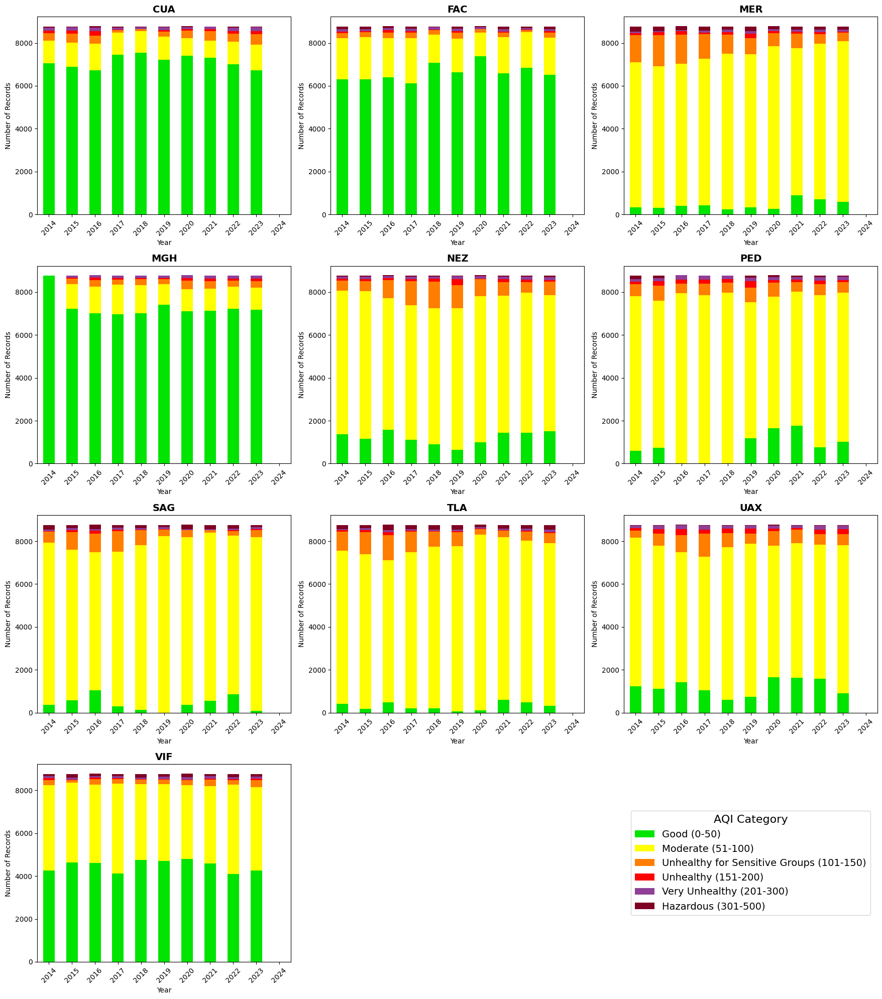

  [✔] Gráfico de resumen anual consolidado para RF guardado.


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=pollutant_counts.values, y=pollutant_counts.index, palette='crest_r', orient='h', ax=ax)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=pollutant_counts.values, y=pollutant_counts.index, palette='crest_r', orient='h', ax=ax)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot

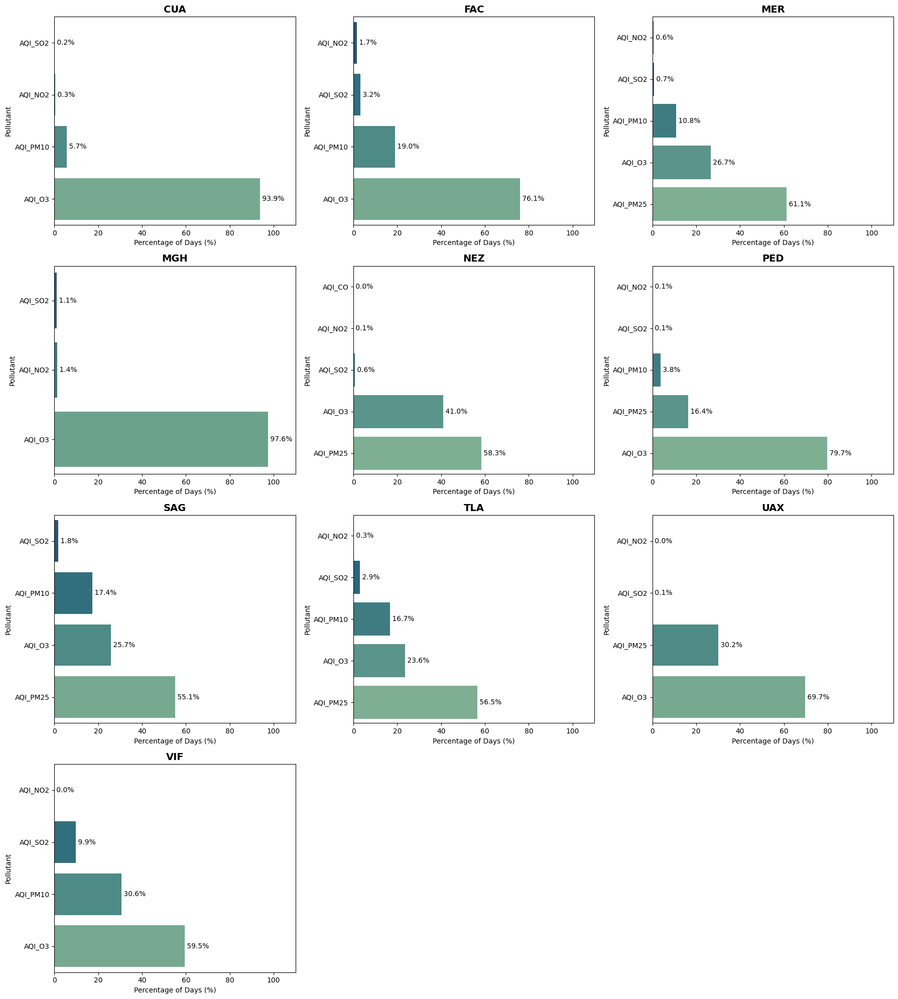

  [✔] Gráfico de contaminante dominante consolidado para RF guardado.

Generando gráficos consolidados para el modelo: BRITS


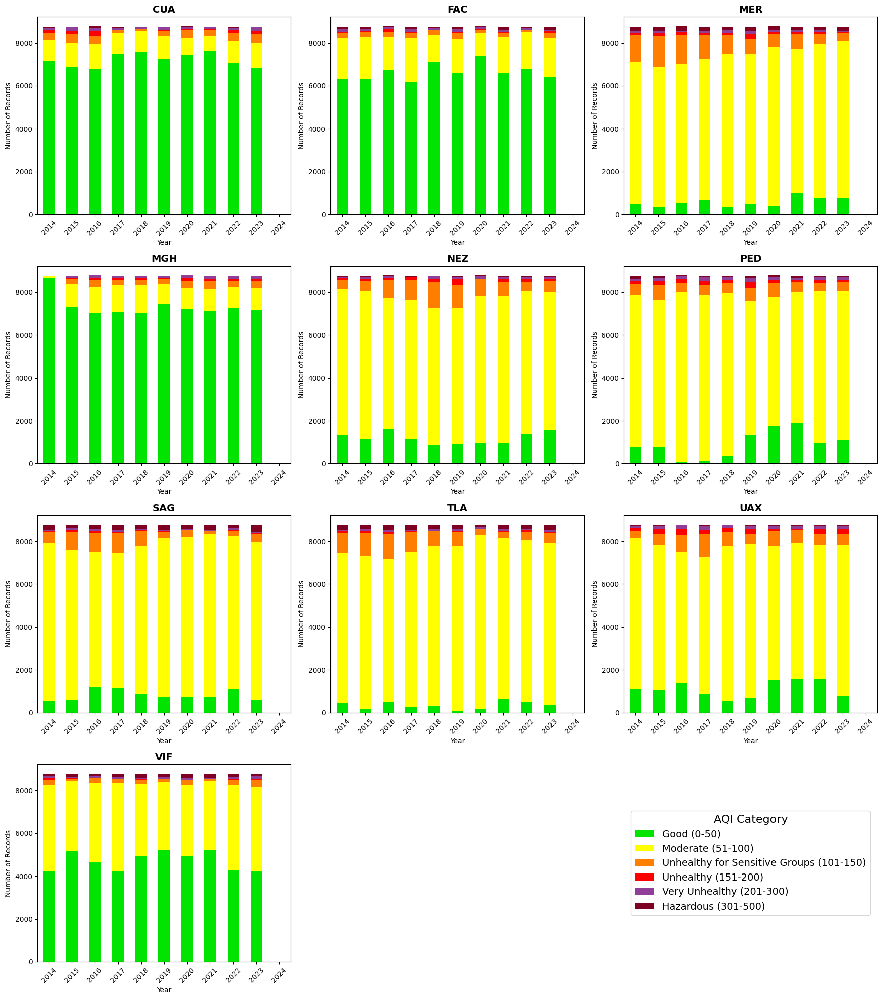

  [✔] Gráfico de resumen anual consolidado para BRITS guardado.


C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=pollutant_counts.values, y=pollutant_counts.index, palette='crest_r', orient='h', ax=ax)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=pollutant_counts.values, y=pollutant_counts.index, palette='crest_r', orient='h', ax=ax)
C:\Users\PC PRIDE GOAT\AppData\Local\Temp\ipykernel_29500\2068140885.py:68: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot

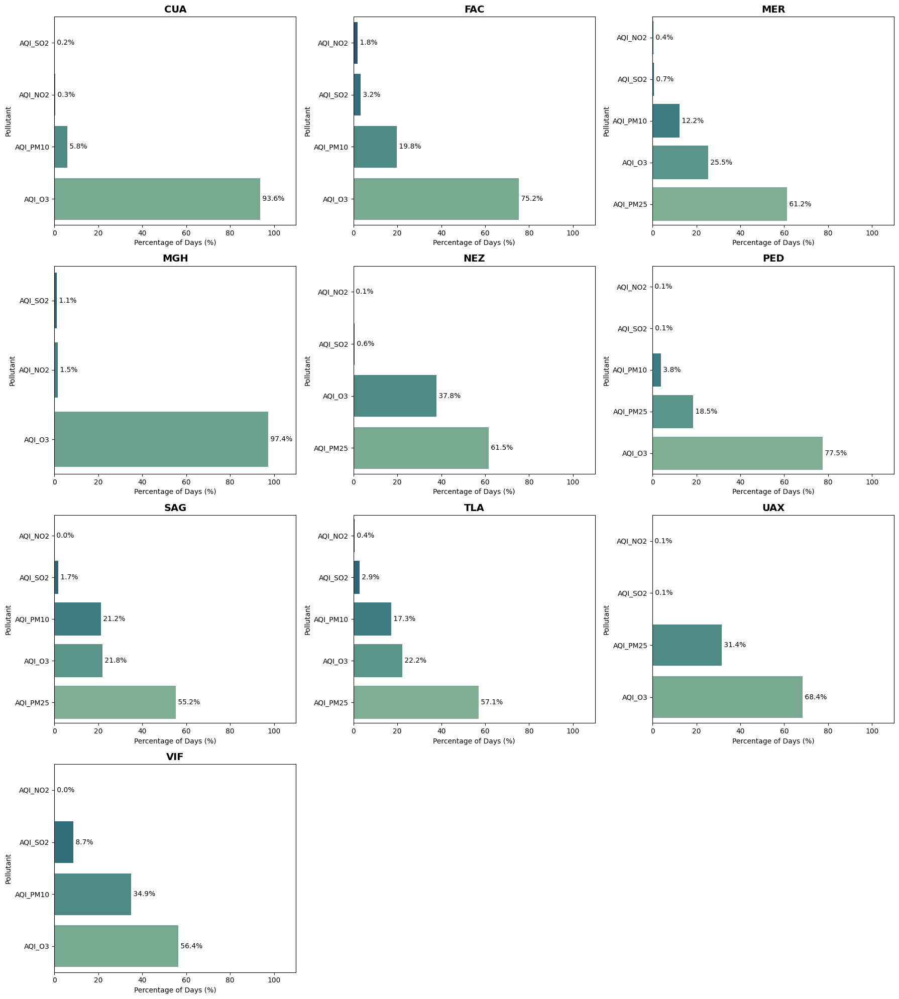

  [✔] Gráfico de contaminante dominante consolidado para BRITS guardado.

✅ Proceso de graficado de ICA finalizado.


In [ ]:
#VISUALIZAR DATOS ICA
"""
Este script contiene funciones para visualizar los datos del Índice de Calidad del Aire (ICA/AQI)
"""

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

# ================================================
# 1. DEFINICIÓN DE CATEGORÍAS Y COLORES DEL ICA
# ================================================
AQI_CATEGORIES = {
    'Good': (0, 50), 'Moderate': (51, 100),
    'Unhealthy for Sensitive Groups': (101, 150),
    'Unhealthy': (151, 200), 'Very Unhealthy': (201, 300),
    'Hazardous': (301, 500)
}
AQI_COLORS = ['#00e400', '#ffff00', '#ff7e00', '#ff0000', '#8f3f97', '#7e0023']

# ================================================
# 2. FUNCIONES DE GRAFICADO DE SUBPLOTS
# ================================================

def plot_aqi_annual_summary_subplot(ax, df_station, station_name):
    """Dibuja un único subplot de barras apiladas del ICA por año."""
    df_plot = df_station.copy()
    df_plot['year'] = pd.to_datetime(df_plot['date']).dt.year

    def get_aqi_category(aqi_value):
        if pd.isna(aqi_value): return None
        for category, (low, high) in AQI_CATEGORIES.items():
            if low <= aqi_value <= high:
                return category
        return 'Hazardous'
    
    df_plot['AQI_Category'] = df_plot['AQI'].apply(get_aqi_category)
    summary = df_plot.groupby(['year', 'AQI_Category']).size().unstack(fill_value=0)
    
    ordered_categories = list(AQI_CATEGORIES.keys())
    for cat in ordered_categories:
        if cat not in summary.columns:
            summary[cat] = 0
    summary = summary[ordered_categories]

    summary.plot(kind='bar', stacked=True, color=AQI_COLORS, ax=ax, legend=False)
    ax.set_title(station_name, fontsize=14, weight='bold')
    ax.set_xlabel('Year')
    ax.set_ylabel('Number of Records')
    ax.tick_params(axis='x', rotation=45)

def plot_dominant_pollutant_subplot(ax, df_station, station_name):
    """Dibuja un único subplot de barras horizontales del contaminante dominante."""
    df_plot = df_station[df_station['AQI'] > 100].copy()
    
    if df_plot.empty:
        ax.text(0.5, 0.5, 'No data with AQI > 100', ha='center', va='center')
        ax.set_title(station_name, fontsize=14, weight='bold')
        return

    pollutant_counts = df_plot['Dominant_Pollutant'].value_counts(normalize=True) * 100
    pollutant_counts = pollutant_counts.sort_values()

    sns.barplot(x=pollutant_counts.values, y=pollutant_counts.index, palette='crest_r', orient='h', ax=ax)
    
    for index, value in enumerate(pollutant_counts):
        ax.text(value, index, f' {value:.1f}%', va='center')

    ax.set_title(station_name, fontsize=14, weight='bold')
    ax.set_xlabel('Percentage of Days (%)')
    ax.set_ylabel('Pollutant')
    ax.set_xlim(0, 110)

# ================================================
# 3. FUNCIÓN PRINCIPAL DE EJECUCIÓN
# ================================================

def generate_consolidated_plots(estaciones, ruta_datos_ica, output_dir_plots):
    """Carga todos los datos y genera las 4 figuras consolidadas."""
    
    for model_name in ['RF', 'BRITS']:
        print(f"\n========================================================")
        print(f"Generando gráficos consolidados para el modelo: {model_name}")
        print(f"========================================================")
        
        # Cargar todos los datos para el modelo actual
        df_all_stations = []
        for station in estaciones:
            try:
                if model_name == 'RF':
                    path = os.path.join(ruta_datos_ica, f"df_aqi_rf_{station.upper()}.csv")
                else: # BRITS
                    path = os.path.join(ruta_datos_ica, f"df_aqi_brits_{station.upper()}.csv")
                
                df_station = pd.read_csv(path)
                df_station['station_name'] = station.upper()
                df_all_stations.append(df_station)
            except FileNotFoundError:
                print(f"  [⚠] No se encontró el archivo para {model_name} en la estación {station.upper()}. Se omitirá.")
        
        if not df_all_stations:
            print(f"No se encontraron datos para el modelo {model_name}. No se pueden generar gráficos.")
            continue
            
        df_consolidado = pd.concat(df_all_stations, ignore_index=True)

        # --- Generar Gráfico de Resumen Anual Consolidado ---
        n_stations = len(df_consolidado['station_name'].unique())
        n_cols = 3
        n_rows = (n_stations + n_cols - 1) // n_cols
        fig1, axes1 = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 5))
        axes1 = axes1.flatten()

        for i, station in enumerate(sorted(df_consolidado['station_name'].unique())):
            df_subset = df_consolidado[df_consolidado['station_name'] == station]
            plot_aqi_annual_summary_subplot(axes1[i], df_subset, station)

        for i in range(n_stations, len(axes1)):
            axes1[i].axis('off')

        # --- CAMBIO: Leyenda mejorada con valores numéricos y tamaño aumentado ---
        legend_labels = [f"{name} ({low}-{high})" for name, (low, high) in AQI_CATEGORIES.items()]
        legend_handles = [Patch(facecolor=color, label=label) for label, color in zip(legend_labels, AQI_COLORS)]
        axes1[-1].legend(handles=legend_handles, title='AQI Category', loc='center', 
                         fontsize=14, title_fontsize=16) # <-- Tamaño aumentado
        
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir_plots, f'resumen_anual_ica_consolidado_{model_name}.png'), dpi=300)
        plt.show()
        plt.close(fig1)
        print(f"  [✔] Gráfico de resumen anual consolidado para {model_name} guardado.")

        # --- Generar Gráfico de Contaminante Dominante Consolidado ---
        fig2, axes2 = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 5))
        axes2 = axes2.flatten()

        for i, station in enumerate(sorted(df_consolidado['station_name'].unique())):
            df_subset = df_consolidado[df_consolidado['station_name'] == station]
            plot_dominant_pollutant_subplot(axes2[i], df_subset, station)

        for i in range(n_stations, len(axes2)):
            axes2[i].axis('off')
        
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir_plots, f'contaminante_dominante_consolidado_{model_name}.png'), dpi=300)
        plt.show()
        plt.close(fig2)
        print(f"  [✔] Gráfico de contaminante dominante consolidado para {model_name} guardado.")


if __name__ == '__main__':
    estaciones = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua']
    ruta_datos_ica = 'datos_con_ica'
    output_dir_plots = 'graficos_ica'
    os.makedirs(output_dir_plots, exist_ok=True)
    
    generate_consolidated_plots(estaciones, ruta_datos_ica, output_dir_plots)
    
    print("\n✅ Proceso de graficado de ICA finalizado.")

In [ ]:
import pandas as pd
import os
from scipy.stats import chi2_contingency
from IPython.display import display, HTML

# ================================================
#                 CONFIGURACIÓN
# ================================================
# Directorio donde se guardaron los resultados del script anterior
INPUT_DIR = 'datos_con_ica'

# Lista de estaciones
ESTACIONES = ['mer', 'tla', 'sag', 'uax', 'fac', 'nez', 'ped', 'vif', 'mgh', 'cua']

# Definición de las categorías del ICA y sus límites superiores
CATEGORIAS_ICA = {
    'Buena': 50,
    'Moderada': 100,
    'Dañina G. Sensibles': 150,
    'Dañina': 200,
    'Muy Dañina': 300,
    'Peligrosa': float('inf') # Cualquier valor por encima de 300
}

# ================================================
#       CARGA Y CONSOLIDACIÓN DE DATOS
# ================================================

def load_and_combine_data(model_prefix, base_dir, stations):
    """Carga y concatena los archivos CSV para un modelo específico."""
    all_data = []
    print(f"\nCargando datos para el modelo: {model_prefix.upper()}")
    for station in stations:
        file_path = os.path.join(base_dir, f"df_aqi_{model_prefix}_{station.upper()}.csv")
        if os.path.exists(file_path):
            try:
                df = pd.read_csv(file_path)
                all_data.append(df)
            except Exception as e:
                print(f"  [❌] Error cargando {file_path}: {e}")
        else:
            print(f"  [⚠] Archivo no encontrado, se omite: {file_path}")
    
    if not all_data:
        print(f"  [❌] No se encontraron datos para el modelo {model_prefix.upper()}.")
        return pd.DataFrame()
        
    print(f"  [✔] Datos cargados y consolidados para {model_prefix.upper()}.")
    return pd.concat(all_data, ignore_index=True)

# Cargar los datos de ambos modelos
df_rf = load_and_combine_data('rf', INPUT_DIR, ESTACIONES)
df_brits = load_and_combine_data('brits', INPUT_DIR, ESTACIONES)

# ================================================
#            CLASIFICACIÓN Y ANÁLISIS
# ================================================

if not df_rf.empty and not df_brits.empty:
    # --- Función para clasificar el ICA ---
    def classify_aqi(aqi_value):
        """Clasifica un valor numérico de ICA en su categoría de riesgo."""
        if pd.isna(aqi_value):
            return 'No Válido'
        for category, limit in CATEGORIAS_ICA.items():
            if aqi_value <= limit:
                return category
        return 'No Válido'

    # --- Aplicar la clasificación ---
    print("\nClasificando ICA en categorías de riesgo...")
    df_rf['Category'] = df_rf['AQI'].apply(classify_aqi)
    df_brits['Category'] = df_brits['AQI'].apply(classify_aqi)
    print("[✔] Clasificación completada.")

    # --- Generar tabla de resumen ---
    counts_rf = df_rf['Category'].value_counts()
    counts_brits = df_brits['Category'].value_counts()

    summary_df = pd.DataFrame({
        'RF_Horas': counts_rf,
        'BRITS_Horas': counts_brits
    }).fillna(0).astype(int)

    total_hours_rf = summary_df['RF_Horas'].sum()
    total_hours_brits = summary_df['BRITS_Horas'].sum()

    summary_df['RF_%'] = (summary_df['RF_Horas'] / total_hours_rf * 100)
    summary_df['BRITS_%'] = (summary_df['BRITS_Horas'] / total_hours_brits * 100)
    
    category_order = list(CATEGORIAS_ICA.keys()) + ['No Válido']
    summary_df = summary_df.reindex(category_order, fill_value=0)

    
    display(HTML("<h2>Tabla de Resumen Comparativo de ICA</h2>"))
    # Usamos un styler para dar un mejor formato visual
    summary_styler = summary_df[['RF_Horas', 'RF_%', 'BRITS_Horas', 'BRITS_%']].style.format({
        'RF_%': '{:.2f}%',
        'BRITS_%': '{:.2f}%'
    }).background_gradient(cmap='viridis', subset=['RF_Horas', 'BRITS_Horas'])
    display(summary_styler)
    print(f"Total de horas analizadas (RF): {total_hours_rf}")
    print(f"Total de horas analizadas (BRITS): {total_hours_brits}")

    # ================================================
    #     PRUEBA DE SIGNIFICANCIA (CHI-CUADRADO)
    # ================================================
    
    display(HTML("<h2>Prueba de Significancia (Chi-cuadrado)</h2>"))
    
    contingency_table = summary_df[['RF_Horas', 'BRITS_Horas']]
    contingency_table = contingency_table[contingency_table.sum(axis=1) > 0]
    
    print("Tabla de contingencia para la prueba:")
    display(contingency_table)
    
    chi2, p_value, dof, expected = chi2_contingency(contingency_table)

    print("\nResultados de la prueba:")
    print(f"  Estadístico Chi-cuadrado (χ²): {chi2:.4f}")
    print(f"  Grados de libertad (dof): {dof}")
    print(f"  Valor p (p-value): {p_value:.4e}")

    # --- Interpretación del resultado ---
    alpha = 0.05
    print("\nInterpretación:")
    if p_value < alpha:
        print(f"  Dado que el valor p ({p_value:.4e}) es menor que {alpha}, se rechaza la hipótesis nula.")
        print("  [✔] Se concluye que existe una asociación estadísticamente significativa entre el")
        print("      método de imputación (RF vs. BRITS) y la distribución de las categorías de riesgo del ICA.")
    else:
        print(f"  Dado que el valor p ({p_value:.4e}) es mayor que {alpha}, no se puede rechazar la hipótesis nula.")
        print("  [!] No hay evidencia estadística suficiente para concluir que las distribuciones son diferentes.")

else:
    print("\n[❌] No se pudieron cargar los datos de uno o ambos modelos. Abortando análisis.")


Cargando datos para el modelo: RF
  [✔] Datos cargados y consolidados para RF.

Cargando datos para el modelo: BRITS
  [✔] Datos cargados y consolidados para BRITS.

Clasificando ICA en categorías de riesgo...
[✔] Clasificación completada.


,RF_Horas,RF_%,BRITS_Horas,BRITS_%
Category,,,,
Buena,298799,34.09%,308348,35.18%
Moderada,496920,56.69%,488987,55.79%
Dañina G. Sensibles,50975,5.82%,49325,5.63%
Dañina,9659,1.10%,9254,1.06%
Muy Dañina,11043,1.26%,10458,1.19%
Peligrosa,9084,1.04%,10108,1.15%
No Válido,0,0.00%,0,0.00%


Total de horas analizadas (RF): 876480
Total de horas analizadas (BRITS): 876480


Tabla de contingencia para la prueba:


,RF_Horas,BRITS_Horas
Category,,
Buena,298799,308348
Moderada,496920,488987
Dañina G. Sensibles,50975,49325
Dañina,9659,9254
Muy Dañina,11043,10458
Peligrosa,9084,10108



Resultados de la prueba:
  Estadístico Chi-cuadrado (χ²): 320.3845
  Grados de libertad (dof): 5
  Valor p (p-value): 4.1380e-67

Interpretación:
  Dado que el valor p (4.1380e-67) es menor que 0.05, se rechaza la hipótesis nula.
  [✔] Se concluye que existe una asociación estadísticamente significativa entre el
      método de imputación (RF vs. BRITS) y la distribución de las categorías de riesgo del ICA.
